In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# For inline plots in Jupyter
%matplotlib inline

In [5]:
df = pd.read_csv("C:/Users/hp/Desktop/EXCELS/Corruption_Perception_Data.csv")

In [6]:
# Keep only latest year per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_correlation(correlations, title):
    plt.figure(figsize=(8, 6))
    sns.barplot(x=correlations.values, y=correlations.index, color="green")
    plt.title(title)
    plt.axvline(0, color='black', linestyle='--')
    plt.grid(True, axis='x', linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

def compute_correlation(df, cols, cpi_col='CPI_Score'):
    all_cols = cols + [cpi_col]
    return df[all_cols].corr()[cpi_col].drop(cpi_col).sort_values(ascending=False)


In [8]:
df.columns.tolist()

['Country',
 'Year',
 'CPI_Score',
 'Rank',
 'Region',
 'Public_Sector_Corruption',
 'Judicial_Corruption',
 'Police_Corruption',
 'Executive_Branch_Corruption',
 'Legislative_Corruption',
 'Bribery_Index',
 'Business_Corruption',
 'Health_Corruption',
 'Education_Corruption',
 'Media_Corruption',
 'Political_Party_Corruption',
 'Foreign_Influence',
 'Corporate_Governance',
 'Transparency_Index',
 'Freedom_of_Press',
 'Civil_Liberties',
 'Democracy_Index',
 'Human_Rights_Index',
 'Government_Effectiveness',
 'Regulatory_Quality',
 'Rule_of_Law',
 'Voice_and_Accountability',
 'GDP_per_Capita',
 'Unemployment_Rate',
 'Inflation_Rate',
 'HDI',
 'Population',
 'Internet_Penetration']

In [9]:
import pandas as pd

# Load your dataset
# df = pd.read_csv("your_dataset.csv")  # Uncomment if you're reading from a CSV

# Function to check range of each numeric column
def check_column_scales(df, exclude_cols=[]):
    summary = []

    for col in df.select_dtypes(include='number').columns:
        if col in exclude_cols:
            continue
        min_val = df[col].min()
        max_val = df[col].max()

        if max_val <= 1:
            scale = "0–1"
        elif max_val <= 10:
            scale = "0–10"
        elif max_val <= 100:
            scale = "0–100"
        else:
            scale = ">100 (raw value?)"

        summary.append({
            'Column': col,
            'Min': round(min_val, 4),
            'Max': round(max_val, 4),
            'Suggested Scale': scale
        })

    return pd.DataFrame(summary)

# Columns you want to exclude from checking (like Rank, CPI_Score, etc.)
exclude = ['CPI_Score', 'Rank', 'Year']

# Run the check
scale_check_df = check_column_scales(df, exclude_cols=exclude)

# Display results
scale_check_df.sort_values(by="Suggested Scale")


,Column,Min,Max,Suggested Scale
25,HDI,0.0009,9.993000e-01,0–1
0,Public_Sector_Corruption,0.0012,9.998200e+00,0–10
21,Voice_and_Accountability,0.0018,9.998900e+00,0–10
20,Rule_of_Law,0.0069,9.998900e+00,0–10
19,Regulatory_Quality,0.0015,9.996800e+00,0–10
18,Government_Effectiveness,0.0012,9.996600e+00,0–10
17,Human_Rights_Index,0.0021,9.994700e+00,0–10
16,Democracy_Index,0.0005,9.999000e+00,0–10
15,Civil_Liberties,0.0027,9.996800e+00,0–10
14,Freedom_of_Press,0.0040,9.994900e+00,0–10


In [17]:
# Core Corruption Metrics
core_corruption_metrics = [
    'CPI_Score', 'Rank',
    'Public_Sector_Corruption', 'Judicial_Corruption', 'Police_Corruption',
    'Executive_Branch_Corruption', 'Legislative_Corruption', 'Bribery_Index',
    'Business_Corruption', 'Health_Corruption', 'Education_Corruption',
    'Media_Corruption', 'Political_Party_Corruption', 'Foreign_Influence'
]

# Governance Indicators
governance_indicators = [
    'Corporate_Governance', 'Transparency_Index', 'Freedom_of_Press',
    'Civil_Liberties', 'Democracy_Index', 'Human_Rights_Index',
    'Government_Effectiveness', 'Regulatory_Quality', 'Rule_of_Law',
    'Voice_and_Accountability'
]

# Development & Economic Indicators
development_indicators = [
    'GDP_per_Capita', 'Unemployment_Rate', 'Inflation_Rate',
    'HDI', 'Population', 'Internet_Penetration'
]

In [18]:
# Display basic information about the dataset
print("\n1.1 Dataset Overview:")
print(f"Number of rows: {df.shape[0]}")
print(f"Number of columns: {df.shape[1]}")
print("\nFirst 5 rows:")
display(df.head())


1.1 Dataset Overview:
Number of rows: 3000
Number of columns: 33

First 5 rows:


,Country,Year,CPI_Score,Rank,Region,Public_Sector_Corruption,Judicial_Corruption,Police_Corruption,Executive_Branch_Corruption,Legislative_Corruption,...,Government_Effectiveness,Regulatory_Quality,Rule_of_Law,Voice_and_Accountability,GDP_per_Capita,Unemployment_Rate,Inflation_Rate,HDI,Population,Internet_Penetration
0,China,2006,35,115,Europe,3.516350,4.960971,0.526732,0.259013,7.614693,...,6.355944,5.535279,4.331510,0.223406,31544,4.460299,9.210721,0.553672,961715466,83.128712
1,France,2019,49,63,Americas,0.628758,4.609555,2.929108,4.812573,9.180948,...,5.531103,4.045841,4.219997,2.483140,1448,14.571306,8.679824,0.936697,139465783,9.515111
2,UK,2014,89,113,Asia,6.225588,7.083909,2.957661,2.251965,2.179549,...,7.319983,5.716905,2.744201,8.113173,38627,14.506082,1.623418,0.526524,220177765,57.217686
3,Brazil,2010,47,94,Oceania,1.886723,0.897114,1.176462,4.133743,9.256735,...,3.545053,8.765559,3.668047,6.221911,54777,17.803580,3.274039,0.621003,1147467940,51.184013
4,South Africa,2007,86,48,Oceania,5.690436,6.448553,4.047916,8.564265,2.323042,...,3.664303,9.575208,9.023643,2.820733,50994,1.009342,0.105707,0.327575,403794109,66.164296


In [19]:
# Check data types and missing values
print("\n1.2 Data Types and Missing Values:")
df.info()


1.2 Data Types and Missing Values:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000 entries, 0 to 2999
Data columns (total 33 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Country                      3000 non-null   object 
 1   Year                         3000 non-null   int64  
 2   CPI_Score                    3000 non-null   int64  
 3   Rank                         3000 non-null   int64  
 4   Region                       3000 non-null   object 
 5   Public_Sector_Corruption     3000 non-null   float64
 6   Judicial_Corruption          3000 non-null   float64
 7   Police_Corruption            3000 non-null   float64
 8   Executive_Branch_Corruption  3000 non-null   float64
 9   Legislative_Corruption       3000 non-null   float64
 10  Bribery_Index                3000 non-null   float64
 11  Business_Corruption          3000 non-null   float64
 12  Health_Corruption            3000 non-nu

In [24]:
# Summary statistics for numerical columns
print("\n1.3 Summary Statistics for Numerical Columns:")
df.describe()


1.3 Summary Statistics for Numerical Columns:


,Year,CPI_Score,Rank,Public_Sector_Corruption,Judicial_Corruption,Police_Corruption,Executive_Branch_Corruption,Legislative_Corruption,Bribery_Index,Business_Corruption,...,Government_Effectiveness,Regulatory_Quality,Rule_of_Law,Voice_and_Accountability,GDP_per_Capita,Unemployment_Rate,Inflation_Rate,HDI,Population,Internet_Penetration
count,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,...,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3.000000e+03,3000.000000
mean,2011.435000,54.912333,88.424333,5.010192,4.993386,4.958386,4.980443,5.074054,5.072599,5.002190,...,4.962047,4.979749,4.999241,4.942573,35516.944333,10.038021,7.409798,0.503730,6.991307e+08,49.822329
std,7.009338,26.157052,51.073076,2.876792,2.847876,2.899674,2.884999,2.930100,2.854116,2.862607,...,2.905259,2.921780,2.884855,2.906419,20106.945250,5.685558,4.309502,0.286330,3.985334e+08,28.729558
min,2000.000000,10.000000,1.000000,0.001186,0.001755,0.000093,0.009650,0.002014,0.000205,0.002480,...,0.001151,0.001459,0.006938,0.001751,668.000000,0.005592,0.015429,0.000860,7.681120e+05,0.010092
25%,2005.000000,32.000000,45.000000,2.538800,2.558983,2.406181,2.499116,2.563307,2.647457,2.551592,...,2.429524,2.433208,2.525841,2.445547,17897.250000,5.214202,3.733927,0.257157,3.576168e+08,24.567703
50%,2011.500000,55.000000,86.000000,5.065921,4.978829,4.944483,4.871549,5.106205,5.176887,5.033025,...,4.917971,4.966884,4.984914,4.859661,36060.500000,10.027623,7.308117,0.510571,7.037099e+08,50.775874
75%,2018.000000,78.000000,132.000000,7.474694,7.365100,7.444565,7.533397,7.621012,7.507742,7.472539,...,7.517343,7.609392,7.521666,7.387475,52863.000000,14.846671,11.078370,0.753903,1.037071e+09,74.346050
max,2023.000000,99.000000,179.000000,9.998167,9.998927,9.996948,9.995181,9.998911,9.999739,9.998393,...,9.996570,9.996766,9.998929,9.998867,69966.000000,19.994069,14.994429,0.999322,1.399928e+09,99.941563


In [27]:
# Summary statistics for categorical columns
print("\n1.4 Summary Statistics for Categorical Columns:")
df.describe(include=['object'])


1.4 Summary Statistics for Categorical Columns:


,Country,Region
count,3000,3000
unique,10,5
top,Russia,Africa
freq,331,629


In [31]:
# Check for duplicate rows
print("\n1.5 Duplicate Rows Check:")
print(f"Number of duplicate rows: {df.duplicated().sum()}")


1.5 Duplicate Rows Check:
Number of duplicate rows: 0


In [32]:
# Check for missing values
print("Missing Values:\n") 
df.isnull().sum()

Missing Values:



Country                        0
Year                           0
CPI_Score                      0
Rank                           0
Region                         0
Public_Sector_Corruption       0
Judicial_Corruption            0
Police_Corruption              0
Executive_Branch_Corruption    0
Legislative_Corruption         0
Bribery_Index                  0
Business_Corruption            0
Health_Corruption              0
Education_Corruption           0
Media_Corruption               0
Political_Party_Corruption     0
Foreign_Influence              0
Corporate_Governance           0
Transparency_Index             0
Freedom_of_Press               0
Civil_Liberties                0
Democracy_Index                0
Human_Rights_Index             0
Government_Effectiveness       0
Regulatory_Quality             0
Rule_of_Law                    0
Voice_and_Accountability       0
GDP_per_Capita                 0
Unemployment_Rate              0
Inflation_Rate                 0
HDI       

In [35]:
numeric_data_cols = df.select_dtypes( include= ["number"] )
numeric_data_cols.corr()

,Year,CPI_Score,Rank,Public_Sector_Corruption,Judicial_Corruption,Police_Corruption,Executive_Branch_Corruption,Legislative_Corruption,Bribery_Index,Business_Corruption,...,Government_Effectiveness,Regulatory_Quality,Rule_of_Law,Voice_and_Accountability,GDP_per_Capita,Unemployment_Rate,Inflation_Rate,HDI,Population,Internet_Penetration
Year,1.000000,0.025397,-0.036180,-0.005280,-0.013728,0.000056,0.011178,-0.005180,-0.002847,0.022161,...,-0.002108,0.000367,-0.000636,-0.010067,-0.032435,-0.009254,0.013689,0.032541,-0.003458,0.008320
CPI_Score,0.025397,1.000000,-0.012124,-0.011414,-0.007187,0.028988,0.005888,-0.011026,-0.001492,-0.020747,...,-0.016339,-0.002572,0.015347,0.009979,0.017189,0.008076,-0.010292,0.012222,0.011118,0.012293
Rank,-0.036180,-0.012124,1.000000,0.002764,-0.028034,0.016022,-0.038784,-0.025096,0.003127,-0.006700,...,0.002100,0.006565,-0.011289,0.015007,0.020807,0.012475,-0.009241,-0.006769,-0.010471,0.016807
Public_Sector_Corruption,-0.005280,-0.011414,0.002764,1.000000,-0.046108,0.013276,0.007993,0.014864,-0.019680,0.001684,...,-0.003379,-0.001533,-0.010305,-0.006701,-0.009371,-0.004961,-0.019879,0.008557,-0.017841,0.008182
Judicial_Corruption,-0.013728,-0.007187,-0.028034,-0.046108,1.000000,0.008299,0.016799,-0.019859,-0.002422,-0.000677,...,-0.040355,-0.004176,0.031593,-0.012409,-0.019081,0.015821,0.030453,0.033734,0.009534,-0.005043
Police_Corruption,0.000056,0.028988,0.016022,0.013276,0.008299,1.000000,-0.027914,0.027066,0.010288,-0.047374,...,0.029970,-0.014311,-0.043490,0.019438,0.044267,0.003764,0.013187,-0.002503,-0.020576,0.005905
Executive_Branch_Corruption,0.011178,0.005888,-0.038784,0.007993,0.016799,-0.027914,1.000000,0.000920,0.001995,0.009662,...,-0.025681,-0.006739,-0.025799,-0.022349,0.007660,0.012923,0.028068,-0.017068,0.027230,0.021775
Legislative_Corruption,-0.005180,-0.011026,-0.025096,0.014864,-0.019859,0.027066,0.000920,1.000000,-0.014795,-0.011631,...,-0.007940,-0.017704,0.006816,0.002877,0.015936,-0.016597,-0.018387,0.017635,-0.016490,-0.001473
Bribery_Index,-0.002847,-0.001492,0.003127,-0.019680,-0.002422,0.010288,0.001995,-0.014795,1.000000,0.023091,...,-0.014908,-0.000071,-0.007483,-0.000339,0.006329,0.008770,-0.006651,-0.026914,-0.018006,-0.019814
Business_Corruption,0.022161,-0.020747,-0.006700,0.001684,-0.000677,-0.047374,0.009662,-0.011631,0.023091,1.000000,...,-0.000104,-0.001076,-0.023683,-0.000598,-0.010624,-0.001847,0.010295,-0.012886,-0.003356,0.023052


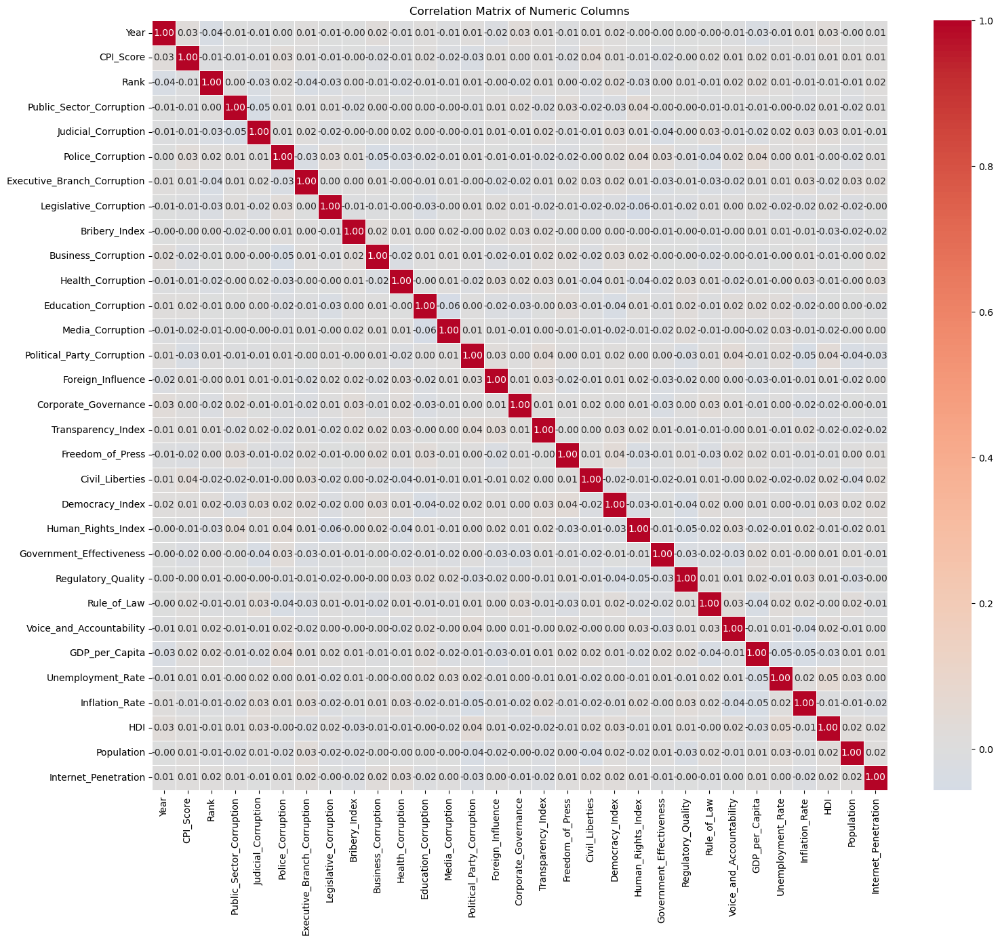

In [38]:
import seaborn as sns
import matplotlib.pyplot as plt

# Compute correlation matrix
numeric_data_cols = df.select_dtypes(include=["number"])
correlation_matrix = numeric_data_cols.corr()

# Plot heatmap
plt.figure(figsize=(16, 14))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5, center=0)
plt.title("Correlation Matrix of Numeric Columns")
plt.tight_layout()
plt.show()

# 1️⃣ Overview & General Insights


## CPI Score Distribution Over Time
How has global perception of corruption changed over time?




In [46]:
# Calculate mean CPI score per year
average_cpi = df.groupby('Year')['CPI_Score'].mean().reset_index()

# Rename columns for clarity
average_cpi.columns = ['Year', 'Average_CPI_Score']

# Display the resulting dataframe
average_cpi

,Year,Average_CPI_Score
0,2000,51.962121
1,2001,52.877863
2,2002,53.713235
3,2003,55.446154
4,2004,54.695652
5,2005,55.863248
6,2006,50.586207
7,2007,57.552239
8,2008,53.743363
9,2009,53.443478


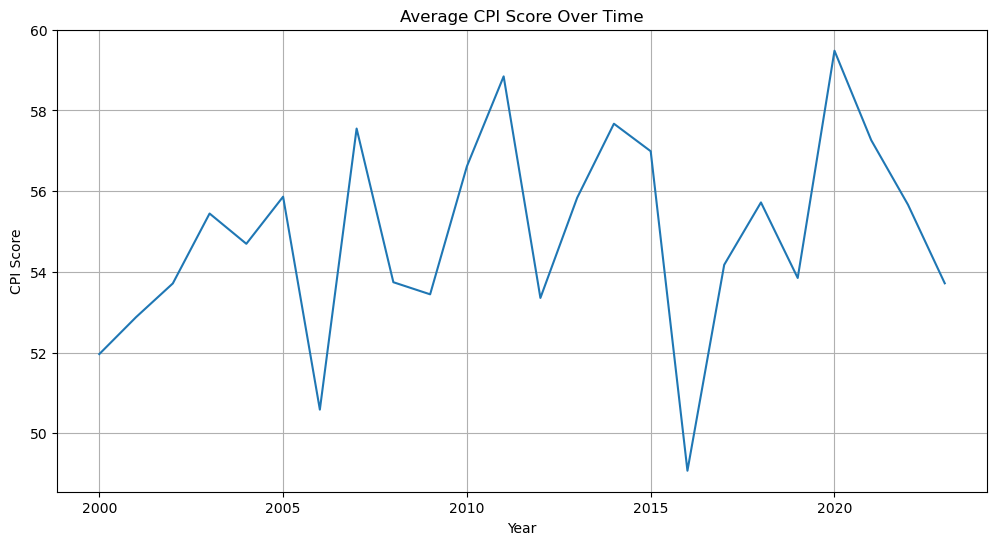

In [47]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.lineplot(data=df, x='Year', y='CPI_Score', estimator='mean', errorbar=None)
plt.title("Average CPI Score Over Time")
plt.xlabel("Year")
plt.ylabel("CPI Score")
plt.grid(True)
plt.show()

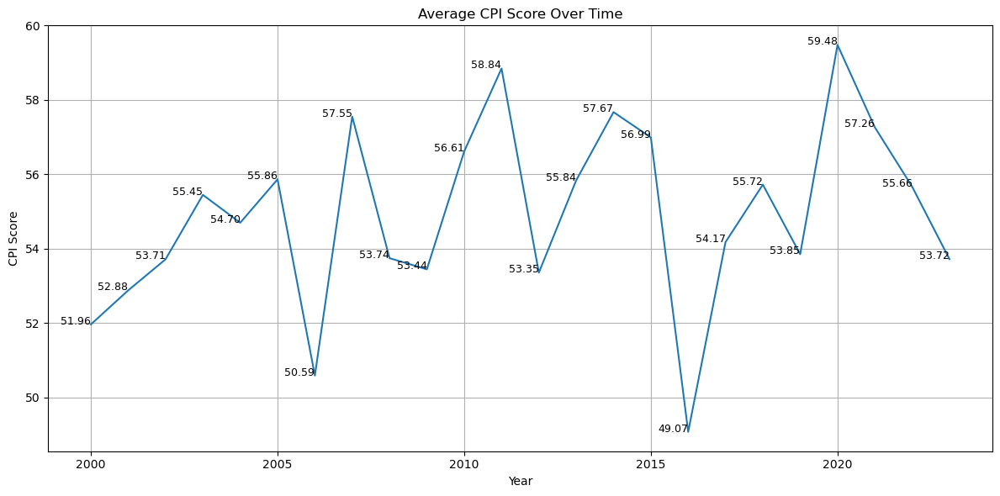

In [48]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create the plot
plt.figure(figsize=(12, 6))
line = sns.lineplot(data=df, x='Year', y='CPI_Score', estimator='mean', errorbar=None)

# Calculate the average values
average_cpi = df.groupby('Year')['CPI_Score'].mean().reset_index()

# Add value labels to each point
for x, y in zip(average_cpi['Year'], average_cpi['CPI_Score']):
    plt.text(x=x, y=y, s=f'{y:.2f}', fontsize=9, ha='right')

# Add titles and labels
plt.title("Average CPI Score Over Time")
plt.xlabel("Year")
plt.ylabel("CPI Score")
plt.grid(True)

# Show the plot
plt.tight_layout()
plt.show()

## Top 10 Least Corrupt Countries (Latest Year)
Which countries have the highest CPI score (least corrupt)?



In [50]:
latest_year = df['Year'].max()
top_cpi = df[df['Year'] == latest_year].sort_values(by='CPI_Score', ascending=False).head(10)
top_cpi[['Country', 'CPI_Score']]

,Country,CPI_Score
438,USA,97
366,Japan,95
2954,USA,95
828,China,94
851,USA,94
1470,USA,93
1674,Russia,93
203,France,92
187,Russia,92
1722,France,91


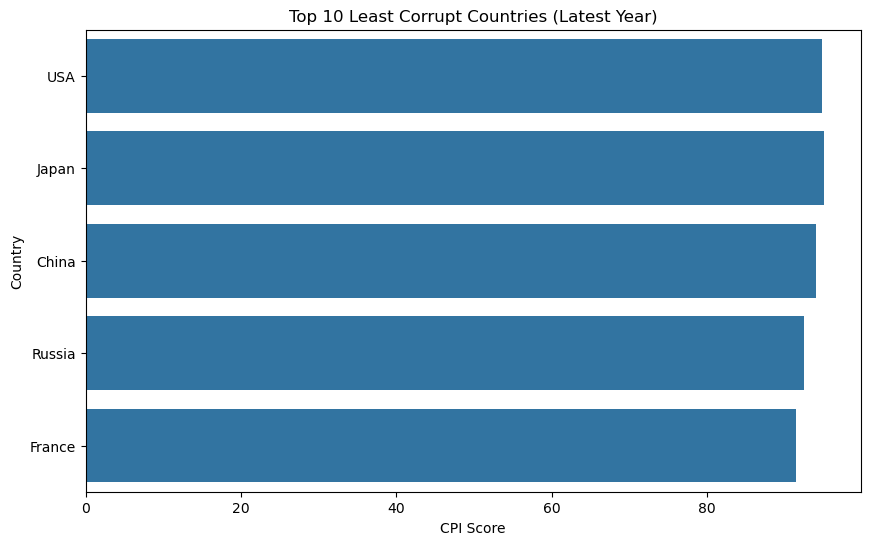

In [51]:
plt.figure(figsize=(10,6))
sns.barplot(data=top_cpi, x='CPI_Score', y='Country',errorbar=None)
plt.title("Top 10 Least Corrupt Countries (Latest Year)")
plt.xlabel("CPI Score")
plt.ylabel("Country")
plt.show()

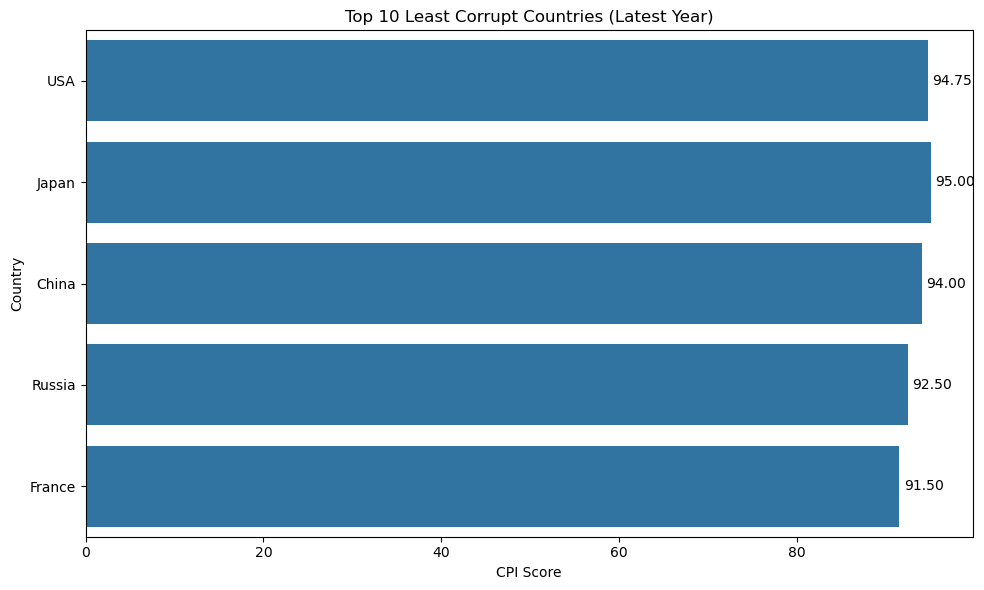

In [52]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
ax = sns.barplot(data=top_cpi, x='CPI_Score', y='Country', errorbar=None)

# Add value labels to the right of each bar
for i in ax.containers:
    ax.bar_label(i, fmt='%.2f', padding=3)  # Format to 2 decimal places

plt.title("Top 10 Least Corrupt Countries (Latest Year)")
plt.xlabel("CPI Score")
plt.ylabel("Country")
plt.tight_layout()
plt.show()

## Bottom 10 Most Corrupt Countries (Latest Year)
Which countries have the lowest CPI score (most corrupt)?




In [54]:
bottom_cpi = df[df['Year'] == latest_year].sort_values(by='CPI_Score').head(10)
bottom_cpi[['Country', 'CPI_Score']]

,Country,CPI_Score
97,UK,10
2656,Russia,10
1633,Russia,10
823,Brazil,10
548,USA,11
2432,Brazil,13
961,USA,14
1528,Brazil,14
1424,France,15
980,Russia,16


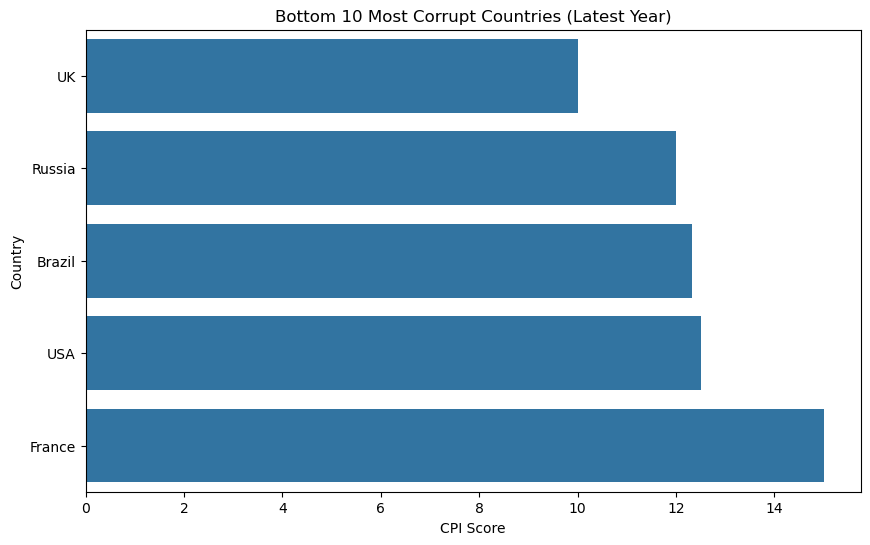

In [55]:
plt.figure(figsize=(10,6))
sns.barplot(data=bottom_cpi, x='CPI_Score', y='Country',errorbar=None)
plt.title("Bottom 10 Most Corrupt Countries (Latest Year)")
plt.xlabel("CPI Score")
plt.ylabel("Country")
plt.show()

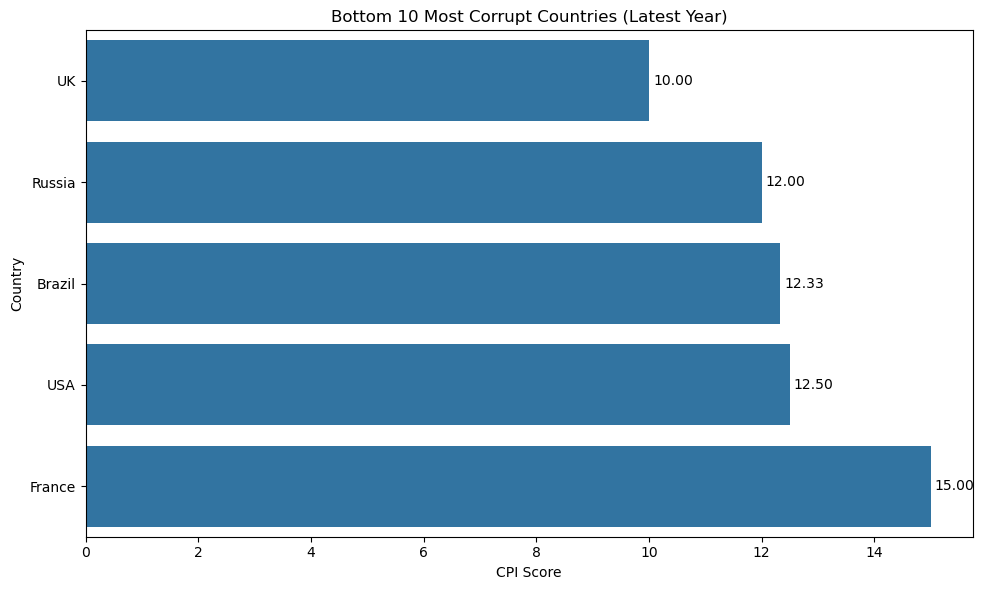

In [56]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
ax = sns.barplot(data=bottom_cpi, x='CPI_Score', y='Country', errorbar=None)

# Add value labels to the right of each bar
for container in ax.containers:
    ax.bar_label(container, fmt='%.2f', padding=3)

plt.title("Bottom 10 Most Corrupt Countries (Latest Year)")
plt.xlabel("CPI Score")
plt.ylabel("Country")
plt.tight_layout()
plt.show()

# 2️⃣ Regional & Temporal Corruption Trends


# 🧩 Which regions show distinct corruption patterns across sectors?

In [70]:
# Keep latest year per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

# Group by Region and compute average corruption per sector
region_corruption = df_latest.groupby('Region')[core_corruption_metrics].mean().reset_index()
region_corruption

,Region,CPI_Score,Rank,Public_Sector_Corruption,Judicial_Corruption,Police_Corruption,Executive_Branch_Corruption,Legislative_Corruption,Bribery_Index,Business_Corruption,Health_Corruption,Education_Corruption,Media_Corruption,Political_Party_Corruption,Foreign_Influence
0,Africa,58.0,53.333333,4.529748,3.974703,3.579627,3.560715,4.611592,4.241576,2.515296,4.526532,5.017129,5.389737,8.050750,7.122804
1,Americas,47.0,130.500000,4.543765,9.636996,4.916310,5.897503,3.716809,6.300470,9.034071,7.390042,4.542476,7.295786,4.849090,4.398890
2,Asia,26.0,104.500000,5.923023,4.340726,8.574627,6.527686,8.133282,3.554248,6.017883,6.150490,4.216073,9.484507,9.411182,4.497858
3,Europe,72.0,105.000000,8.299575,6.707102,1.028144,8.438590,4.562331,3.487816,6.913431,4.149588,5.512500,9.039014,3.030752,1.447489
4,Oceania,76.5,42.500000,2.399915,3.203155,5.424033,3.009844,3.283979,3.858735,5.349417,5.622562,7.802453,6.400612,3.211980,2.915658


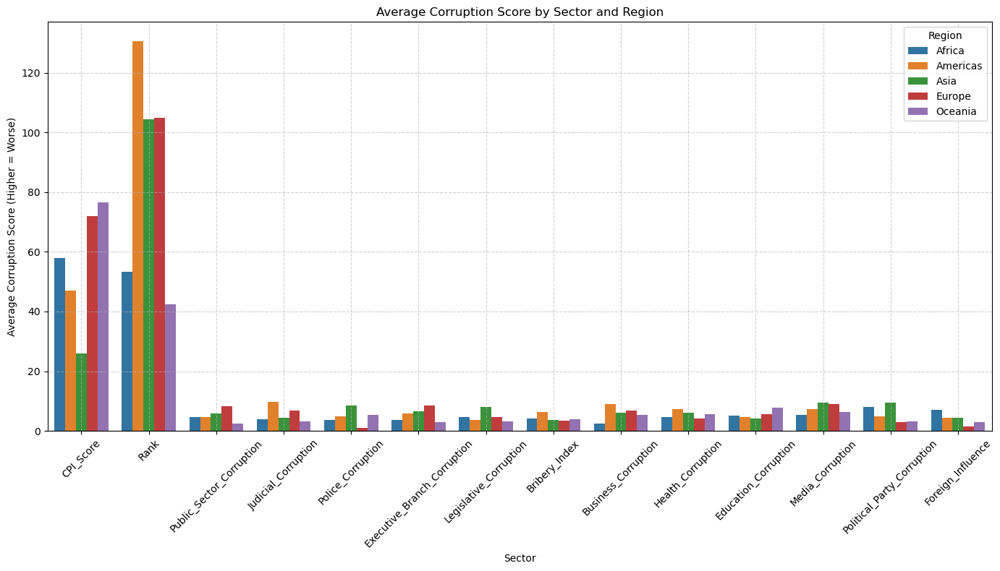

In [72]:
# Keep latest year per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

# Group by Region and compute average corruption per sector
region_corruption = df_latest.groupby('Region')[core_corruption_metrics].mean().reset_index()

# Melt for easier plotting
region_corruption_melted = region_corruption.melt(id_vars='Region', var_name='Sector', value_name='Avg Corruption Score')

# Plotting
plt.figure(figsize=(14, 8))
sns.barplot(data=region_corruption_melted, x='Sector', y='Avg Corruption Score', hue='Region')
plt.xticks(rotation=45)
plt.title("Average Corruption Score by Sector and Region")
plt.ylabel("Average Corruption Score (Higher = Worse)")
plt.xlabel("Sector")
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(title="Region")
plt.tight_layout()
plt.show()

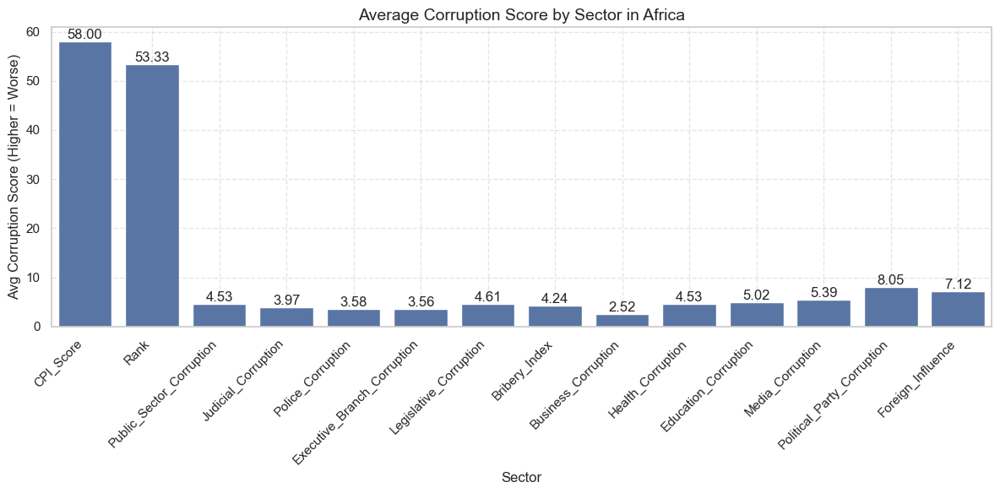

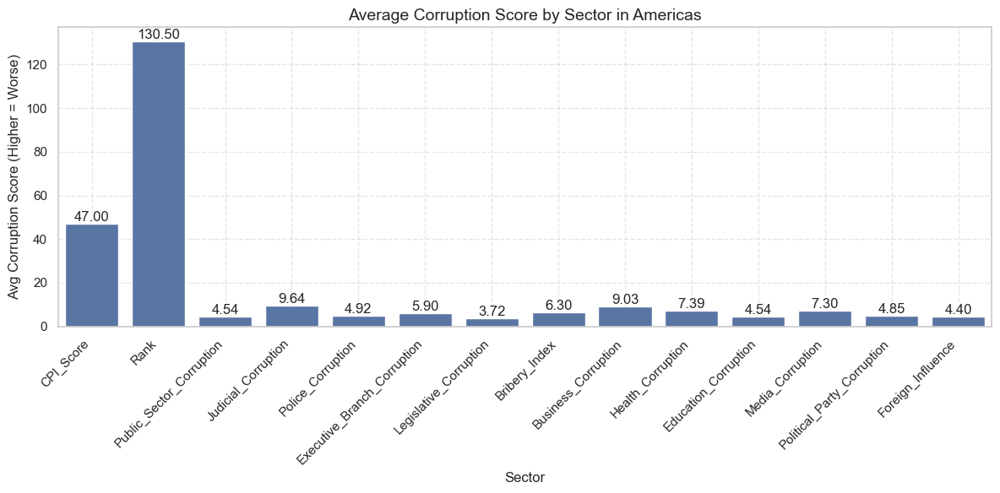

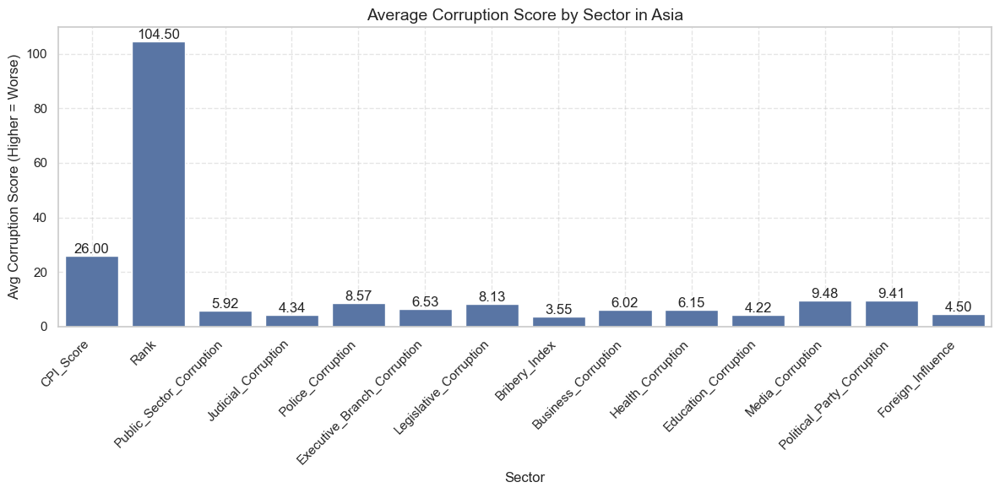

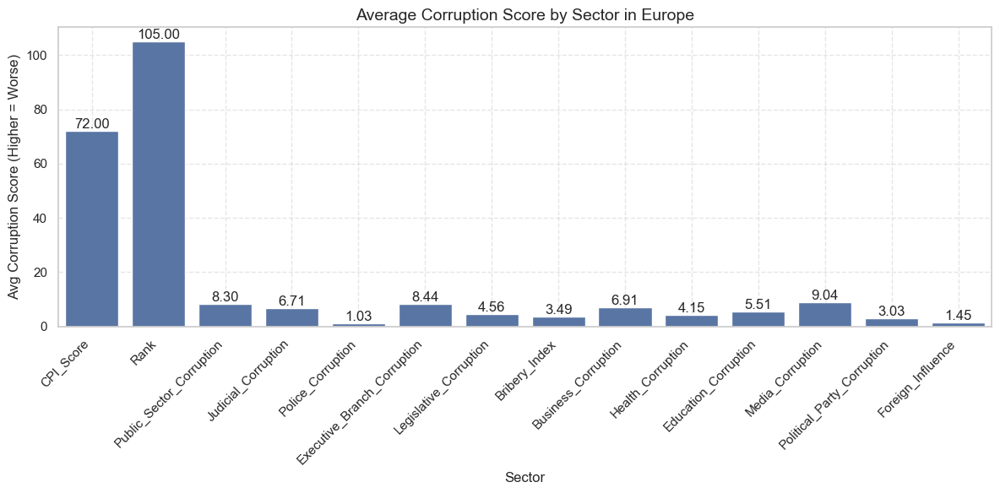

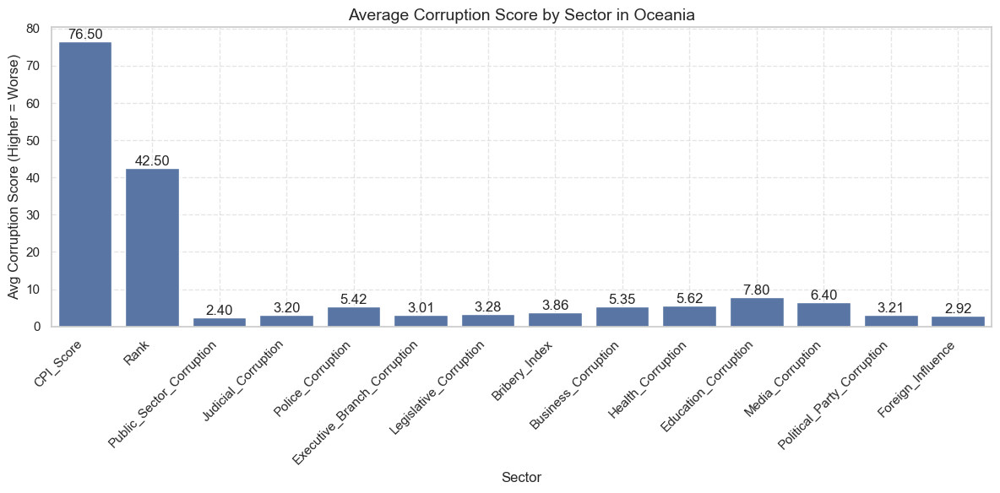

In [74]:
import seaborn as sns
import matplotlib.pyplot as plt

# Get unique regions
regions = region_corruption_melted['Region'].unique()

# Set general style
sns.set_theme(style="whitegrid")

# Loop through each region and plot
for region in regions:
    subset = region_corruption_melted[region_corruption_melted['Region'] == region]
    
    plt.figure(figsize=(12, 6))
    ax = sns.barplot(data=subset, x='Sector', y='Avg Corruption Score')
    
    # Add value labels on top of bars
    for container in ax.containers:
        ax.bar_label(container, fmt='%.2f')

    plt.xticks(rotation=45, ha='right')
    plt.title(f"Average Corruption Score by Sector in {region}", fontsize=14)
    plt.ylabel("Avg Corruption Score (Higher = Worse)")
    plt.xlabel("Sector")
    plt.tight_layout()
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.show()

## Regional Average CPI Trend Over Time
How do different regions compare in terms of corruption perception over time?



In [80]:
regional_trend = df.groupby(['Region', 'Year'])['CPI_Score'].mean().reset_index()
regional_trend

,Region,Year,CPI_Score
0,Africa,2000,53.227273
1,Africa,2001,48.217391
2,Africa,2002,48.312500
3,Africa,2003,56.617647
4,Africa,2004,58.090909
...,...,...,...
115,Oceania,2019,55.680000
116,Oceania,2020,61.076923
117,Oceania,2021,56.720000
118,Oceania,2022,58.115385


In [81]:
import pandas as pd



# Assume we're using data from the latest year available for each country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

# One-Hot Encode Region
df_encoded = pd.get_dummies(df_latest, columns=['Region'])

# Get all region dummy columns
region_columns = [col for col in df_encoded.columns if col.startswith('Region_')]

# Define compute_correlation function
def compute_correlation(df, columns, target='CPI_Score'):
    correlations = df[[target] + columns].corr()[target]
    return correlations.abs().sort_values(ascending=False)

# Compute CPI vs Region correlations
correlations_region = compute_correlation(df_encoded, region_columns)

# Print results
print("Regional & Temporal Trends - Correlation with CPI:")
print(correlations_region)

Regional & Temporal Trends - Correlation with CPI:
CPI_Score          1.000000
Region_Asia        0.551659
Region_Oceania     0.425842
Region_Europe      0.225825
Region_Americas    0.145173
Region_Africa      0.088702
Name: CPI_Score, dtype: float64


Regional & Temporal Trends - Correlation with CPI:
CPI_Score          1.000000
Region_Asia        0.551659
Region_Oceania     0.425842
Region_Europe      0.225825
Region_Americas    0.145173
Region_Africa      0.088702
Name: CPI_Score, dtype: float64


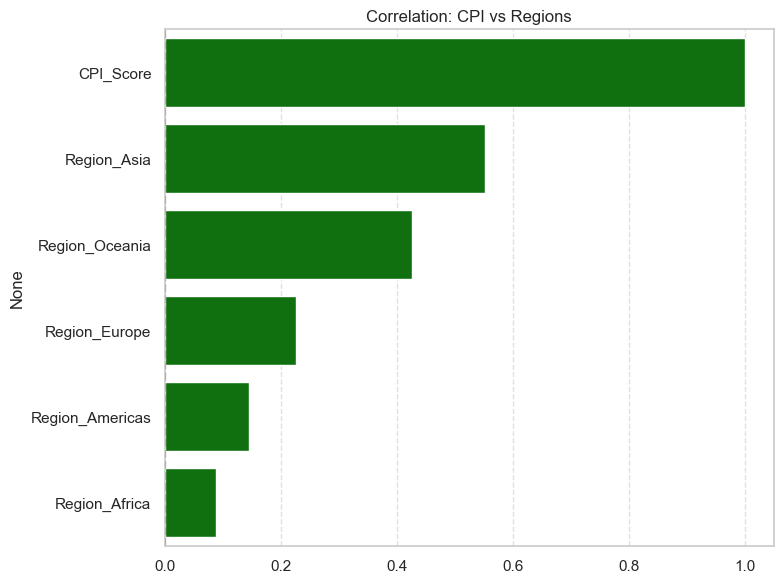

In [82]:
# Encode Region as dummy variables
df_encoded = pd.get_dummies(df_latest, columns=['Region'])
region_columns = [col for col in df_encoded.columns if col.startswith('Region_')]
correlations_region = compute_correlation(df_encoded, region_columns)
print("Regional & Temporal Trends - Correlation with CPI:")
print(correlations_region)

plot_correlation(correlations_region, "Correlation: CPI vs Regions")

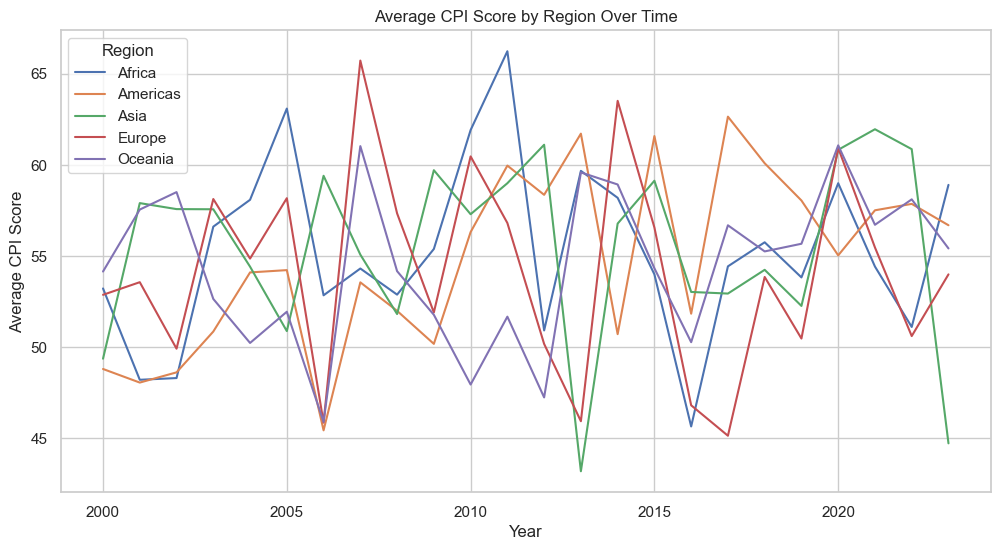

In [84]:
regional_trend = df.groupby(['Region', 'Year'])['CPI_Score'].mean().reset_index()
plt.figure(figsize=(12,6))
sns.lineplot(data=regional_trend, x='Year', y='CPI_Score', hue='Region')
plt.title("Average CPI Score by Region Over Time")
plt.xlabel("Year")
plt.ylabel("Average CPI Score")
plt.legend(title="Region")
plt.grid(True)
plt.show()

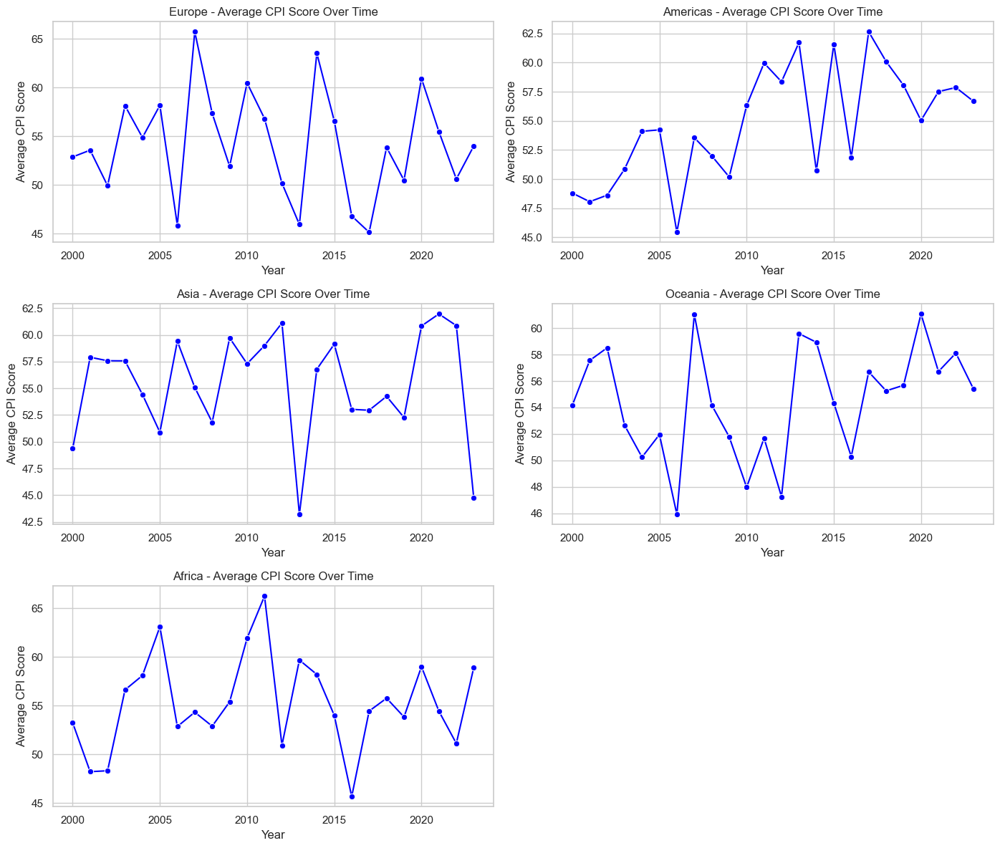

In [85]:
# Compute average CPI by Region and Year
regional_trend = df.groupby(['Region', 'Year'])['CPI_Score'].mean().reset_index()

# Define regions of interest
regions = ['Europe', 'Americas', 'Asia', 'Oceania', 'Africa']

# Set up the figure with subplots
fig, axes = plt.subplots(3, 2, figsize=(14, 12))  # 3 rows, 2 columns
axes = axes.flatten()  # Flatten to iterate easily

# Loop through each region and plot in separate subplot
for i, region in enumerate(regions):
    region_data = regional_trend[regional_trend['Region'] == region]
    ax = axes[i]
    
    sns.lineplot(data=region_data, x='Year', y='CPI_Score', ax=ax, marker='o', color='blue')
    
    ax.set_title(f"{region} - Average CPI Score Over Time")
    ax.set_ylabel("Average CPI Score")
    ax.set_xlabel("Year")
    ax.grid(True)

# Hide any unused subplots (if less than 6 regions)
for j in range(len(regions), len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.show()

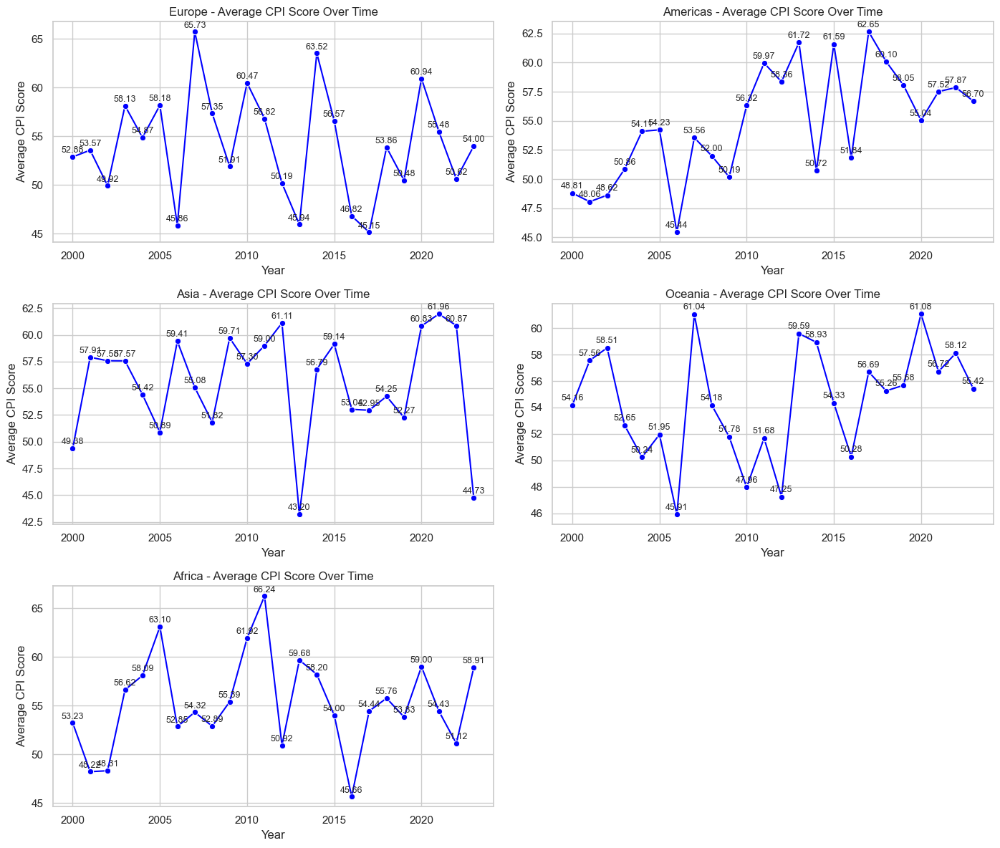

In [86]:
# Compute average CPI by Region and Year
regional_trend = df.groupby(['Region', 'Year'])['CPI_Score'].mean().reset_index()

# Define regions of interest
regions = ['Europe', 'Americas', 'Asia', 'Oceania', 'Africa']

# Set up the figure with subplots
fig, axes = plt.subplots(3, 2, figsize=(14, 12))  # 3 rows, 2 columns
axes = axes.flatten()  # Flatten to iterate easily

# Loop through each region and plot in separate subplot
for i, region in enumerate(regions):
    region_data = regional_trend[regional_trend['Region'] == region]
    ax = axes[i]
    
    # Plot the line
    sns.lineplot(data=region_data, x='Year', y='CPI_Score', ax=ax, marker='o', color='blue')
    
    # Annotate each point with CPI value
    for _, row in region_data.iterrows():
        ax.text(row['Year'], row['CPI_Score'] + 0.2, f"{row['CPI_Score']:.2f}", 
                ha='center', va='bottom', fontsize=9)

    ax.set_title(f"{region} - Average CPI Score Over Time")
    ax.set_ylabel("Average CPI Score")
    ax.set_xlabel("Year")
    ax.grid(True)

# Hide any unused subplots (if less than 6 regions)
for j in range(len(regions), len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.show()

## Top 3 Regions by CPI Score (Latest Year)


In [96]:
latest_region = df[df['Year'] == latest_year].groupby('Region')['CPI_Score'].mean().sort_values(ascending=False).head(3)
latest_region

Region
Africa      58.909091
Americas    56.695652
Oceania     55.423077
Name: CPI_Score, dtype: float64

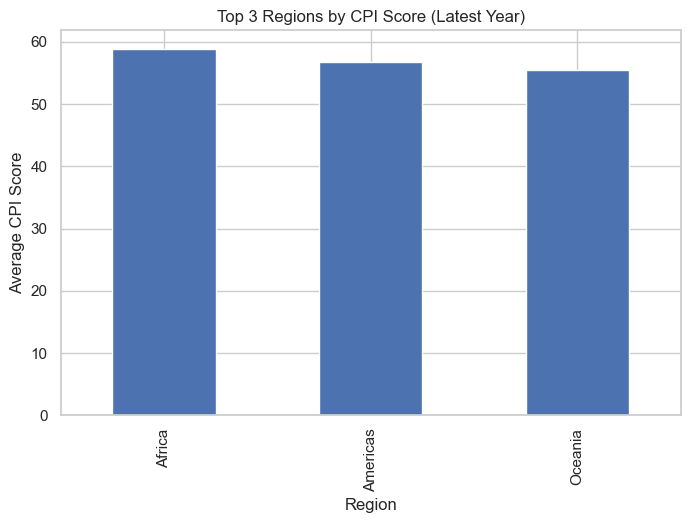

In [97]:
latest_region.plot(kind='bar', figsize=(8,5), title="Top 3 Regions by CPI Score (Latest Year)")
plt.xlabel("Region")
plt.ylabel("Average CPI Score")
plt.show()

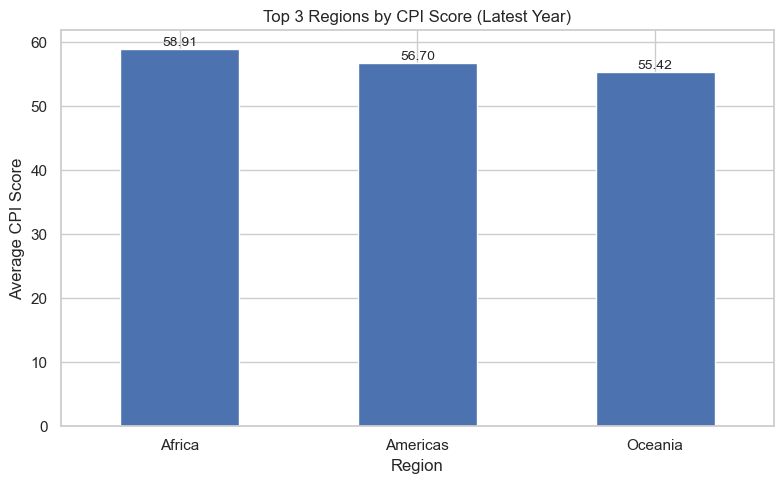

In [98]:
# Assuming latest_region is a Series or DataFrame with top 3 regions and their CPI scores
ax = latest_region.plot(kind='bar', figsize=(8, 5), title="Top 3 Regions by CPI Score (Latest Year)")
plt.xlabel("Region")
plt.ylabel("Average CPI Score")
plt.xticks(rotation=0)  # Keep region names horizontal for readability

# Add value labels on top of bars
for p in ax.patches:
    ax.annotate(f"{p.get_height():.2f}", 
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()

## Bottom 3 Regions by CPI Score (Latest Year)
Which regions scored worst in CPI in the latest year?



In [107]:
latest_region_bottom = df[df['Year'] == latest_year].groupby('Region')['CPI_Score'].mean().sort_values().head(3)
latest_region_bottom

Region
Asia       44.730769
Europe     54.000000
Oceania    55.423077
Name: CPI_Score, dtype: float64

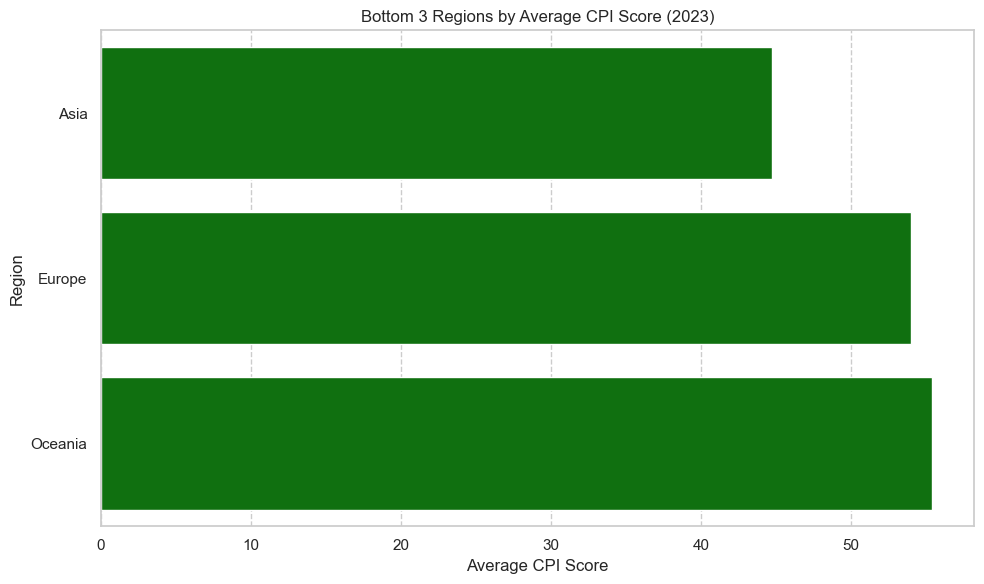

In [109]:
# Get latest year
latest_year = df['Year'].max()

# Group by Region and get average CPI Score for latest year
region_cpi = df[df['Year'] == latest_year].groupby('Region')['CPI_Score'].mean().sort_values()

# Get bottom 3 regions
latest_region_bottom = region_cpi.head(3)

# Plotting
plt.figure(figsize=(10, 6))
sns.barplot(x=latest_region_bottom.values, y=latest_region_bottom.index, color="green")
plt.title(f"Bottom 3 Regions by Average CPI Score ({latest_year})")
plt.xlabel("Average CPI Score")
plt.ylabel("Region")
plt.grid(True, linestyle='--', axis='x')
plt.tight_layout()
plt.show()

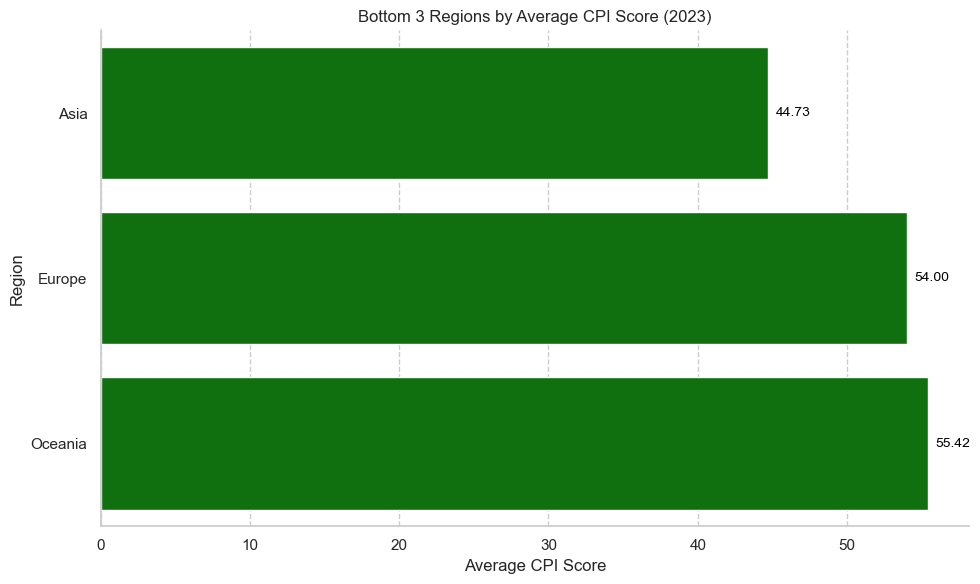

In [110]:
# Get latest year
latest_year = df['Year'].max()

# Group by Region and get average CPI Score for latest year
region_cpi = df[df['Year'] == latest_year].groupby('Region')['CPI_Score'].mean().sort_values()

# Get bottom 3 regions
latest_region_bottom = region_cpi.head(3)

# Plotting
plt.figure(figsize=(10, 6))
ax = sns.barplot(x=latest_region_bottom.values, y=latest_region_bottom.index, color="green")

# Add value labels to the right of the bars
for i, v in enumerate(latest_region_bottom.values):
    ax.text(v + 0.5, i, f"{v:.2f}", color='black', va='center', fontsize=10)

# Titles and labels
plt.title(f"Bottom 3 Regions by Average CPI Score ({latest_year})")
plt.xlabel("Average CPI Score")
plt.ylabel("Region")
plt.grid(True, linestyle='--', axis='x')

# Remove spines (borders)
sns.despine()

plt.tight_layout()
plt.show()

# 3️⃣ Country-Wise Corruption Trends


# 🧩 Which Countries show distinct corruption patterns across sectors?

In [116]:
# Keep latest year per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

# Group by Region and compute average corruption per sector
region_corruption = df_latest.groupby('Country')[core_corruption_metrics].mean().reset_index()
region_corruption

,Country,CPI_Score,Rank,Public_Sector_Corruption,Judicial_Corruption,Police_Corruption,Executive_Branch_Corruption,Legislative_Corruption,Bribery_Index,Business_Corruption,Health_Corruption,Education_Corruption,Media_Corruption,Political_Party_Corruption,Foreign_Influence
0,Brazil,89.0,1.0,2.239384,3.741711,4.666063,3.668717,0.795172,2.064602,8.597251,2.833630,6.337318,4.843136,1.887540,2.551858
1,China,48.0,53.0,4.520286,6.537201,6.018069,2.889536,9.820755,6.993107,2.516016,8.433558,7.713304,9.256683,9.235309,7.784061
2,France,25.0,84.0,1.473644,9.499248,4.359693,2.782346,6.391553,4.306716,9.366809,4.967517,6.245428,8.669327,9.327066,2.818682
3,Germany,69.0,177.0,7.613887,9.774743,5.472928,9.012660,1.042064,8.294224,8.701333,9.812568,2.839524,5.922245,0.371114,5.979097
4,India,34.0,100.0,0.384334,0.462799,1.365669,3.095090,0.081627,2.750870,4.206384,1.223395,1.112719,1.571780,7.001642,9.622750
5,Japan,72.0,105.0,8.299575,6.707102,1.028144,8.438590,4.562331,3.487816,6.913431,4.149588,5.512500,9.039014,3.030752,1.447489
6,Russia,92.0,7.0,8.684626,4.924108,3.355143,4.697519,3.932394,2.980750,0.823486,3.922643,6.225364,5.340748,7.915298,3.961600
7,South Africa,64.0,84.0,2.560445,2.664598,6.182003,2.350971,5.772787,5.652869,2.101582,8.411495,9.267588,7.958088,4.536419,3.279458
8,UK,10.0,139.0,6.127221,7.038527,9.870231,8.614986,7.414909,3.384189,3.912036,7.455520,3.962090,9.228196,9.702934,2.172174
9,USA,42.0,70.0,5.718826,1.642926,7.279024,4.440387,8.851655,3.724307,8.123731,4.845459,4.470056,9.740817,9.119430,6.823542


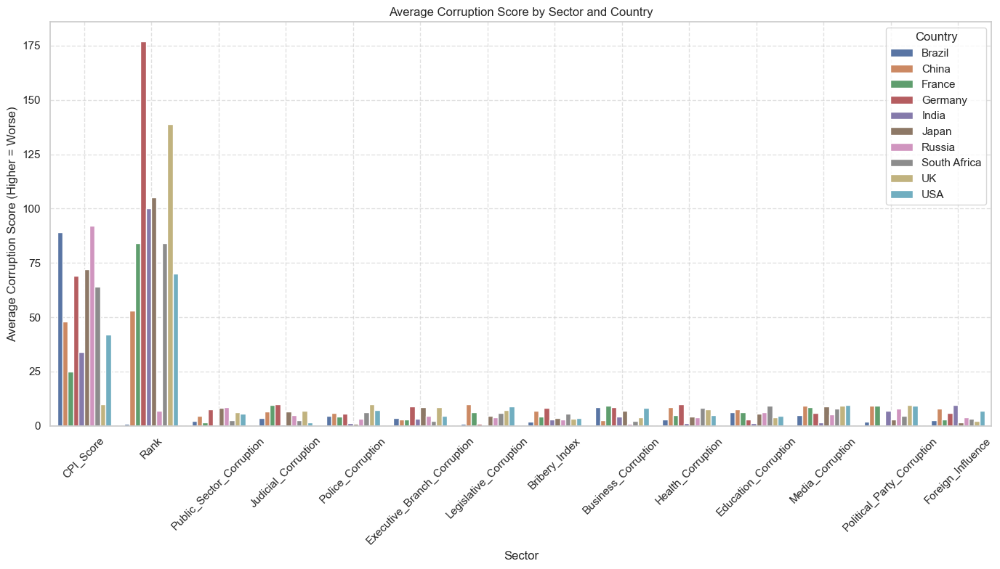

In [117]:
# Keep latest year per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

# Group by Region and compute average corruption per sector
region_corruption = df_latest.groupby('Country')[core_corruption_metrics].mean().reset_index()

# Melt for easier plotting
region_corruption_melted = region_corruption.melt(id_vars='Country', var_name='Sector', value_name='Avg Corruption Score')

# Plotting
plt.figure(figsize=(14, 8))
sns.barplot(data=region_corruption_melted, x='Sector', y='Avg Corruption Score', hue='Country')
plt.xticks(rotation=45)
plt.title("Average Corruption Score by Sector and Country")
plt.ylabel("Average Corruption Score (Higher = Worse)")
plt.xlabel("Sector")
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(title="Country")
plt.tight_layout()
plt.show()

C:\Users\hp\AppData\Local\Temp\ipykernel_17108\404232324.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(data=data, x='Sector', y='Avg Corruption Score', palette='viridis')


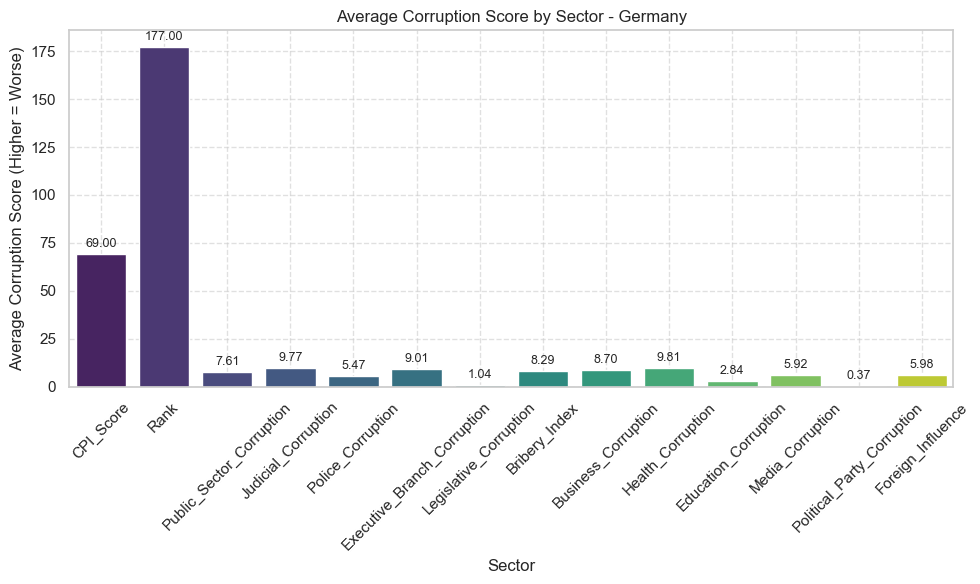

C:\Users\hp\AppData\Local\Temp\ipykernel_17108\404232324.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(data=data, x='Sector', y='Avg Corruption Score', palette='viridis')


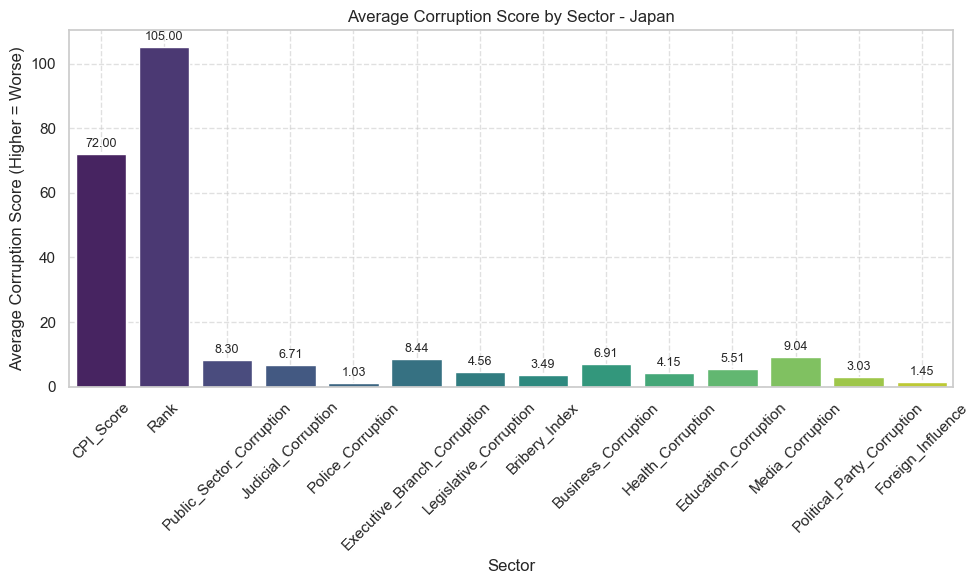

C:\Users\hp\AppData\Local\Temp\ipykernel_17108\404232324.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(data=data, x='Sector', y='Avg Corruption Score', palette='viridis')


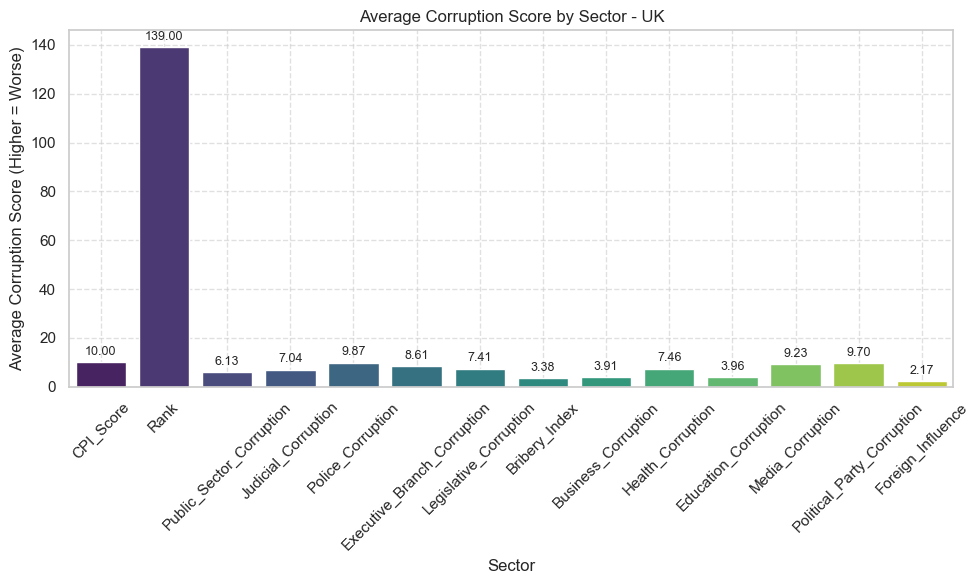

C:\Users\hp\AppData\Local\Temp\ipykernel_17108\404232324.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(data=data, x='Sector', y='Avg Corruption Score', palette='viridis')


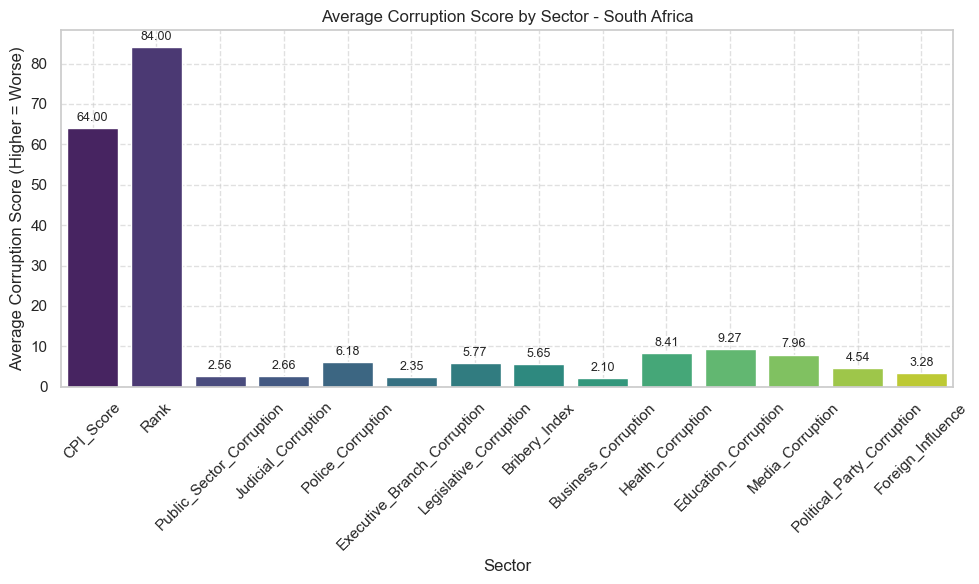

C:\Users\hp\AppData\Local\Temp\ipykernel_17108\404232324.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(data=data, x='Sector', y='Avg Corruption Score', palette='viridis')


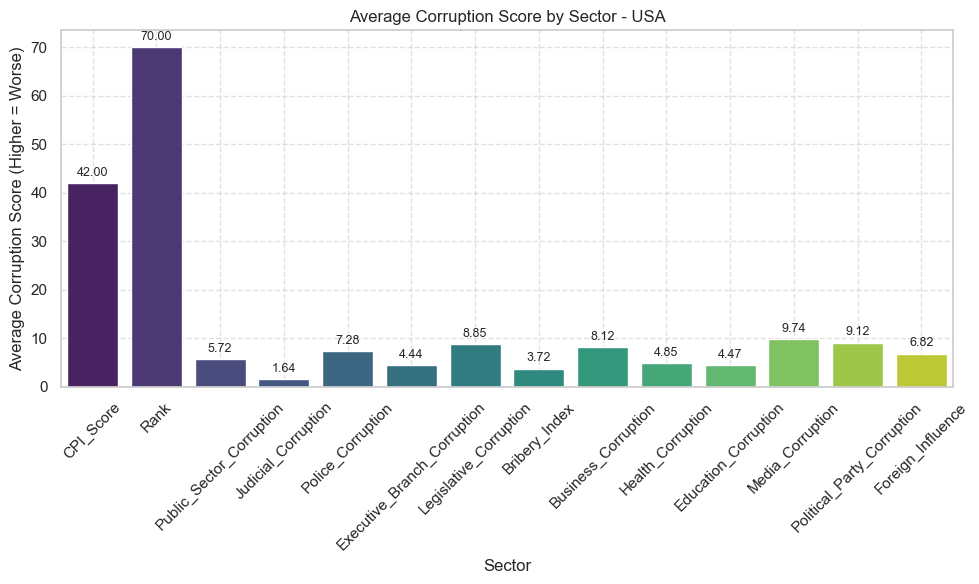

In [118]:
# Keep latest year per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

# Compute average corruption per sector
region_corruption = df_latest.groupby('Country')[core_corruption_metrics].mean().reset_index()

# Calculate overall average corruption per country (across all sectors)
region_corruption['Overall_Avg'] = region_corruption[core_corruption_metrics].mean(axis=1)

# Select top 5 countries by overall average corruption score
top_countries = region_corruption.nlargest(5, 'Overall_Avg')['Country']

# Filter for top 5 countries
region_corruption_top5 = region_corruption[region_corruption['Country'].isin(top_countries)]

# Melt for easier plotting
region_corruption_melted = region_corruption_top5.melt(id_vars='Country', value_vars=core_corruption_metrics, 
                                                       var_name='Sector', value_name='Avg Corruption Score')

# Plot one graph per country
for country in top_countries:
    plt.figure(figsize=(10, 6))
    data = region_corruption_melted[region_corruption_melted['Country'] == country]
    
    ax = sns.barplot(data=data, x='Sector', y='Avg Corruption Score', palette='viridis')
    plt.title(f"Average Corruption Score by Sector - {country}")
    plt.xticks(rotation=45)
    plt.ylabel("Average Corruption Score (Higher = Worse)")
    plt.xlabel("Sector")
    plt.grid(True, linestyle='--', alpha=0.6)
    
    # Add data labels
    for container in ax.containers:
        ax.bar_label(container, fmt='%.2f', padding=3, fontsize=9)
    
    plt.tight_layout()
    plt.show()


## Top 5 Countries with Improving CPI Scores
Which countries improved the most in CPI over time?



In [126]:
duplicates = df[df.duplicated(subset=['Country', 'Year'], keep=False)]
duplicates[['Country', 'Year']].value_counts()

Country       Year
China         2011    25
Russia        2014    23
Japan         2004    21
South Africa  2016    21
France        2012    21
                      ..
              2010     5
Brazil        2006     5
China         2020     5
USA           2022     5
South Africa  2019     4
Name: count, Length: 240, dtype: int64

In [128]:
df_clean = df.groupby(['Country', 'Year'], as_index=False)['CPI_Score'].max()
df_clean

,Country,Year,CPI_Score
0,Brazil,2000,90
1,Brazil,2001,92
2,Brazil,2002,95
3,Brazil,2003,80
4,Brazil,2004,95
...,...,...,...
235,USA,2019,88
236,USA,2020,98
237,USA,2021,97
238,USA,2022,69


In [130]:
# Pivot the cleaned data
country_scores = df_clean.pivot(index='Country', columns='Year', values='CPI_Score').interpolate(method='linear')

# Compute improvement
country_scores['Improvement'] = country_scores.max(axis=1) - country_scores.min(axis=1)

# Get top improvers
top_improvers = country_scores.sort_values(by='Improvement', ascending=False).head(5)
top_improvers

Year,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,...,2015,2016,2017,2018,2019,2020,2021,2022,2023,Improvement
Country,,,,,,,,,,,,,,,,,,,,,
USA,96,86,99,90,98,96,99,99,97,88,...,97,99,98,84,88,98,97,69,97,30
Japan,92,95,99,99,98,91,71,94,96,97,...,85,85,96,89,93,96,95,98,95,28
South Africa,92,96,91,97,96,98,79,86,71,97,...,92,99,88,97,83,97,98,86,88,28
Germany,84,97,96,98,90,99,88,82,95,93,...,94,97,94,96,87,94,93,72,80,27
India,92,99,96,99,95,94,85,97,73,87,...,96,95,91,99,99,98,98,96,80,26


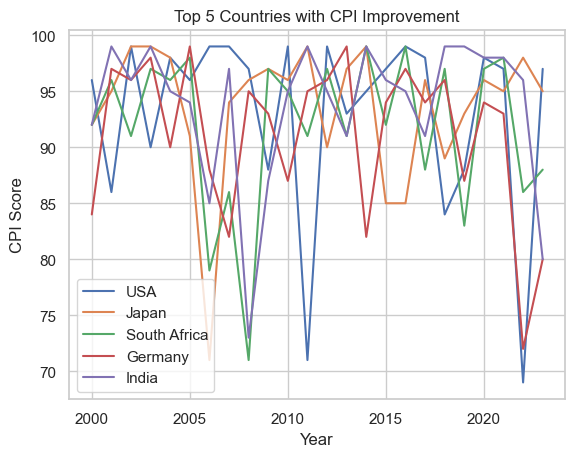

In [131]:
for country in top_improvers.index:
    plt.plot(country_scores.columns[:-1], country_scores.loc[country][:-1], label=country)

plt.title("Top 5 Countries with CPI Improvement")
plt.xlabel("Year")
plt.ylabel("CPI Score")
plt.legend()
plt.grid(True)
plt.show()

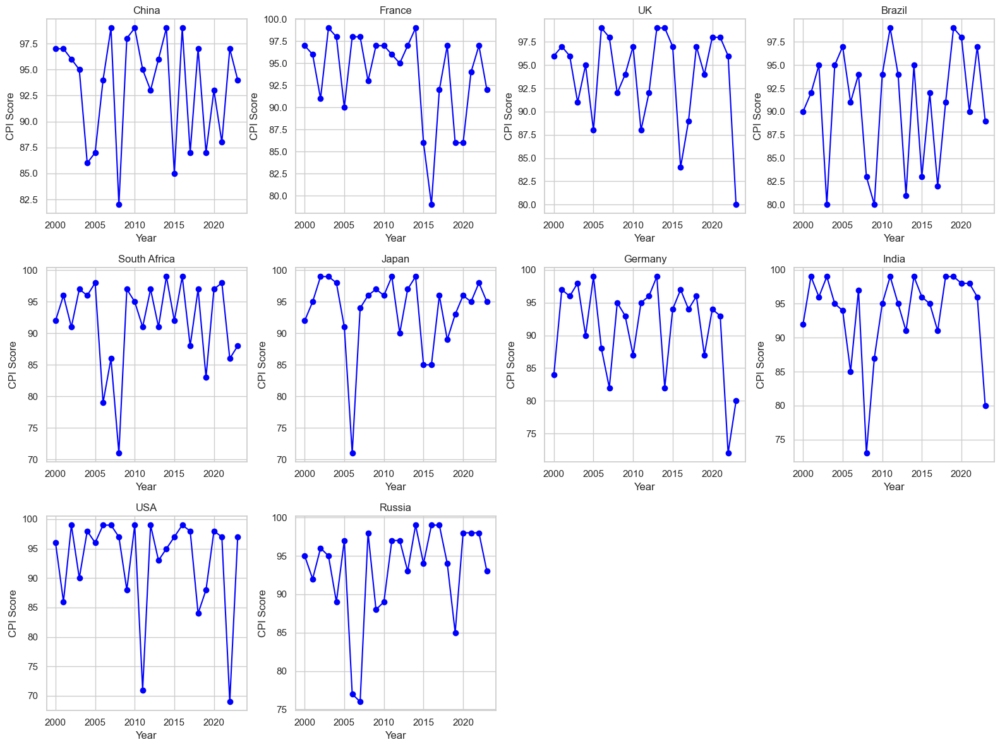

In [135]:
# List of top improvers (from your list)
top_countries = ['China', 'France', 'UK', 'Brazil', 'South Africa', 'Japan', 'Germany', 'India', 'USA', 'Russia']

# Set up the figure with subplots
fig, axes = plt.subplots(3, 4, figsize=(16, 12))  # 3 rows, 4 columns
axes = axes.flatten()  # Flatten to iterate easily

# Loop through each country and plot in separate subplot
for i, country in enumerate(top_countries):
    ax = axes[i]
    
    # Plot the CPI trend for the current country
    years = country_scores.columns[:-1]  # All columns except last one ('Improvement')
    cpi_scores = country_scores.loc[country][:-1]
    
    ax.plot(years, cpi_scores, marker='o', color='blue')
    ax.set_title(country)
    ax.set_xlabel("Year")
    ax.set_ylabel("CPI Score")
    ax.grid(True)

# Hide any unused subplots
for j in range(len(top_countries), len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.show()

## Top 5 Countries with Declining CPI Scores
Which countries regressed the most in CPI over time?



In [142]:
country_scores['Decline'] = country_scores.min(axis=1) - country_scores.max(axis=1)
top_decliners = country_scores.sort_values(by='Decline').head(5)
top_decliners

Year,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,...,2016,2017,2018,2019,2020,2021,2022,2023,Improvement,Decline
Country,,,,,,,,,,,,,,,,,,,,,
China,97,97,96,95,86,87,94,99,82,98,...,99,87,97,87,93,88,97,94,17,-82
Brazil,90,92,95,80,95,97,91,94,83,80,...,92,82,91,99,98,90,97,89,19,-80
UK,96,97,96,91,95,88,99,98,92,94,...,84,89,97,94,98,98,96,80,19,-80
France,97,96,91,99,98,90,98,98,93,97,...,79,92,97,86,86,94,97,92,20,-79
Russia,95,92,96,95,89,97,77,76,98,88,...,99,99,94,85,98,98,98,93,23,-76


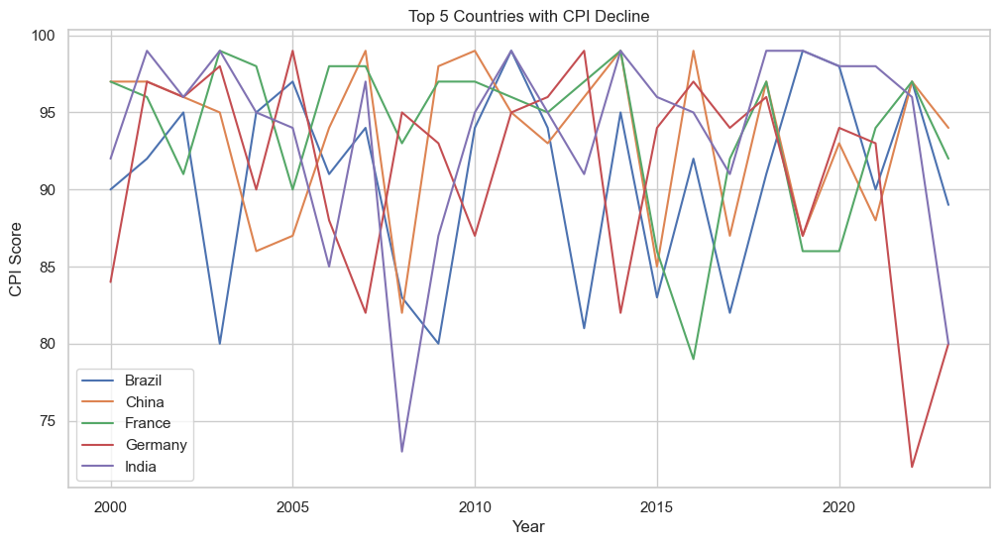

In [143]:
# Ensure we only use numeric columns (years), exclude 'Improvement'
year_columns = [col for col in country_scores.columns if isinstance(col, int) or str(col).isdigit()]

# Compute Decline
country_scores['Decline'] = country_scores[year_columns].max(axis=1) - country_scores[year_columns].max(axis=1)
top_decliners = country_scores.sort_values(by='Decline').head(5)

# Plot
plt.figure(figsize=(12, 6))
for country in top_decliners.index:
    plt.plot(year_columns, country_scores.loc[country][year_columns], label=country)

plt.title("Top 5 Countries with CPI Decline")
plt.xlabel("Year")
plt.ylabel("CPI Score")
plt.legend()
plt.grid(True)
plt.show()

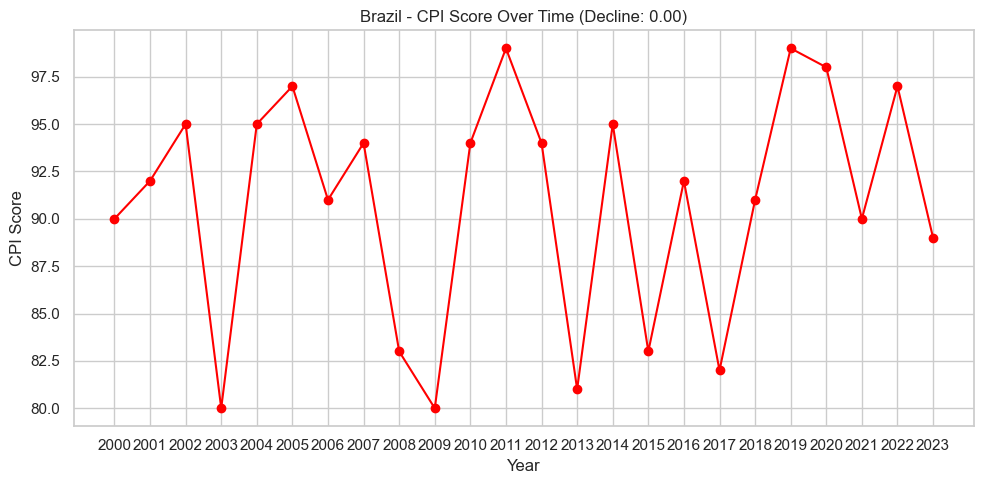

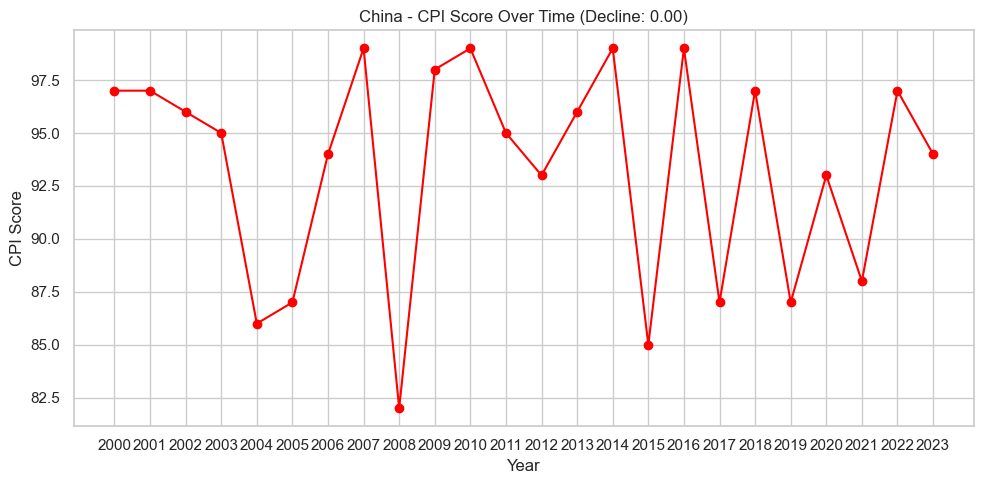

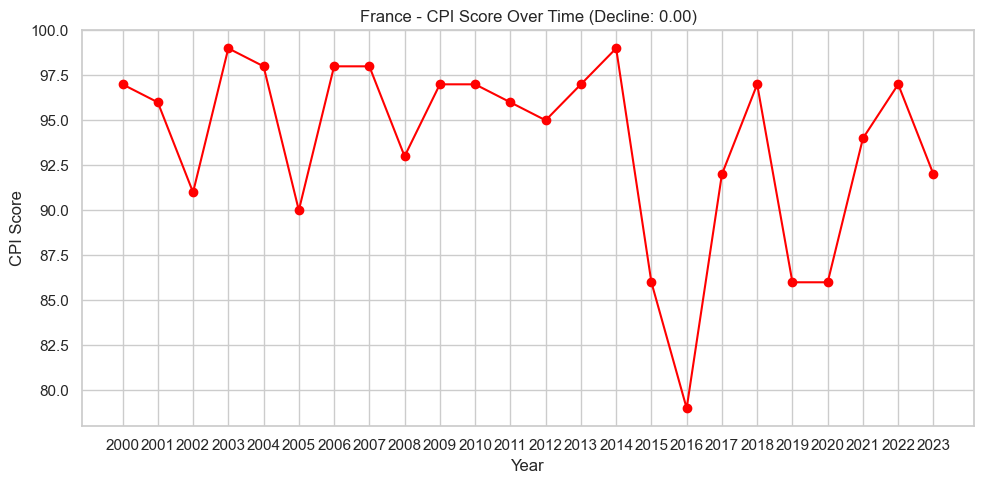

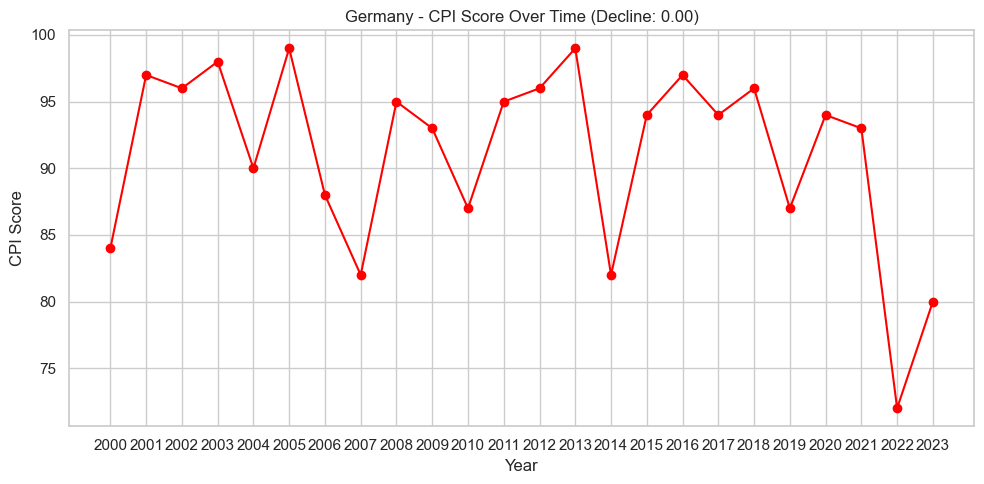

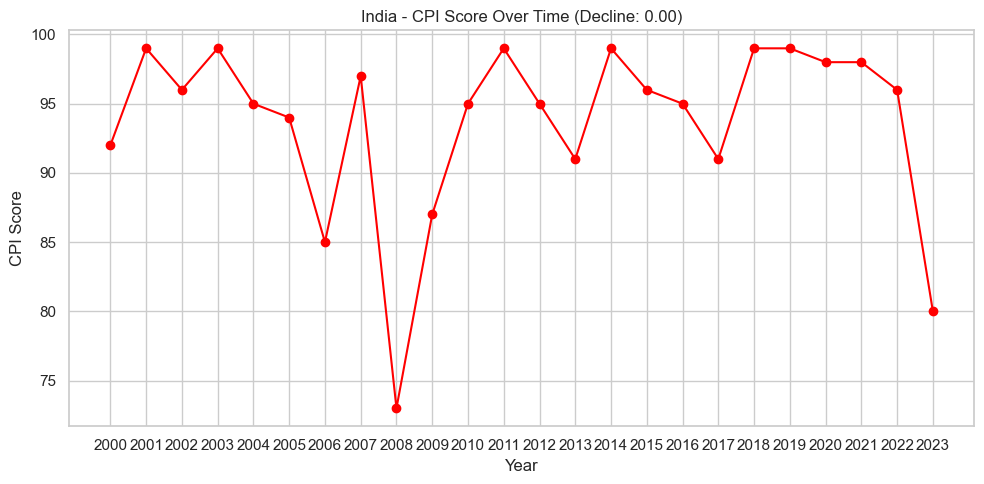

In [144]:
import matplotlib.pyplot as plt

# Loop through each top declining country and create a separate plot
for country in top_decliners.index:
    
    plt.figure(figsize=(10, 5))
    plt.plot(year_columns, country_scores.loc[country][year_columns], marker='o', color='red')
    plt.title(f"{country} - CPI Score Over Time (Decline: {top_decliners.loc[country]['Decline']:.2f})")
    plt.xlabel("Year")
    plt.ylabel("CPI Score")
    plt.grid(True)
    plt.xticks(year_columns)
    plt.tight_layout()
    plt.show()

# 4️⃣ Sector-Wise Corruption


## Average Corruption per Sector
Which sector is perceived as most corrupt on average?



In [511]:
sector_columns = ['Public_Sector_Corruption', 'Judicial_Corruption', 'Police_Corruption',
                  'Executive_Branch_Corruption', 'Legislative_Corruption']
avg_sector = df[sector_columns].mean()
avg_sector.sort_values(ascending=False)

Legislative_Corruption         5.074054
Public_Sector_Corruption       5.010192
Judicial_Corruption            4.993386
Executive_Branch_Corruption    4.980443
Police_Corruption              4.958386
dtype: float64

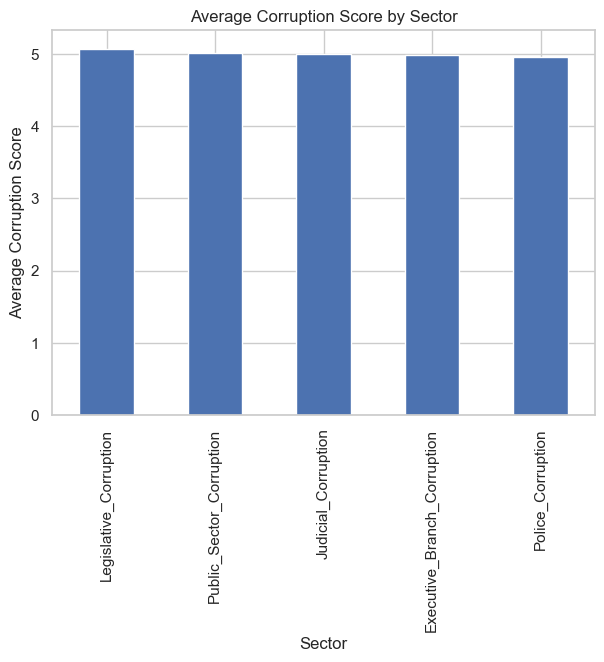

In [513]:
avg_sector.sort_values(ascending=False).plot(kind='bar', figsize=(7,5))
plt.title("Average Corruption Score by Sector")
plt.xlabel("Sector")
plt.ylabel("Average Corruption Score")
plt.show()

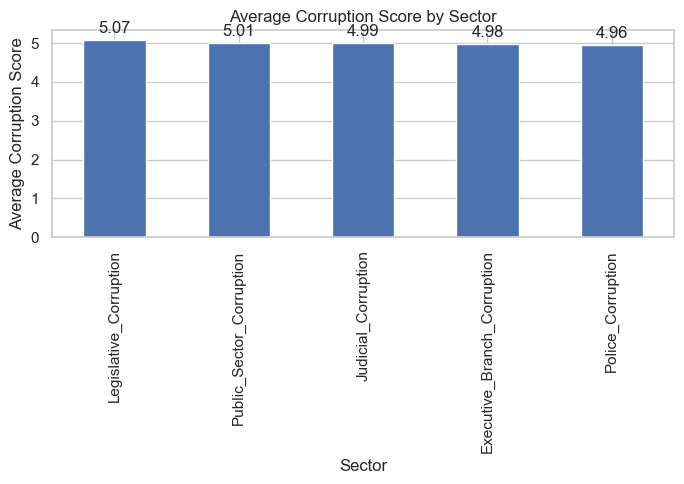

In [515]:
import matplotlib.pyplot as plt

# Assuming avg_sector is a pandas Series
ax = avg_sector.sort_values(ascending=False).plot(kind='bar', figsize=(7, 5))

# Add value labels
for container in ax.containers:
    ax.bar_label(container, fmt='%.2f', padding=3)

# Titles and labels
plt.title("Average Corruption Score by Sector")
plt.xlabel("Sector")
plt.ylabel("Average Corruption Score")
plt.tight_layout()
plt.show()

### Correlation Between CPI and Sector Corruption
How does overall CPI correlate with specific sector corruption?



Sector-Wise Corruption - Correlation with CPI:
CPI_Score                      1.000000
Legislative_Corruption         0.441742
Police_Corruption              0.433955
Public_Sector_Corruption       0.353022
Judicial_Corruption            0.087251
Executive_Branch_Corruption    0.000367
Name: CPI_Score, dtype: float64


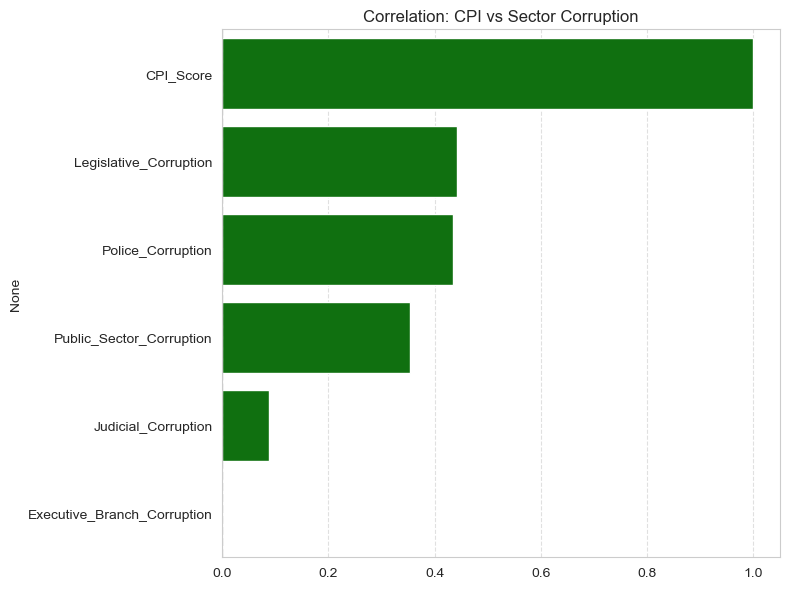

In [313]:
sector_columns = [
    'Public_Sector_Corruption', 'Judicial_Corruption',
    'Police_Corruption', 'Executive_Branch_Corruption',
    'Legislative_Corruption'
]

correlations_sector = compute_correlation(df_latest, sector_columns)
print("Sector-Wise Corruption - Correlation with CPI:")
print(correlations_sector)

plot_correlation(correlations_sector, "Correlation: CPI vs Sector Corruption")

In [314]:
# Keep only the latest year's data per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

## Top 5 Countries

In [316]:
sectors = [
    'Public_Sector_Corruption',
    'Judicial_Corruption',
    'Police_Corruption',
    'Executive_Branch_Corruption',
    'Legislative_Corruption'
]

top_corrupt_per_sector = {}

for sector in sectors:
    top_corrupt = df_latest[['Country', sector]].sort_values(by=sector, ascending=False).head(5)
    top_corrupt_per_sector[sector] = top_corrupt
    print(f"\nTop 5 Countries - {sector.replace('_', ' ')}:")
    print(top_corrupt.to_string(index=False))


Top 5 Countries - Public Sector Corruption:
Country  Public_Sector_Corruption
 Russia                  8.684626
  Japan                  8.299575
Germany                  7.613887
     UK                  6.127221
    USA                  5.718826

Top 5 Countries - Judicial Corruption:
Country  Judicial_Corruption
Germany             9.774743
 France             9.499248
     UK             7.038527
  Japan             6.707102
  China             6.537201

Top 5 Countries - Police Corruption:
     Country  Police_Corruption
          UK           9.870231
         USA           7.279024
South Africa           6.182003
       China           6.018069
     Germany           5.472928

Top 5 Countries - Executive Branch Corruption:
Country  Executive_Branch_Corruption
Germany                     9.012660
     UK                     8.614986
  Japan                     8.438590
 Russia                     4.697519
    USA                     4.440387

Top 5 Countries - Legislative Corrup

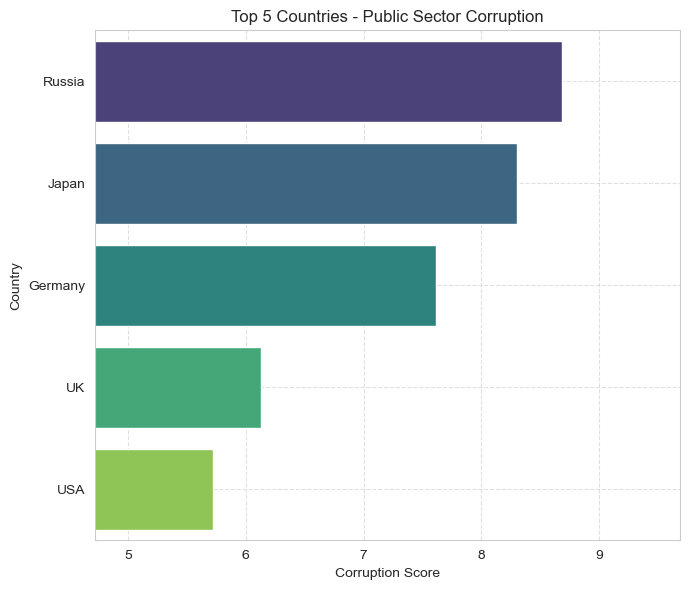

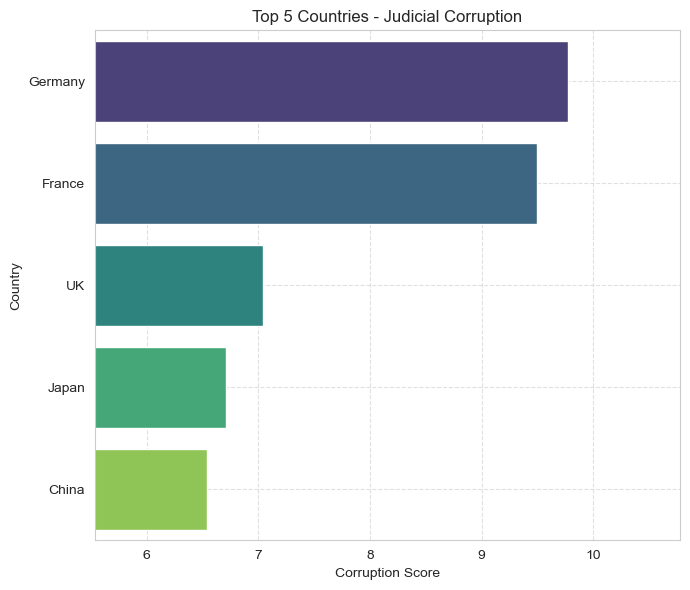

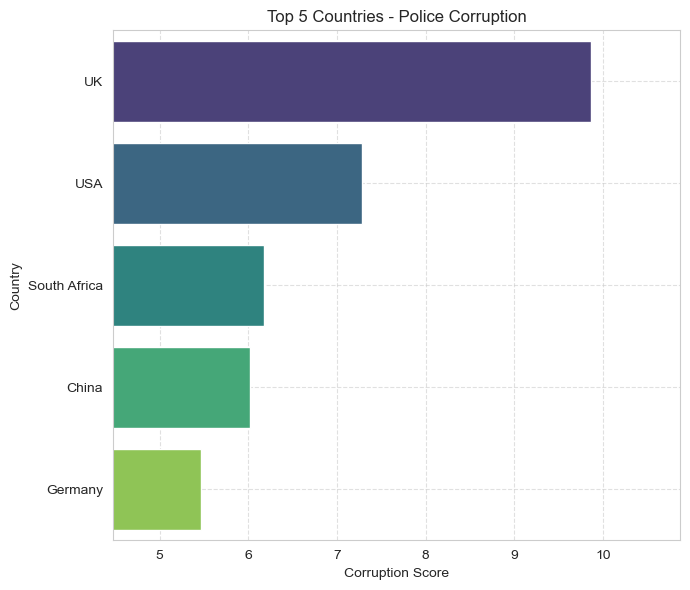

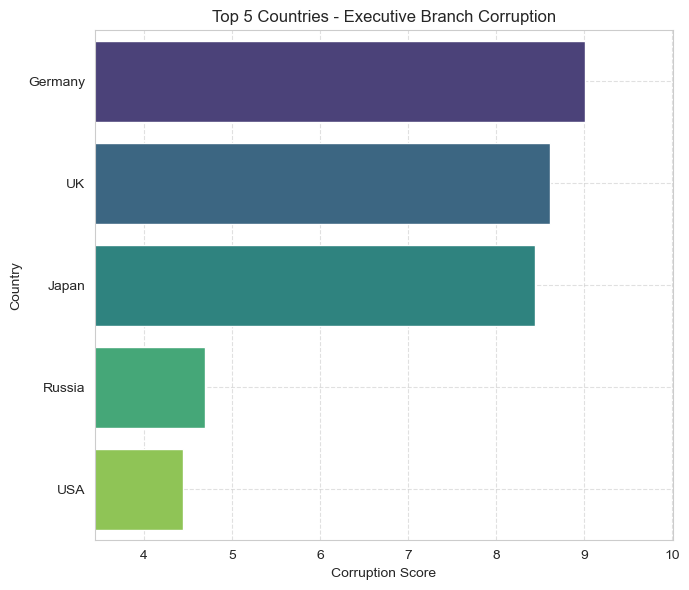

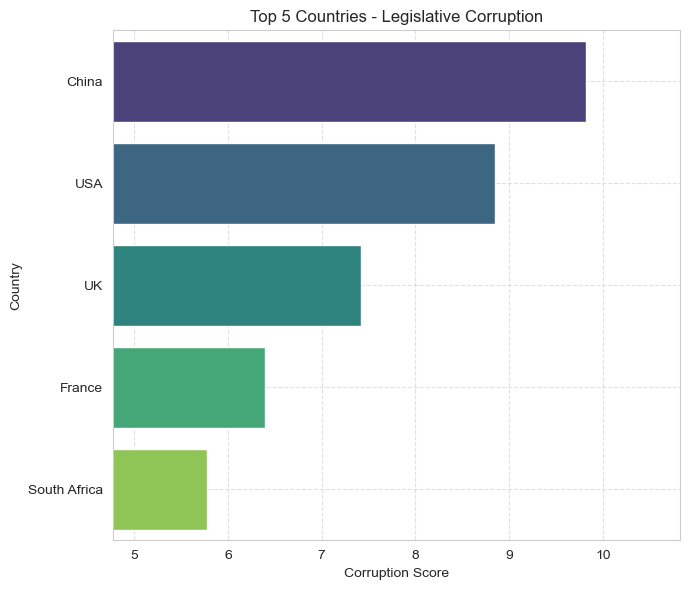

In [317]:
for sector, df_sector in top_corrupt_per_sector.items():
    plt.figure(figsize=(7, 6))
    sns.barplot(data=df_sector, x=sector, y='Country',hue='Country', palette="viridis")
    plt.title(f"Top 5 Countries - {sector.replace('_', ' ')}")
    plt.xlabel("Corruption Score")
    plt.ylabel("Country")
    plt.xlim(df_sector[sector].min() - 1, df_sector[sector].max() + 1)  # dynamic x-axis
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()


Top 5 Countries - Public Sector Corruption:
Country  Public_Sector_Corruption
 Russia                  8.684626
  Japan                  8.299575
Germany                  7.613887
     UK                  6.127221
    USA                  5.718826

Top 5 Countries - Judicial Corruption:
Country  Judicial_Corruption
Germany             9.774743
 France             9.499248
     UK             7.038527
  Japan             6.707102
  China             6.537201

Top 5 Countries - Police Corruption:
     Country  Police_Corruption
          UK           9.870231
         USA           7.279024
South Africa           6.182003
       China           6.018069
     Germany           5.472928

Top 5 Countries - Executive Branch Corruption:
Country  Executive_Branch_Corruption
Germany                     9.012660
     UK                     8.614986
  Japan                     8.438590
 Russia                     4.697519
    USA                     4.440387

Top 5 Countries - Legislative Corrup

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3836599714.py:38: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since hue is just for coloring


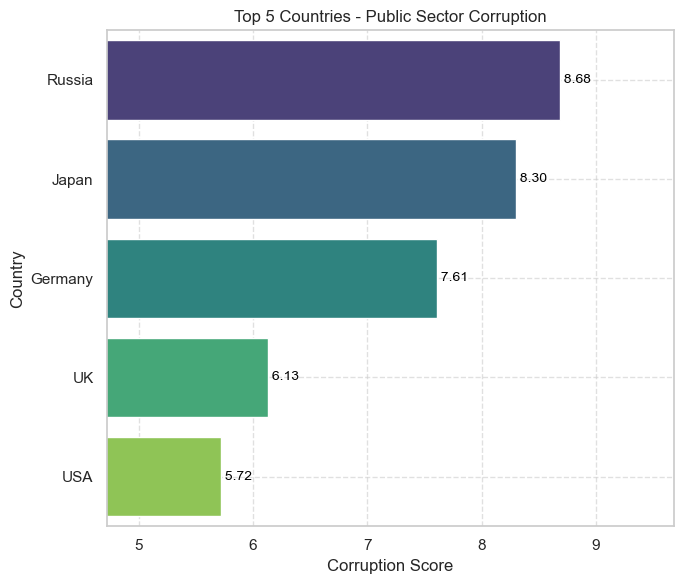

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3836599714.py:38: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since hue is just for coloring


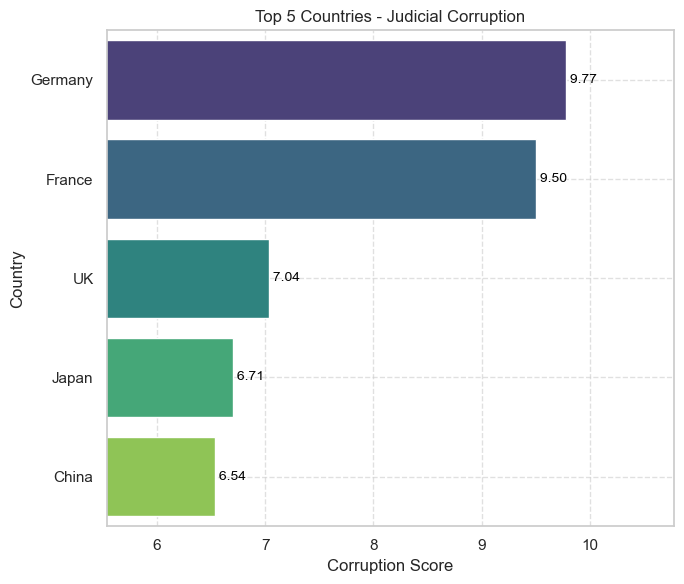

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3836599714.py:38: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since hue is just for coloring


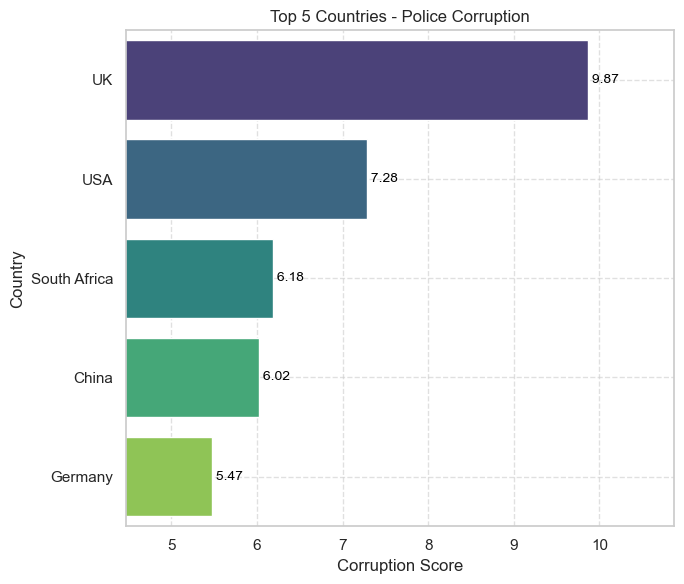

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3836599714.py:38: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since hue is just for coloring


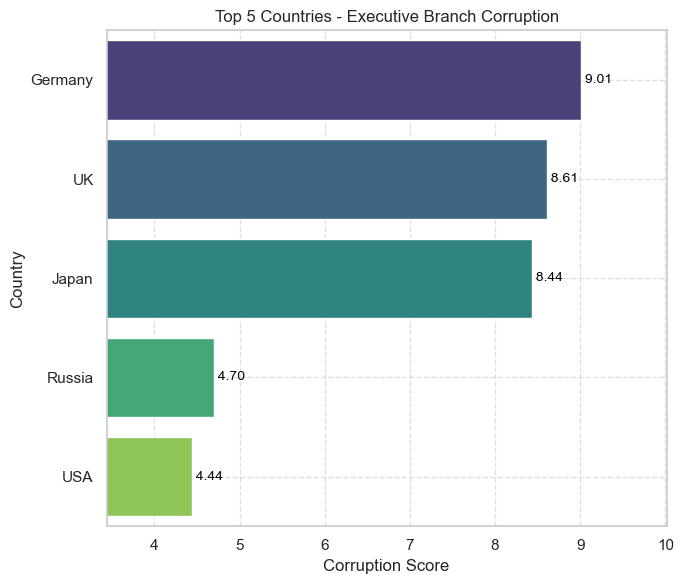

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3836599714.py:38: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since hue is just for coloring


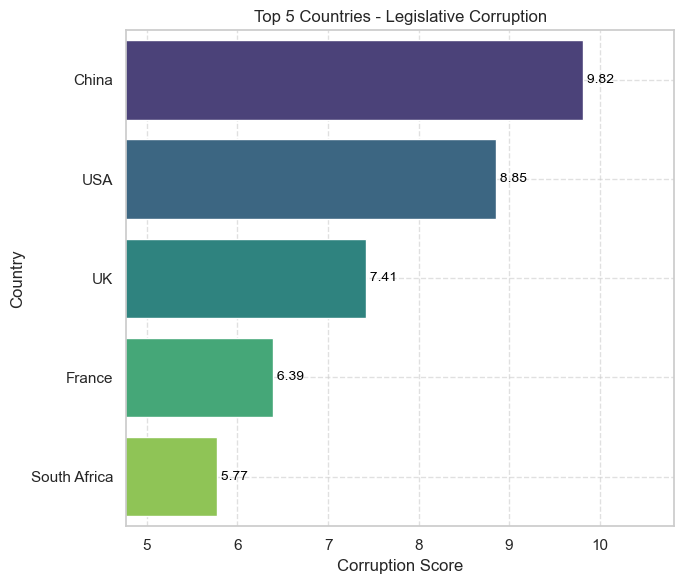

In [517]:
import seaborn as sns
import matplotlib.pyplot as plt

# List of corruption sectors (columns)
sectors = [
    'Public_Sector_Corruption',
    'Judicial_Corruption',
    'Police_Corruption',
    'Executive_Branch_Corruption',
    'Legislative_Corruption'
]

# Dictionary to store top 5 per sector
top_corrupt_per_sector = {}

# Get top 5 corrupt countries per sector
for sector in sectors:
    top_corrupt = df_latest[['Country', sector]].sort_values(by=sector, ascending=False).head(5)
    top_corrupt_per_sector[sector] = top_corrupt
    print(f"\nTop 5 Countries - {sector.replace('_', ' ')}:")
    print(top_corrupt.to_string(index=False))

# Plotting with value labels
for sector, df_sector in top_corrupt_per_sector.items():
    plt.figure(figsize=(7, 6))
    ax = sns.barplot(data=df_sector, x=sector, y='Country', hue='Country', palette="viridis", dodge=False)

    # Add value labels
    for i, (idx, row) in enumerate(df_sector.iterrows()):
        ax.text(row[sector], i, f' {row[sector]:.2f}', color='black', va='center', fontsize=10)

    # Formatting
    plt.title(f"Top 5 Countries - {sector.replace('_', ' ')}")
    plt.xlabel("Corruption Score")
    plt.ylabel("Country")
    plt.xlim(df_sector[sector].min() - 1, df_sector[sector].max() + 1)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.legend().set_visible(False)  # Hide legend since hue is just for coloring
    plt.tight_layout()
    plt.show()

# Trends For Each Country Sector Corruption


Plotting trends for sector: Public_Sector_Corruption


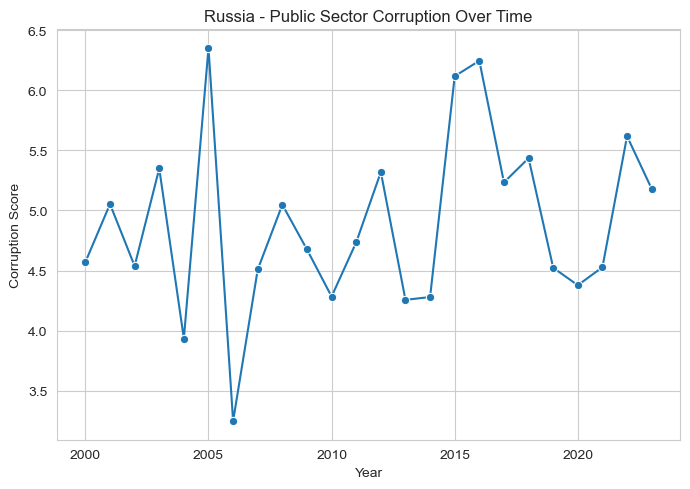

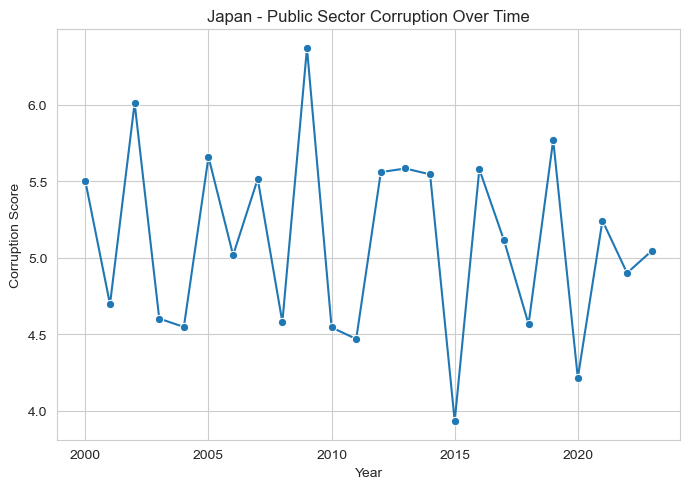

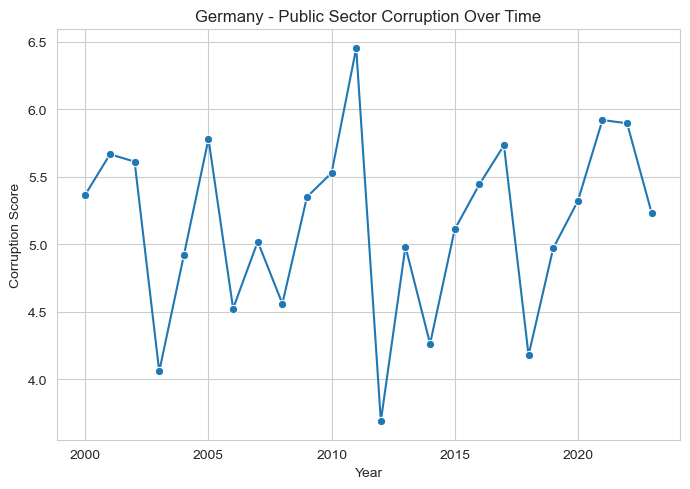

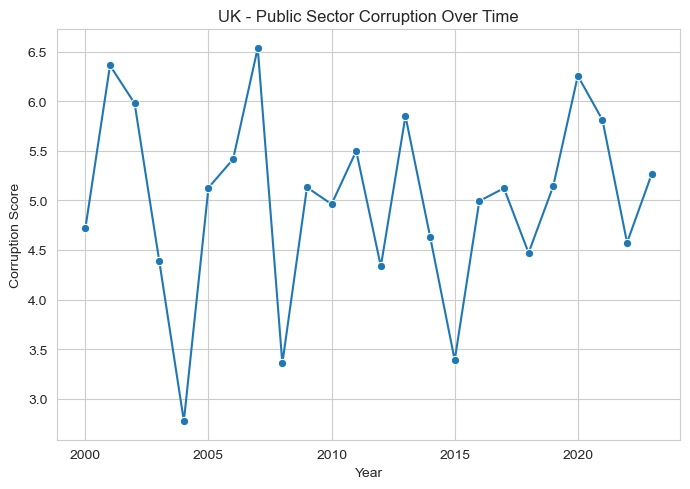

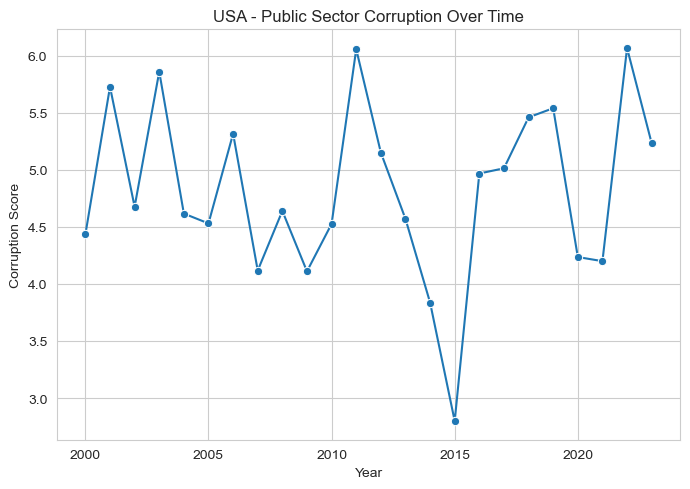


Plotting trends for sector: Judicial_Corruption


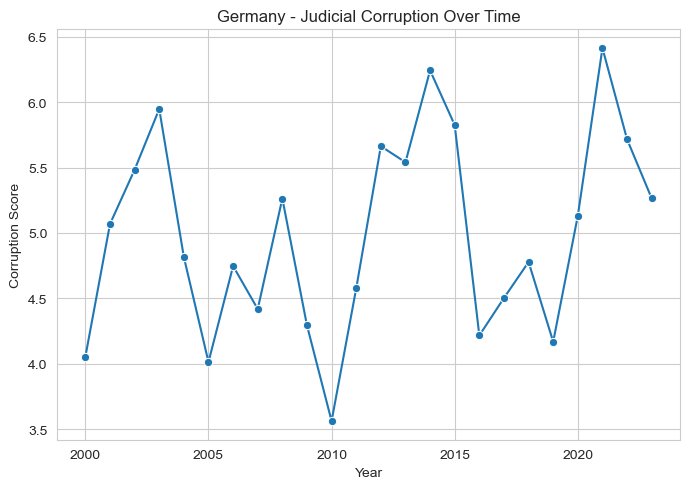

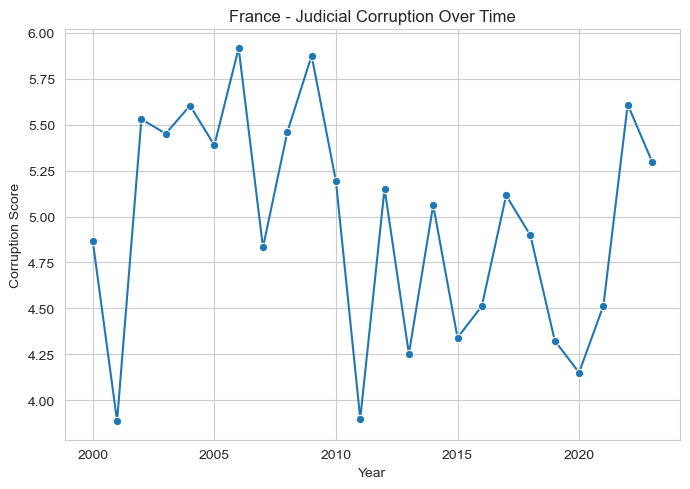

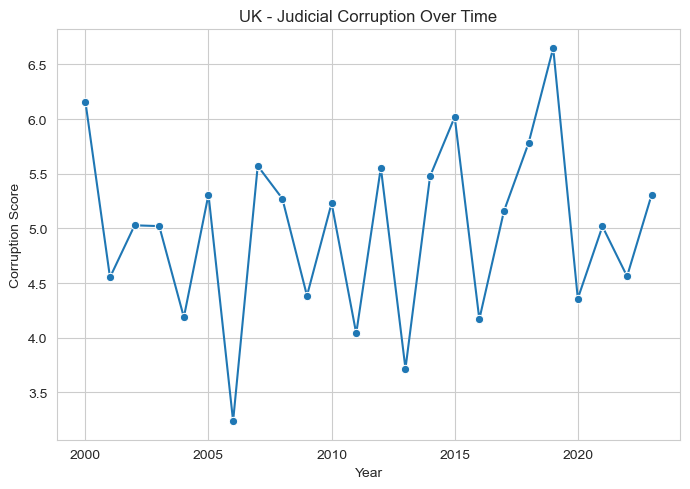

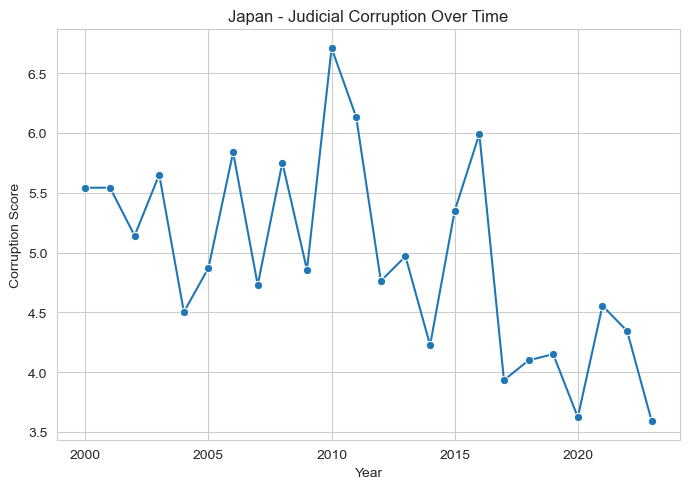

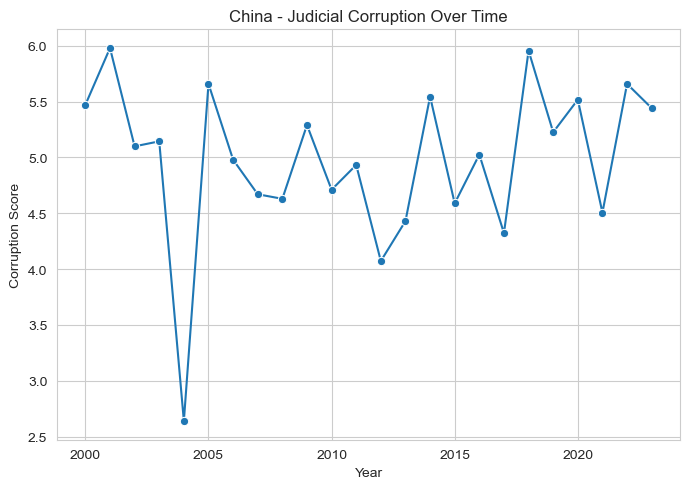


Plotting trends for sector: Police_Corruption


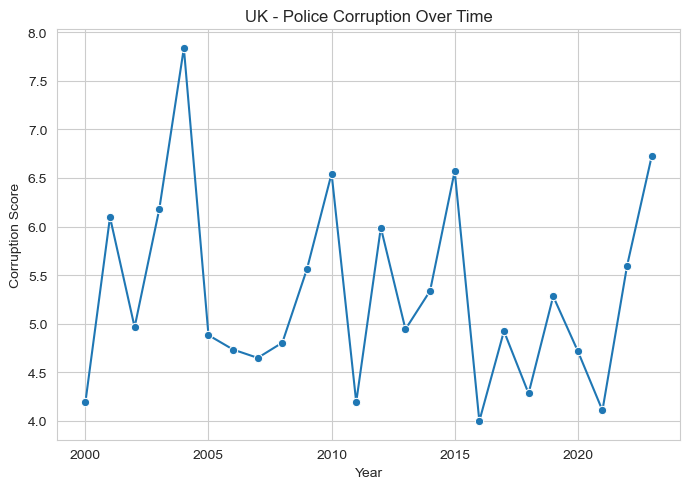

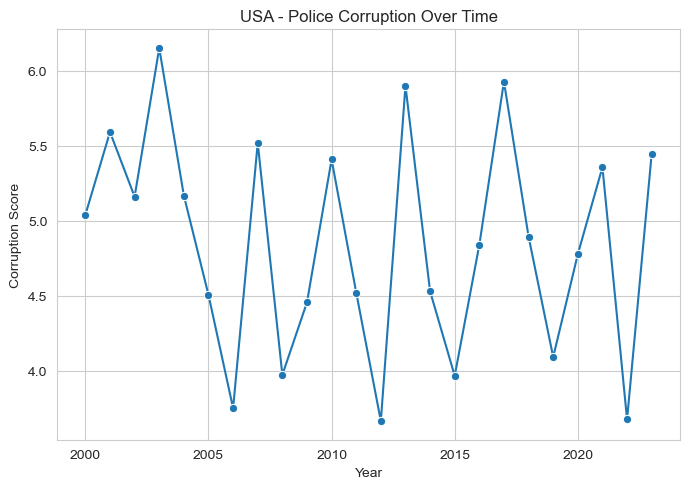

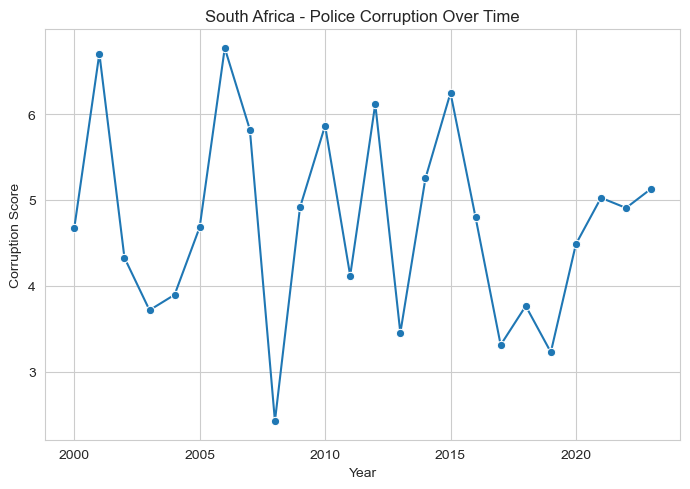

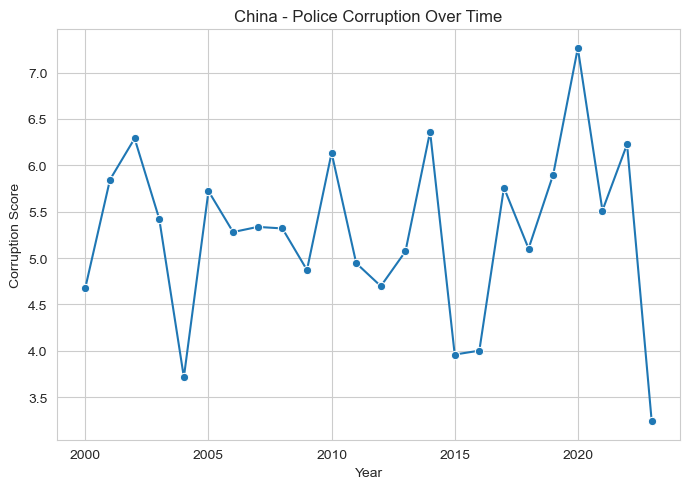

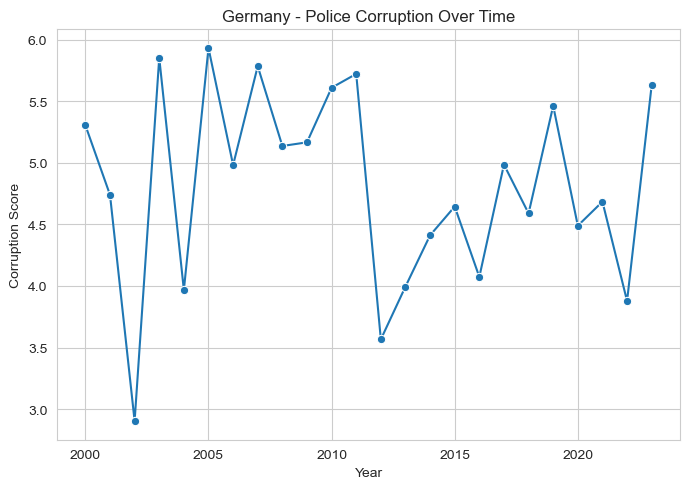


Plotting trends for sector: Executive_Branch_Corruption


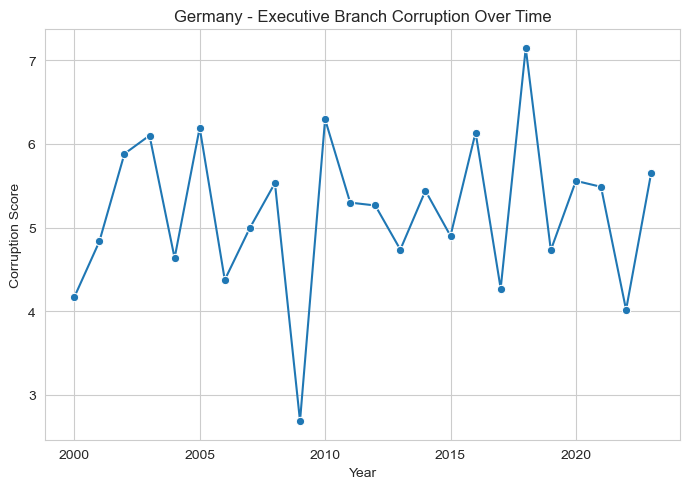

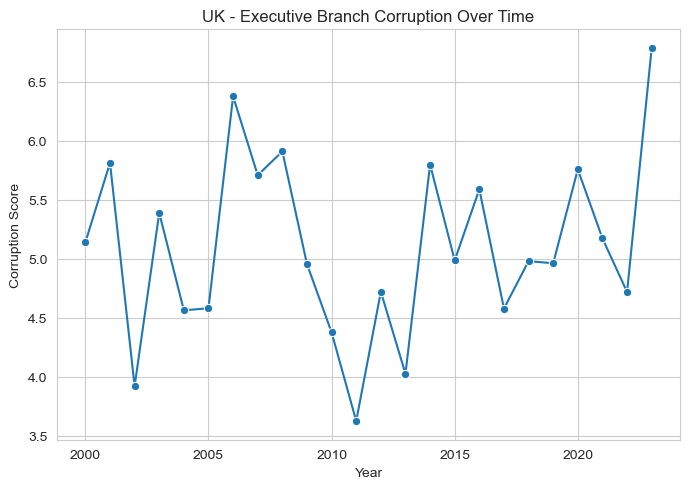

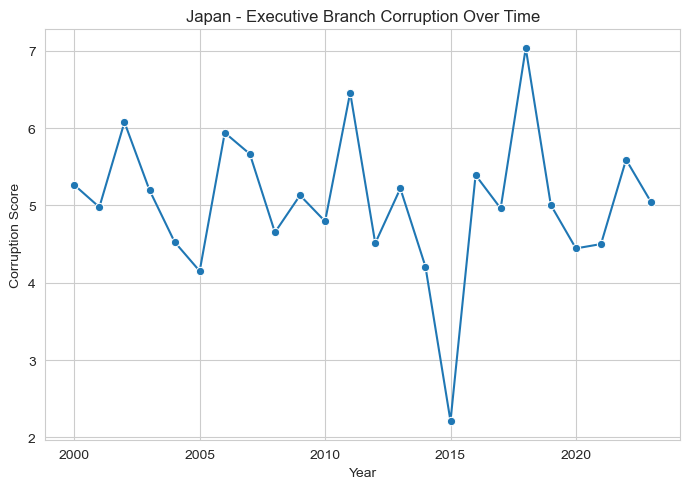

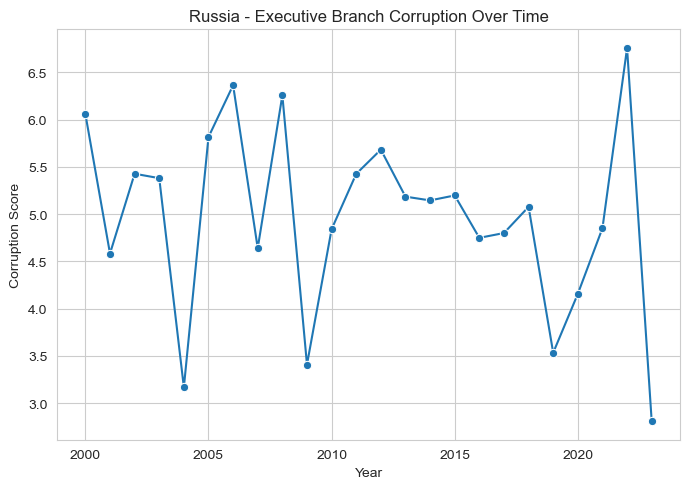

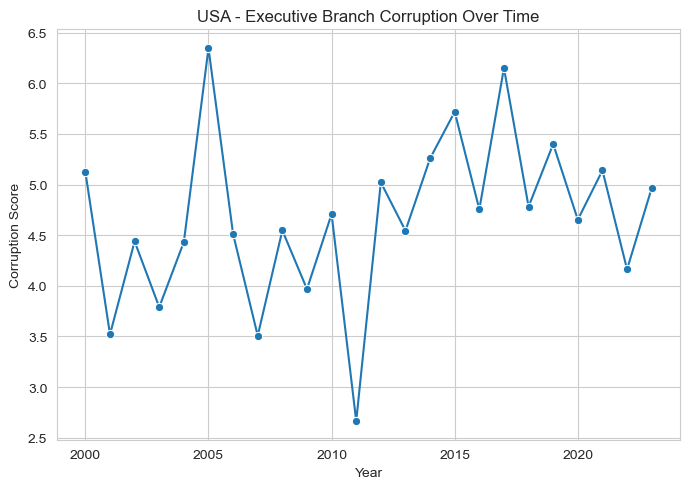


Plotting trends for sector: Legislative_Corruption


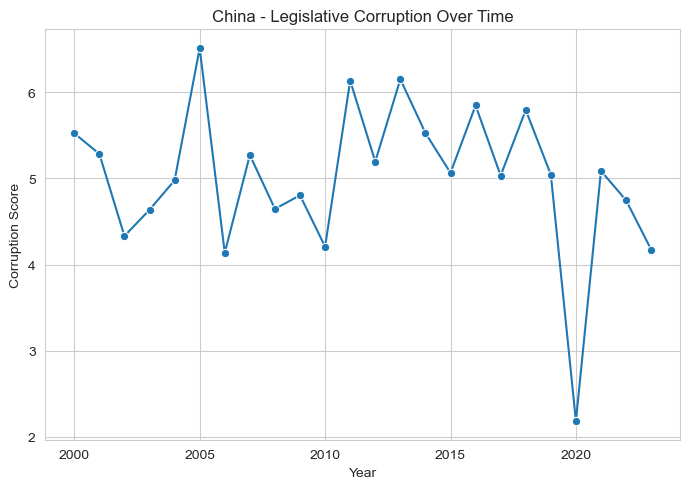

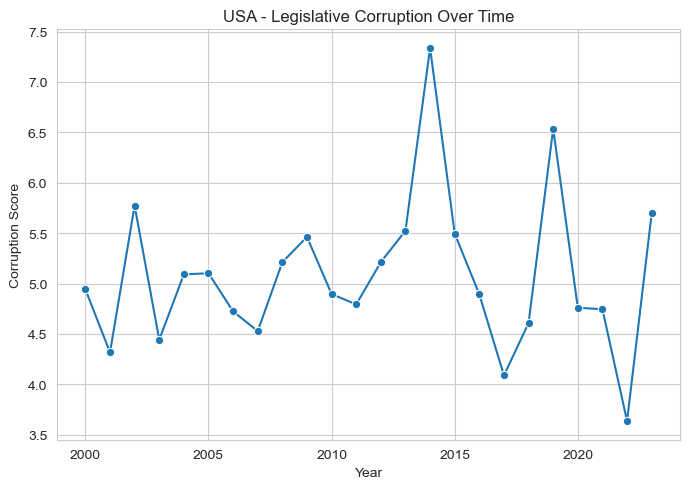

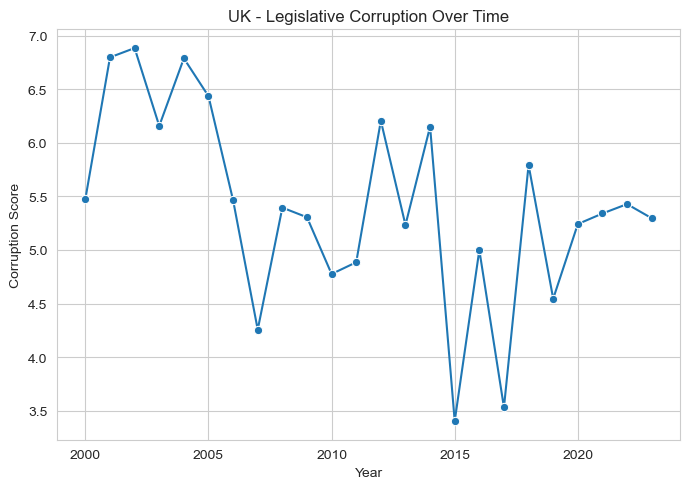

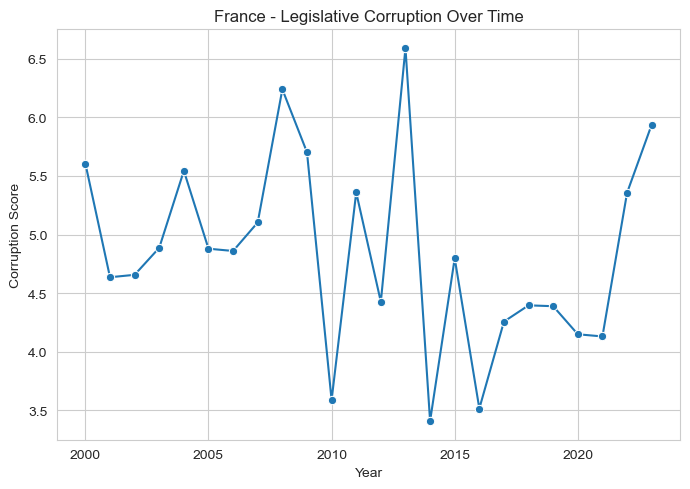

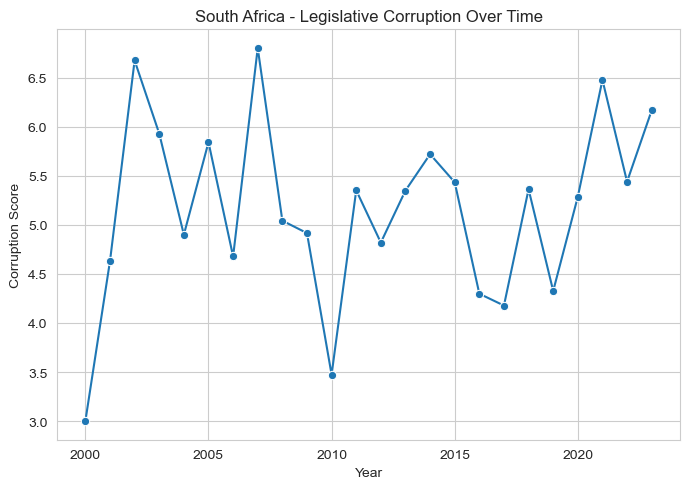

In [319]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Loop through each sector and each top country in that sector
for sector, df_sector in top_corrupt_per_sector.items():
    print(f"\nPlotting trends for sector: {sector}")
    
    for country in df_sector['Country']:
        # Filter data for this country and sector
        country_data = df[df['Country'] == country].sort_values(by='Year')
        
        # Check if data exists
        if country_data.empty:
            print(f"No data found for {country} in {sector}")
            continue
        
        # Plot without error bars
        plt.figure(figsize=(7, 5))
        sns.lineplot(
            data=country_data,
            x='Year',
            y=sector,
            marker='o',
            label=f"{country}'s {sector.replace('_', ' ')}",
            errorbar=None  # Disable error bars
        )
        plt.title(f"{country} - {sector.replace('_', ' ')} Over Time")
        plt.xlabel("Year")
        plt.ylabel("Corruption Score")
        plt.grid(True)
        plt.tight_layout()
        plt.legend().set_visible(False)  # Hide redundant legend since only one line
        plt.show()

# 5️⃣ Political & Freedom Indicators


### Correlation Between CPI and Political & Freedom Indicators


Political & Freedom Indicators - Correlation with CPI:
CPI_Score                     1.000000
Political_Party_Corruption    0.658593
Media_Corruption              0.297974
Civil_Liberties               0.207887
Democracy_Index               0.199705
Freedom_of_Press              0.055627
Name: CPI_Score, dtype: float64


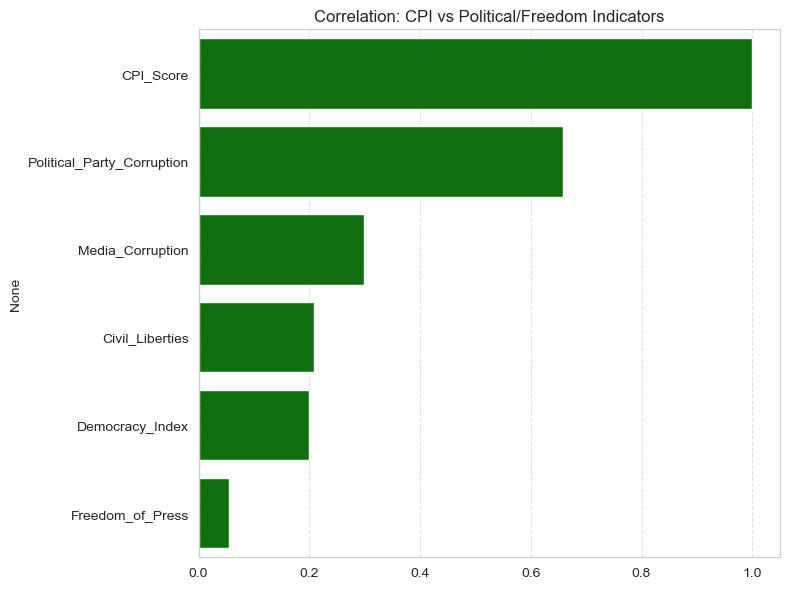

In [327]:
political_columns = [
    'Democracy_Index', 'Freedom_of_Press', 'Civil_Liberties',
    'Political_Party_Corruption', 'Media_Corruption'
]

correlations_political = compute_correlation(df_latest, political_columns)
print("Political & Freedom Indicators - Correlation with CPI:")
print(correlations_political)

plot_correlation(correlations_political, "Correlation: CPI vs Political/Freedom Indicators")

In [328]:
# Keep only the latest year's data per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

In [537]:
# Define freedom indicators with desired direction
freedom_indicators = {
    'Democracy_Index': 'highest',
    'Freedom_of_Press': 'highest',
    'Civil_Liberties': 'highest',
    'Political_Party_Corruption': 'lowest',  # higher = more corruption
    'Media_Corruption': 'lowest'            # higher = more corruption
}

results = {}

for col, direction in freedom_indicators.items():
    # Select relevant columns including Year
    temp_df = df_latest[['Country', 'Year', col]]
    
    if direction == 'highest':
        top = temp_df.sort_values(by=col, ascending=False).head(5)
    else:
        top = temp_df.sort_values(by=col).head(5)
    
    results[col] = top
    print(f"\nTop 5 Countries - {col.replace('_', ' ')} ({direction} priority):")
    print(top.to_string(index=False))


Top 5 Countries - Democracy Index (highest priority):
Country  Year  Democracy_Index
  China  2023         7.408475
    USA  2023         5.326156
 Russia  2023         4.155529
Germany  2023         4.100714
  India  2023         3.883519

Top 5 Countries - Freedom of Press (highest priority):
Country  Year  Freedom_of_Press
 Russia  2023          9.655248
    USA  2023          7.700344
  Japan  2023          7.538390
  China  2023          7.393619
     UK  2023          6.258061

Top 5 Countries - Civil Liberties (highest priority):
     Country  Year  Civil_Liberties
       Japan  2023         9.657674
South Africa  2023         8.065317
      Russia  2023         8.057962
          UK  2023         7.952440
         USA  2023         5.357545

Top 5 Countries - Political Party Corruption (lowest priority):
     Country  Year  Political_Party_Corruption
     Germany  2023                    0.371114
      Brazil  2023                    1.887540
       Japan  2023                

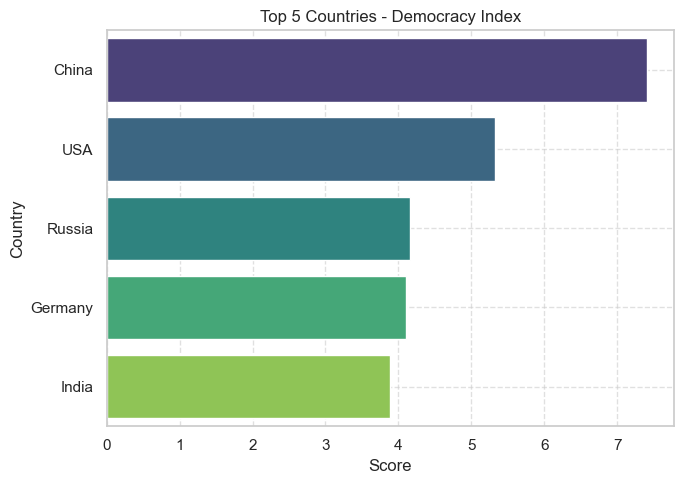

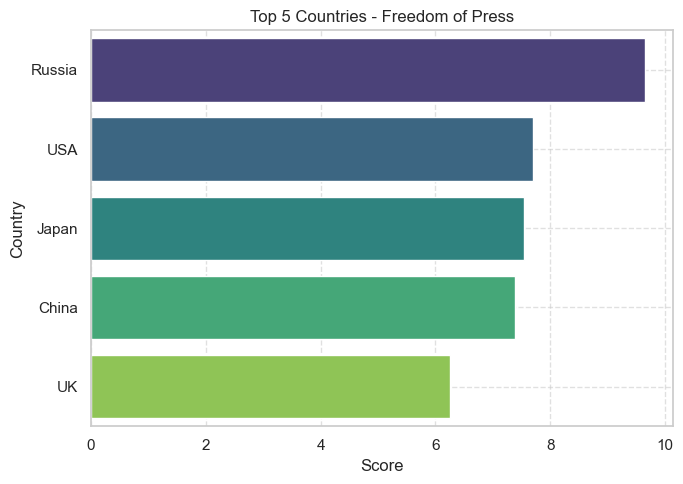

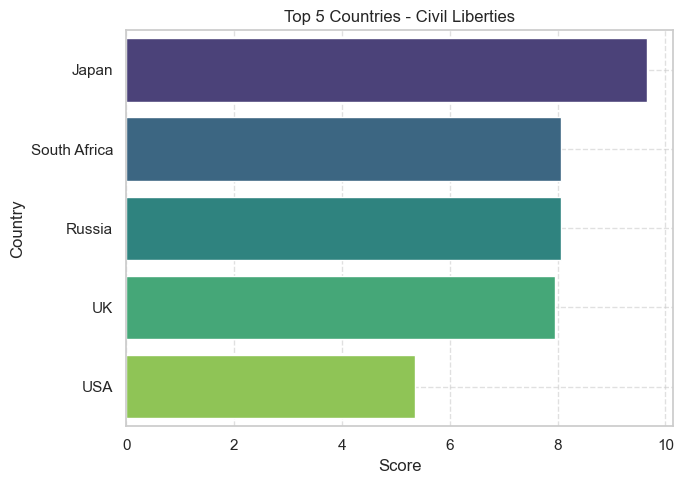

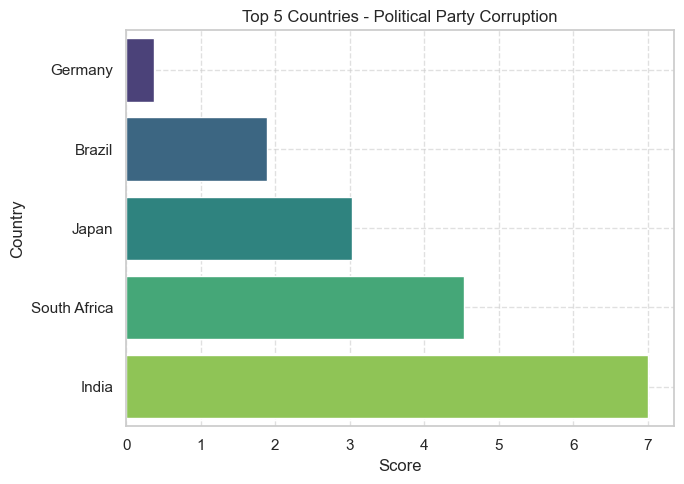

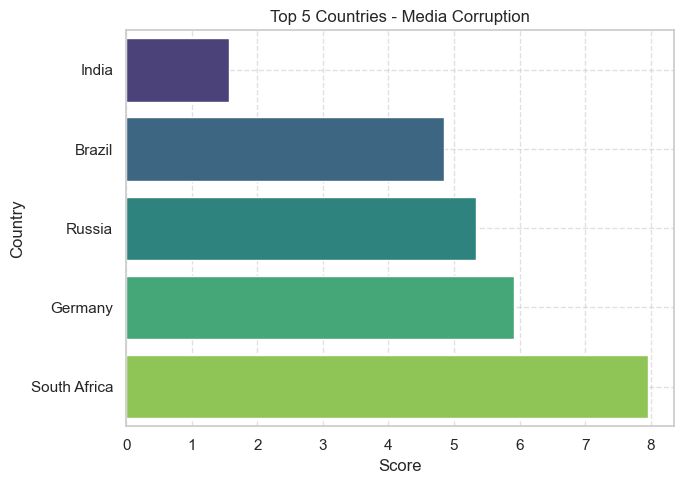

In [539]:
import matplotlib.pyplot as plt
import seaborn as sns

for col, _ in freedom_indicators.items():
    plt.figure(figsize=(7, 5))
    sns.barplot(data=results[col], x=col, y='Country',hue='Country', palette="viridis")
    plt.title(f"Top 5 Countries - {col.replace('_', ' ')}")
    plt.xlabel("Score")
    plt.ylabel("Country")
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\2179431179.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Optional: Hide legend if not needed


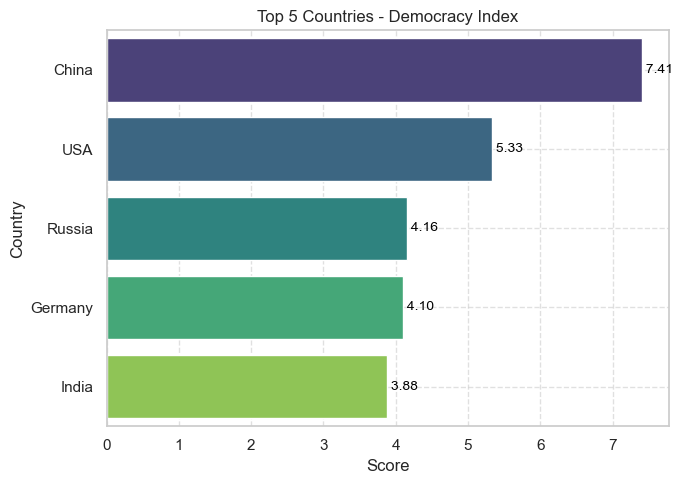

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\2179431179.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Optional: Hide legend if not needed


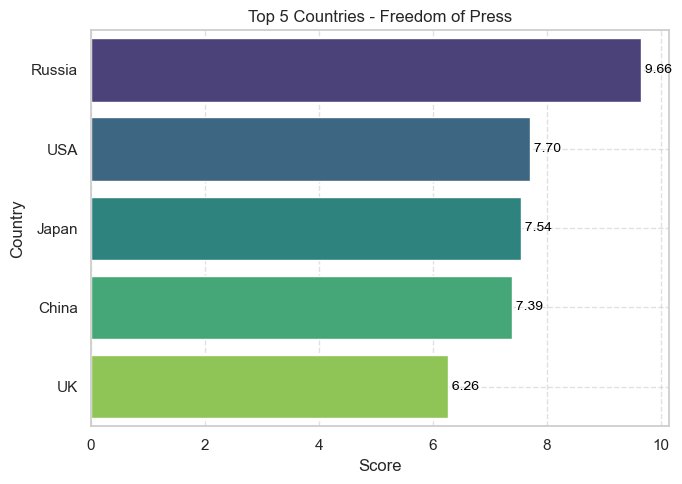

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\2179431179.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Optional: Hide legend if not needed


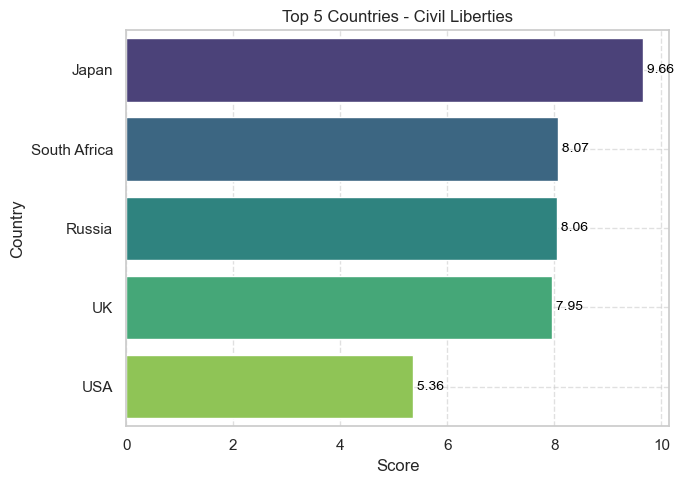

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\2179431179.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Optional: Hide legend if not needed


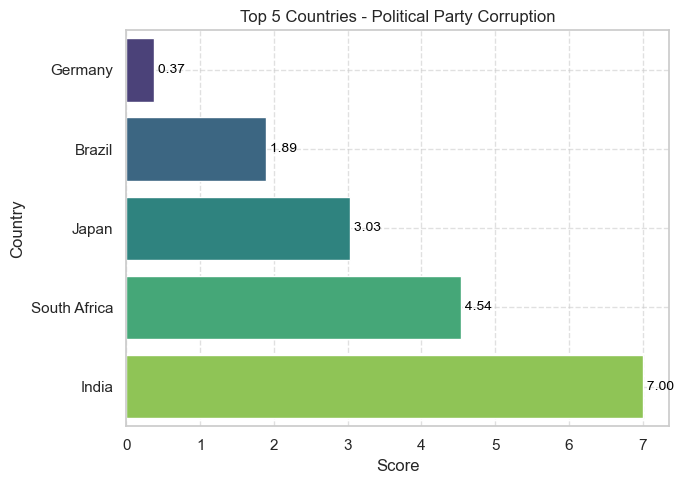

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\2179431179.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Optional: Hide legend if not needed


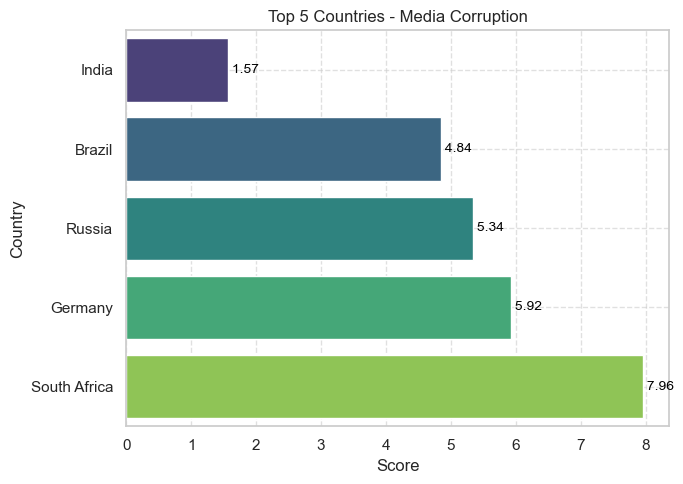

In [541]:
import matplotlib.pyplot as plt
import seaborn as sns

for col, _ in freedom_indicators.items():
    plt.figure(figsize=(7, 5))
    ax = sns.barplot(data=results[col], x=col, y='Country', hue='Country', palette="viridis", dodge=False)
    
    # Add value labels to the right of each bar
    for i, (idx, row) in enumerate(results[col].iterrows()):
        ax.text(row[col], i, f' {row[col]:.2f}', color='black', va='center', fontsize=10)

    plt.title(f"Top 5 Countries - {col.replace('_', ' ')}")
    plt.xlabel("Score")
    plt.ylabel("Country")
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.legend().set_visible(False)  # Optional: Hide legend if not needed
    plt.show()

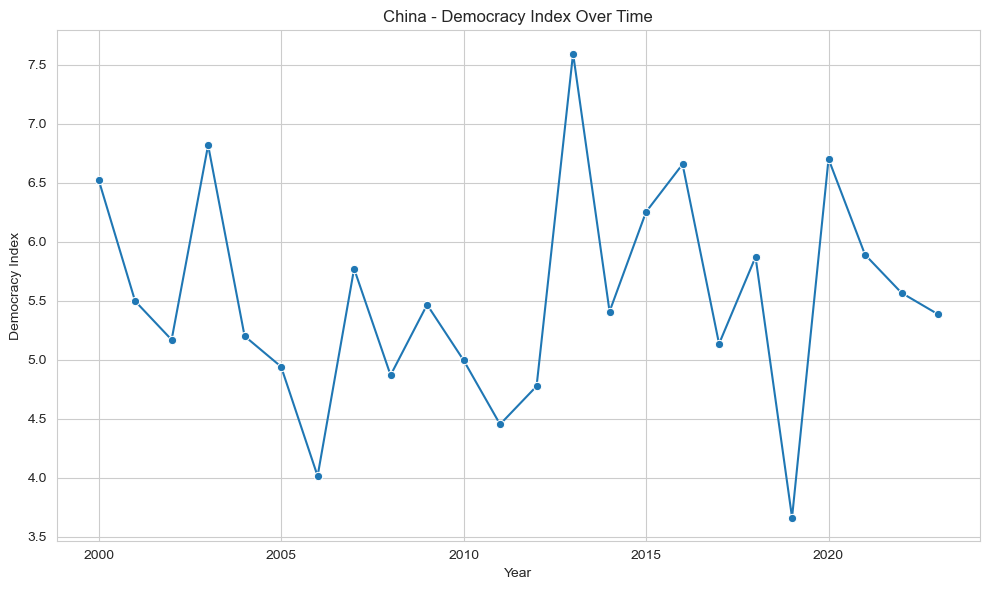

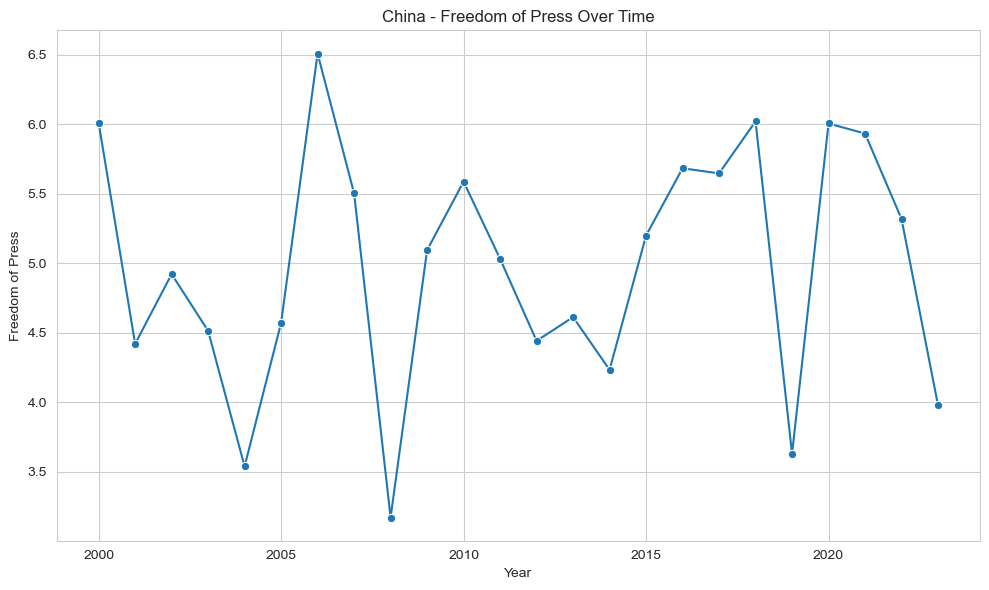

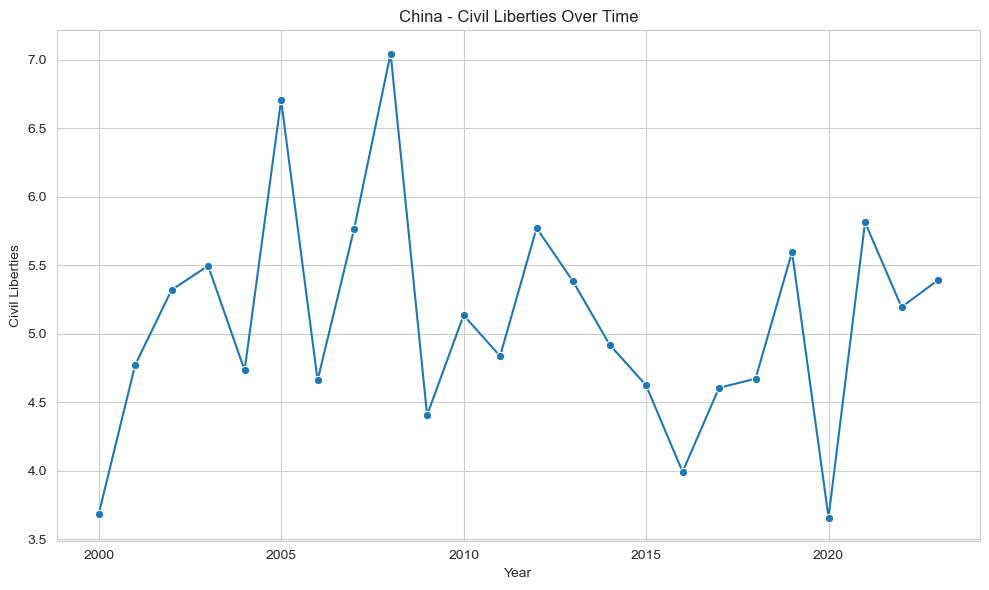

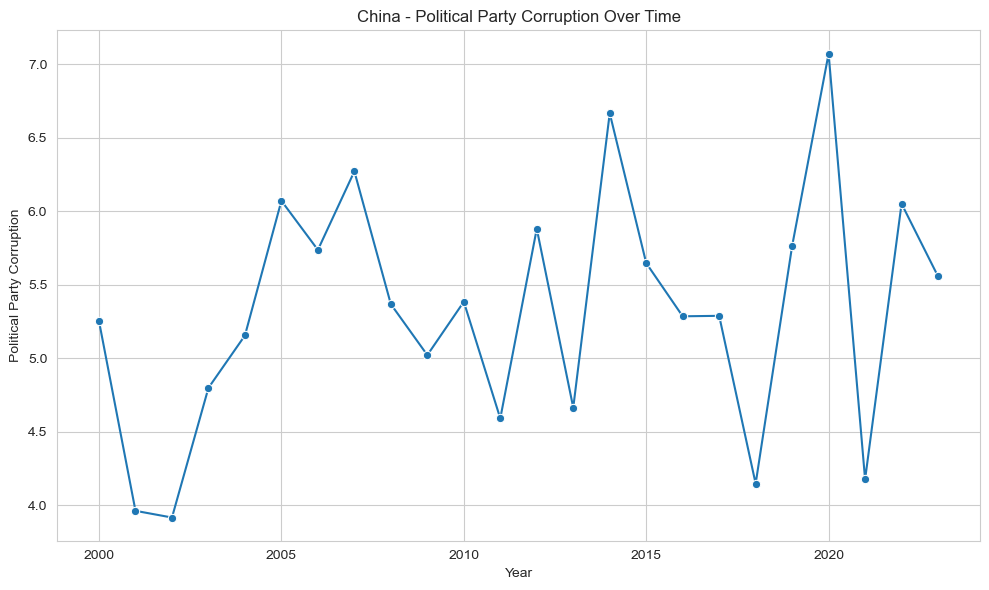

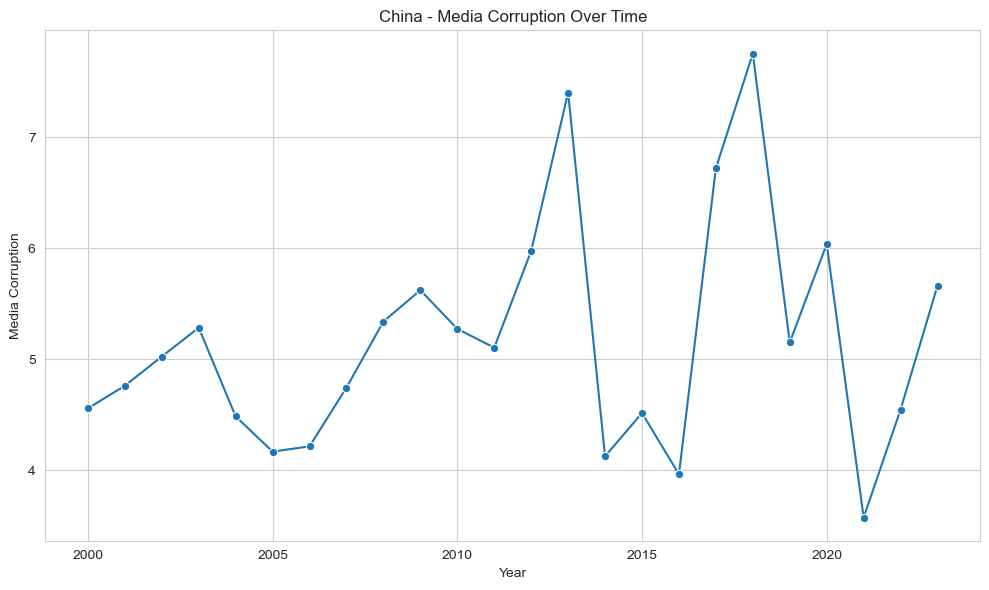

...

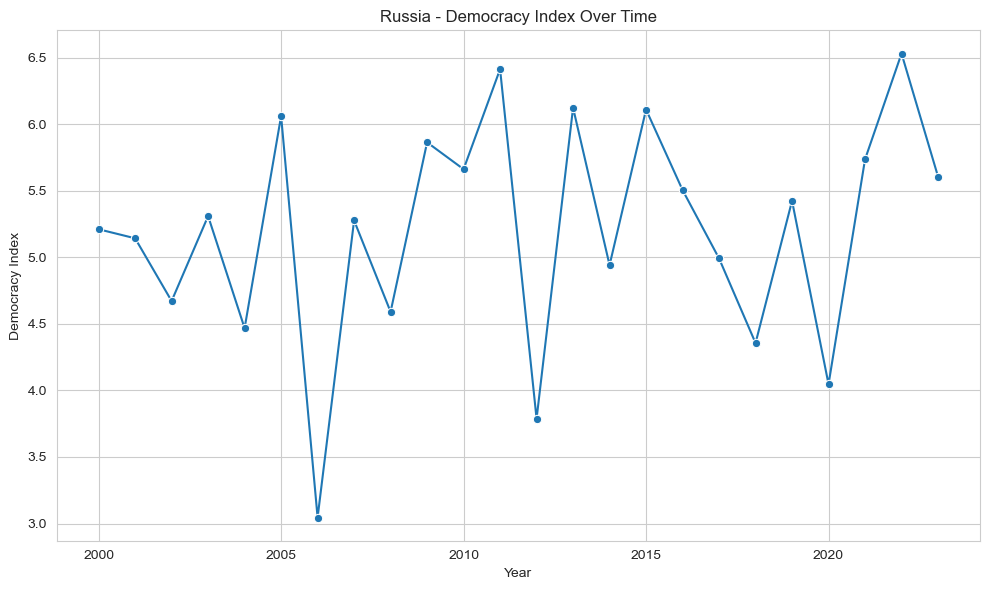

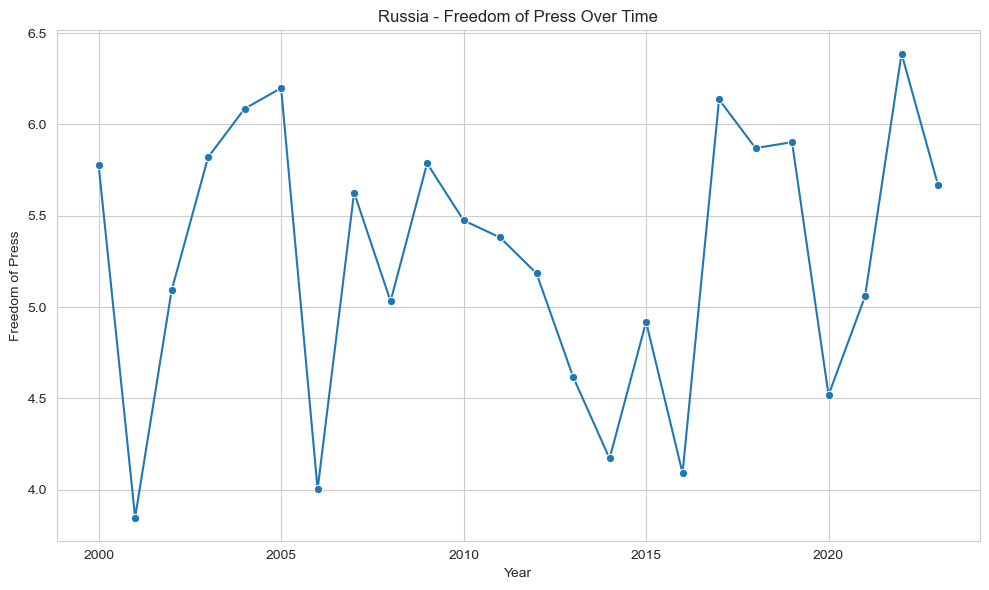

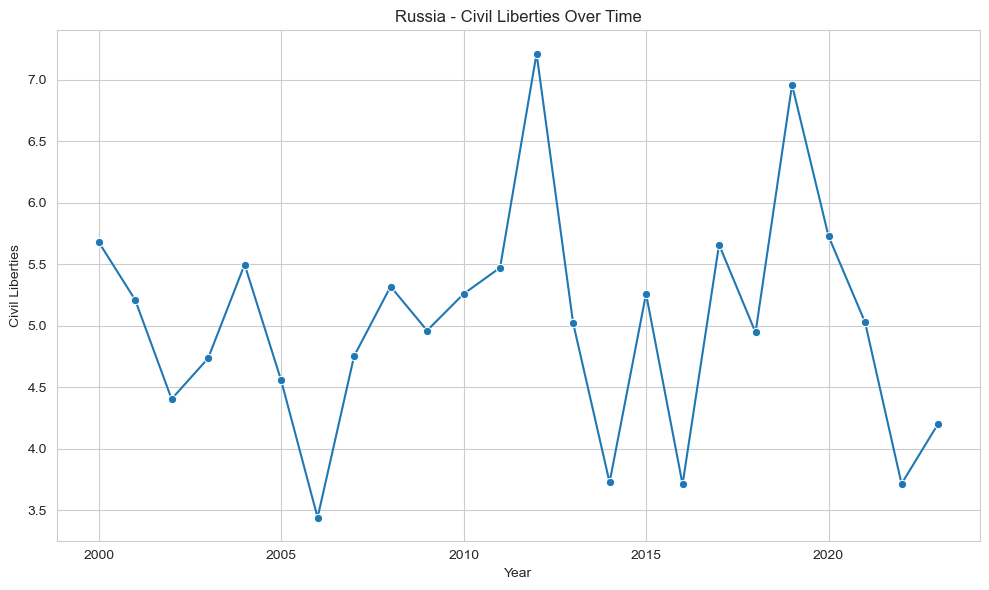

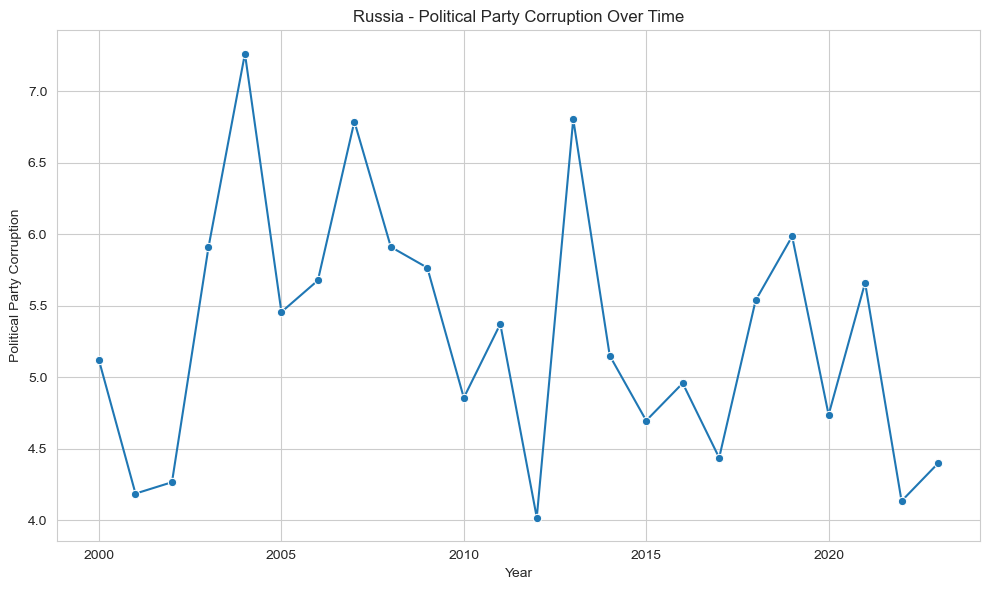

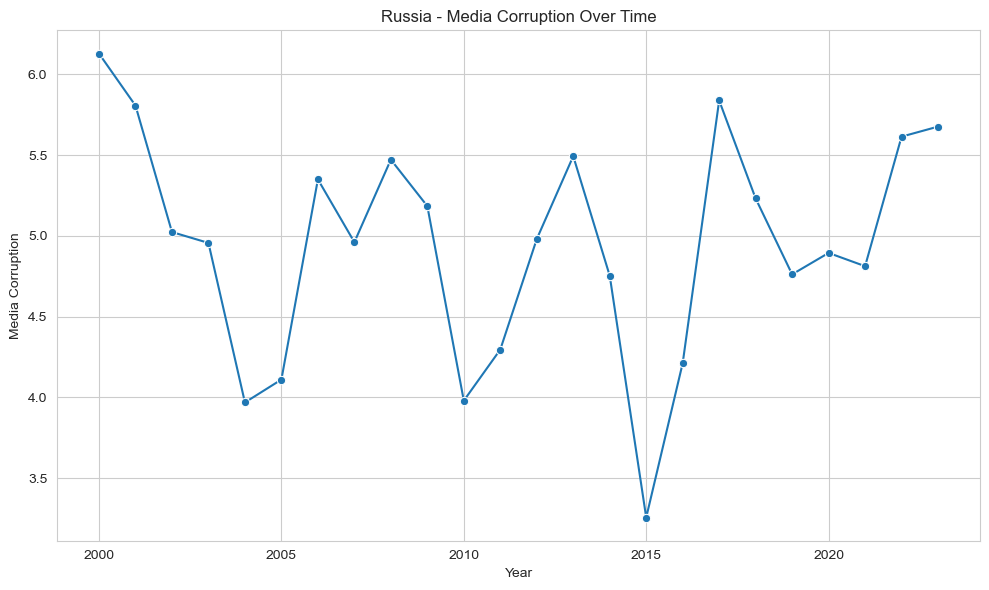

In [333]:
# Define freedom indicators
freedom_indicators = [
    'Democracy_Index',
    'Freedom_of_Press',
    'Civil_Liberties',
    'Political_Party_Corruption',
    'Media_Corruption'
]

# Get unique countries
countries = df['Country'].unique()

# Loop through each country
for country in countries:
    # Filter data for the current country
    country_data = df[df['Country'] == country]
    
    # Check if there's enough data for this country
    if country_data.empty:
        print(f"No data available for {country}. Skipping...")
        continue
    
    # Plot each freedom indicator for this country
    for indicator in freedom_indicators:
        plt.figure(figsize=(10, 6))
        sns.lineplot(data=country_data, x='Year', y=indicator, marker='o',errorbar=None)
        plt.title(f"{country} - {indicator.replace('_', ' ')} Over Time")
        plt.xlabel("Year")
        plt.ylabel(indicator.replace('_', ' '))
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# 6️⃣ Socio-Economic Indicators


## CPI vs Socio-Economic Indicators



Socio-Economic Indicators - Correlation with CPI:
CPI_Score            1.000000
Unemployment_Rate    0.374707
GDP_per_Capita       0.246084
Inflation_Rate       0.063794
Name: CPI_Score, dtype: float64


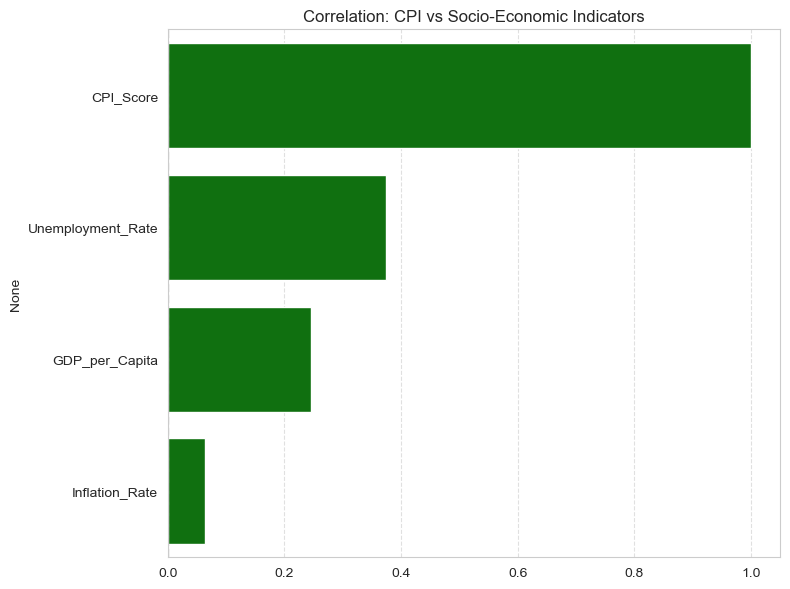

In [348]:
socio_columns = ['GDP_per_Capita', 'Unemployment_Rate', 'Inflation_Rate']

correlations_socio = compute_correlation(df_latest, socio_columns)
print("Socio-Economic Indicators - Correlation with CPI:")
print(correlations_socio)

plot_correlation(correlations_socio, "Correlation: CPI vs Socio-Economic Indicators")

## Top 5 Countries

In [350]:
# Keep only the latest year's data per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

In [352]:
socio_econ_indicators = {
    'GDP_per_Capita': 'highest',
    'Unemployment_Rate': 'lowest',
    'Inflation_Rate': 'lowest'
}

results_se = {}

for col, direction in socio_econ_indicators.items():
    if direction == 'highest':
        top = df_latest[['Country', 'Year', col]].sort_values(by=col, ascending=False).head(5)
    else:
        top = df_latest[['Country','Year', col]].sort_values(by=col).head(5)
    results_se[col] = top
    print(f"\nTop 5 Countries - {col.replace('_', ' ')} ({direction} priority):")
    print(top.to_string(index=False))


Top 5 Countries - GDP per Capita (highest priority):
     Country  Year  GDP_per_Capita
South Africa  2023           64838
          UK  2023           58491
       India  2023           35448
      Russia  2023           31281
       Japan  2023           19209

Top 5 Countries - Unemployment Rate (lowest priority):
Country  Year  Unemployment_Rate
  India  2023           1.083695
    USA  2023           2.338312
Germany  2023           4.057629
 Russia  2023           4.532240
 Brazil  2023           5.018829

Top 5 Countries - Inflation Rate (lowest priority):
Country  Year  Inflation_Rate
 France  2023        0.154407
  Japan  2023        2.826519
 Brazil  2023        2.963360
    USA  2023        6.287740
 Russia  2023        7.411417


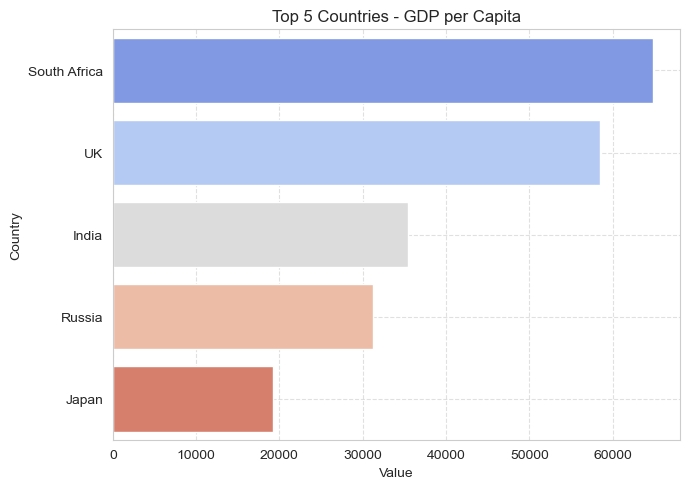

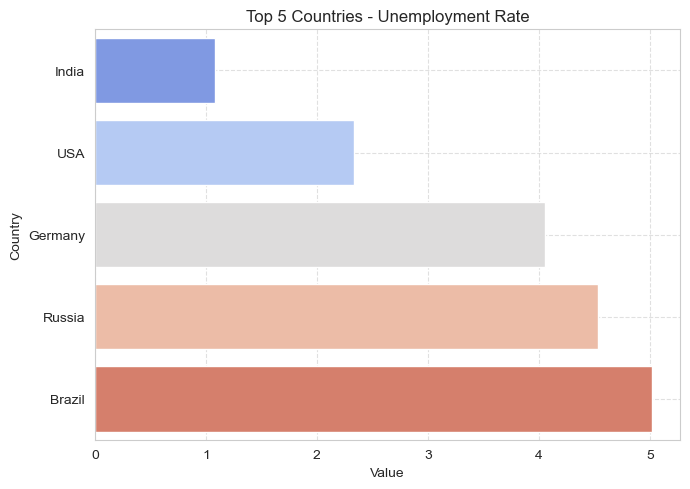

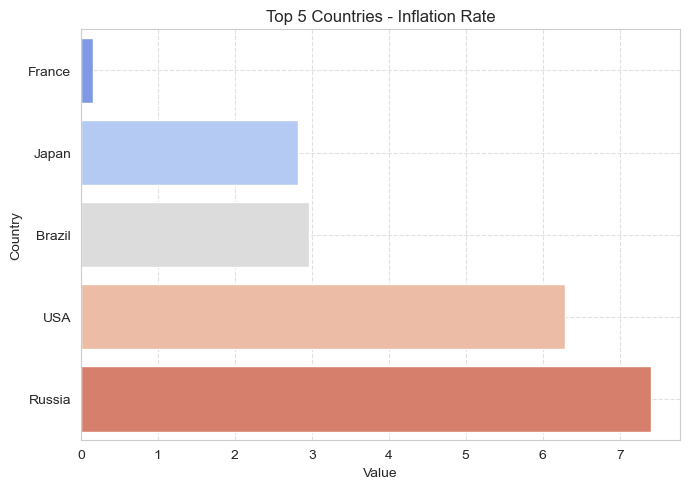

In [353]:
import matplotlib.pyplot as plt
import seaborn as sns

for col, _ in socio_econ_indicators.items():
    plt.figure(figsize=(7, 5))
    sns.barplot(data=results_se[col], x=col, y='Country',hue='Country', palette="coolwarm")
    plt.title(f"Top 5 Countries - {col.replace('_', ' ')}")
    plt.xlabel("Value")
    plt.ylabel("Country")
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3200800061.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Optional: Hide legend since only one bar per country


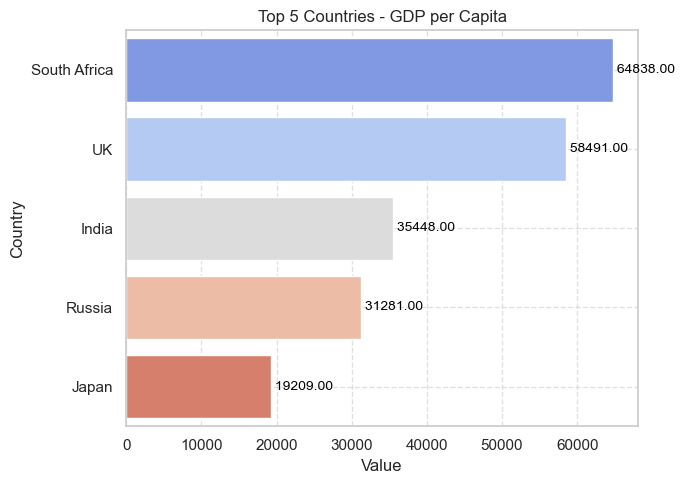

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3200800061.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Optional: Hide legend since only one bar per country


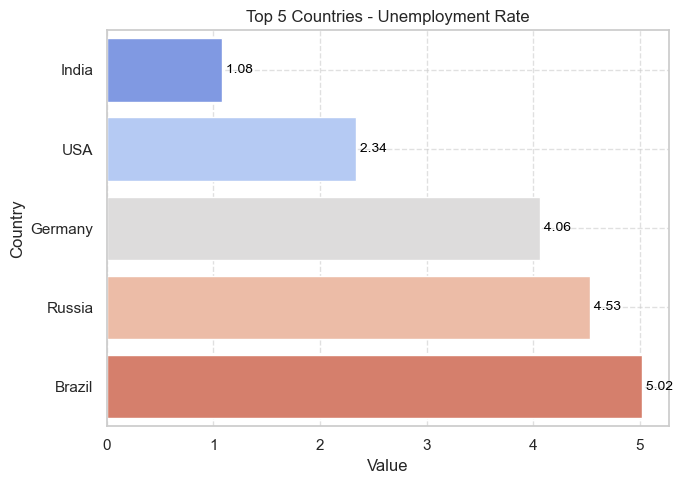

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3200800061.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Optional: Hide legend since only one bar per country


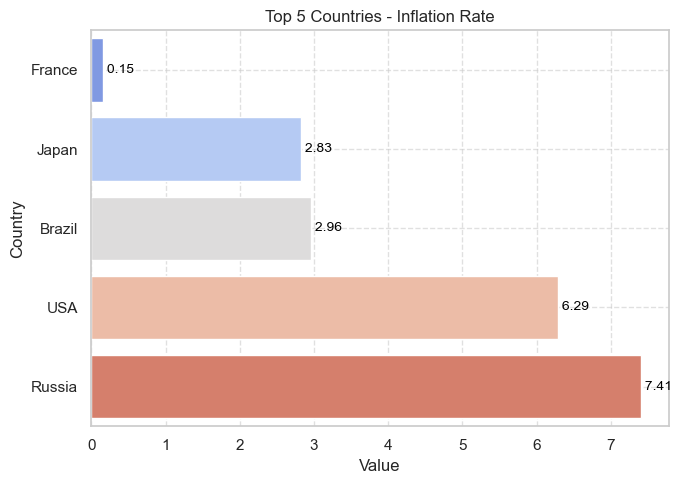

In [543]:
import matplotlib.pyplot as plt
import seaborn as sns

for col, _ in socio_econ_indicators.items():
    plt.figure(figsize=(7, 5))
    ax = sns.barplot(data=results_se[col], x=col, y='Country', hue='Country', palette="coolwarm", dodge=False)
    
    # Add value labels to the right of each bar
    for i, (idx, row) in enumerate(results_se[col].iterrows()):
        ax.text(row[col], i, f' {row[col]:.2f}', color='black', va='center', fontsize=10)
    
    plt.title(f"Top 5 Countries - {col.replace('_', ' ')}")
    plt.xlabel("Value")
    plt.ylabel("Country")
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.legend().set_visible(False)  # Optional: Hide legend since only one bar per country
    plt.show()

In [354]:
indicators = [
    'GDP_per_Capita',
    'Unemployment_Rate',
    'Inflation_Rate',
    'HDI',
    'Internet_Penetration'
]
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

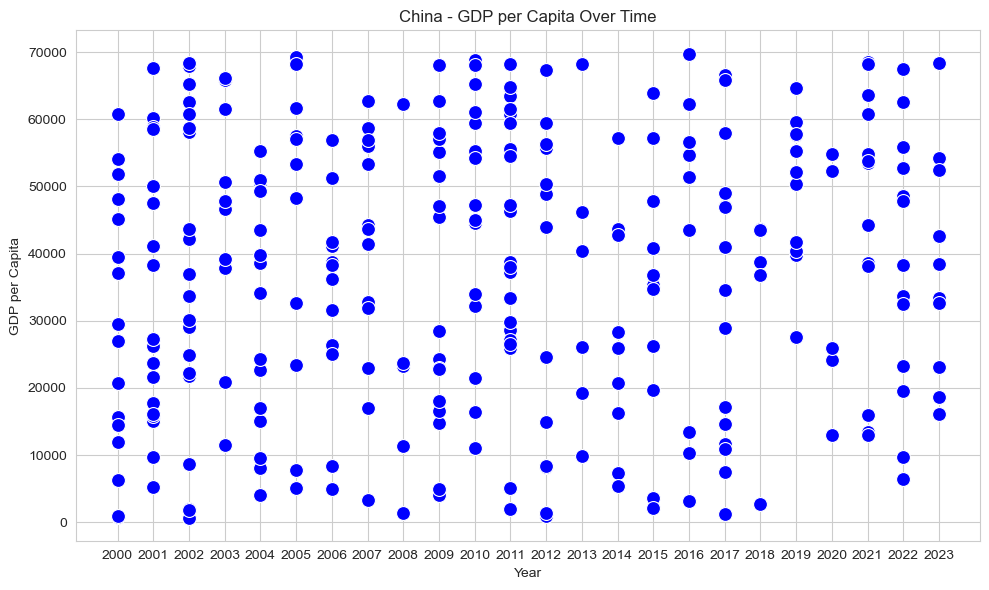

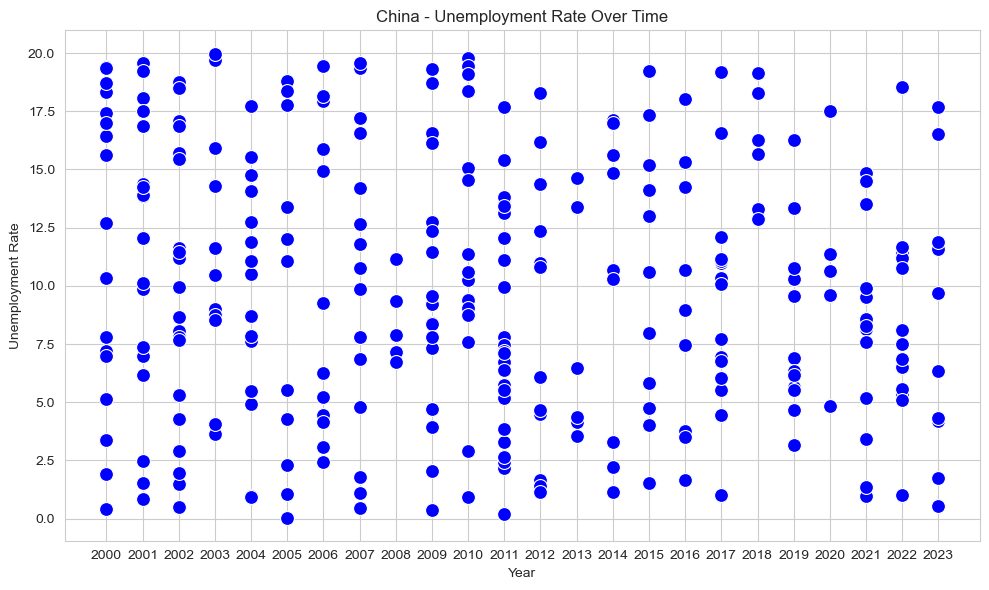

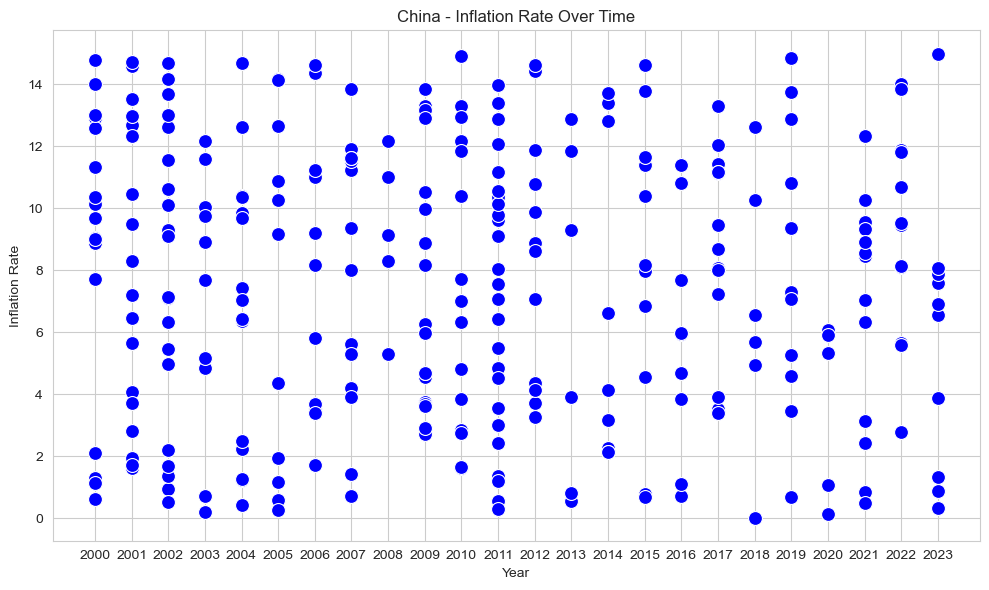

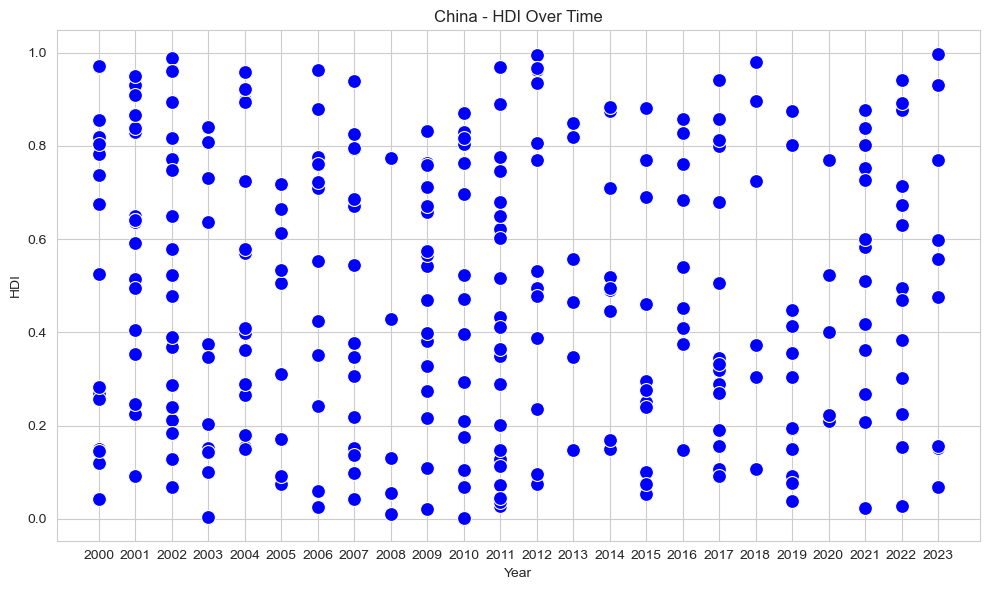

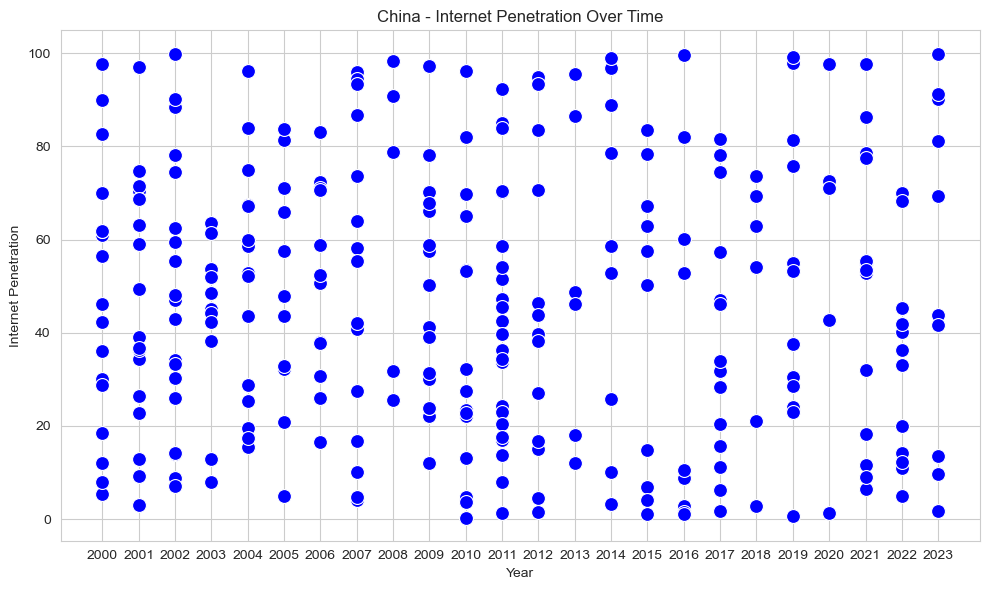

...

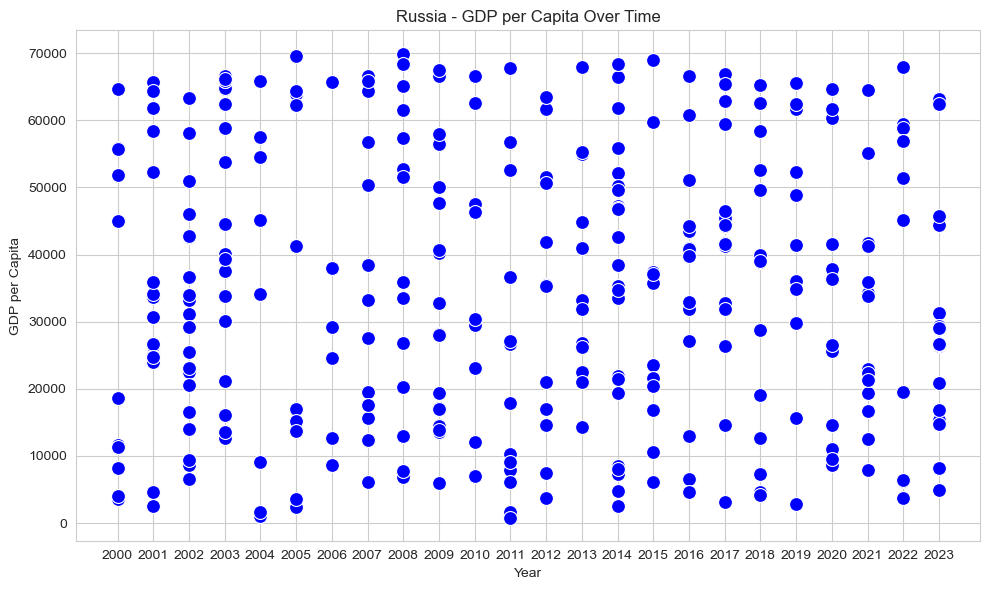

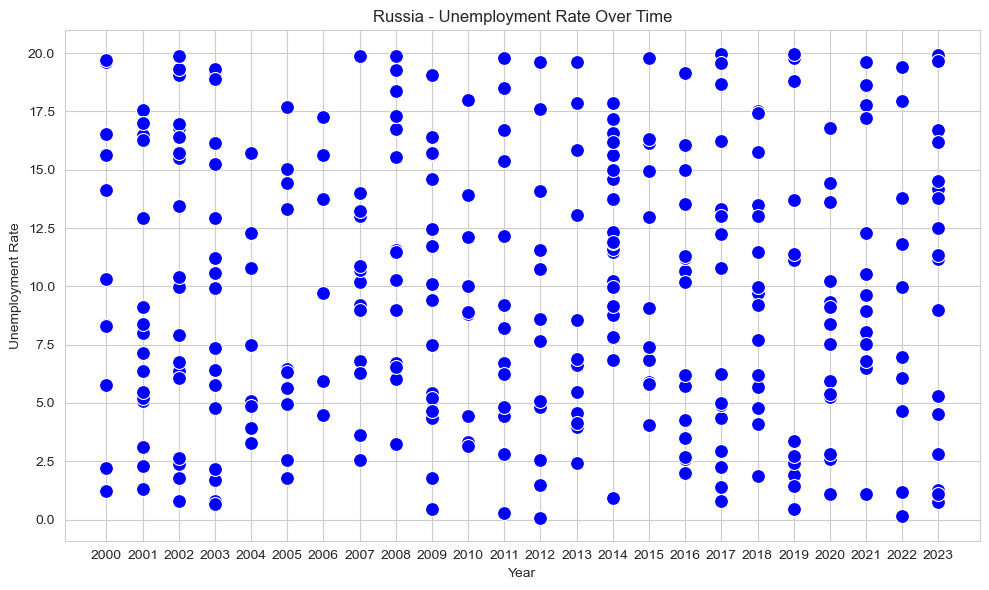

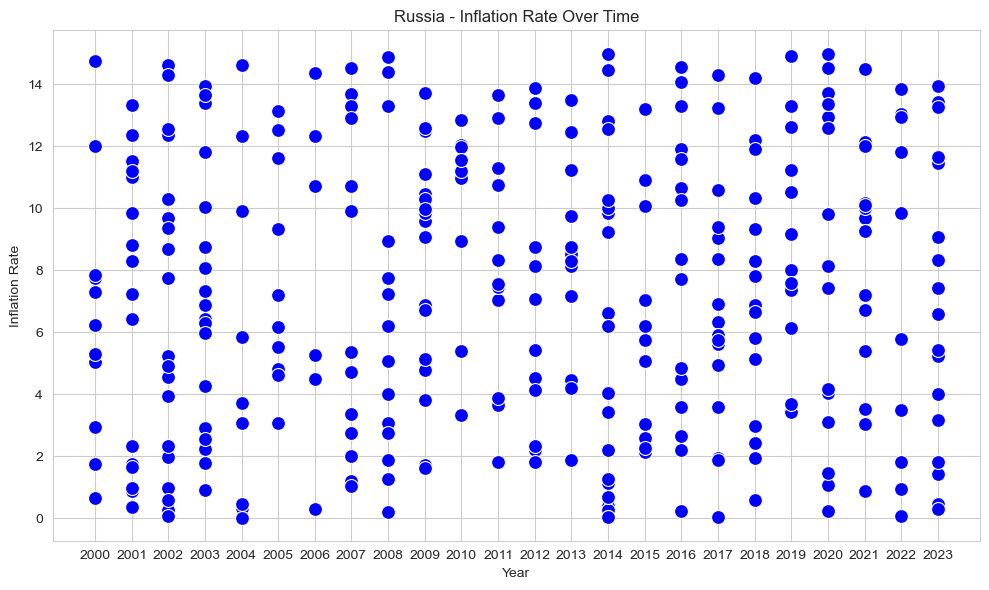

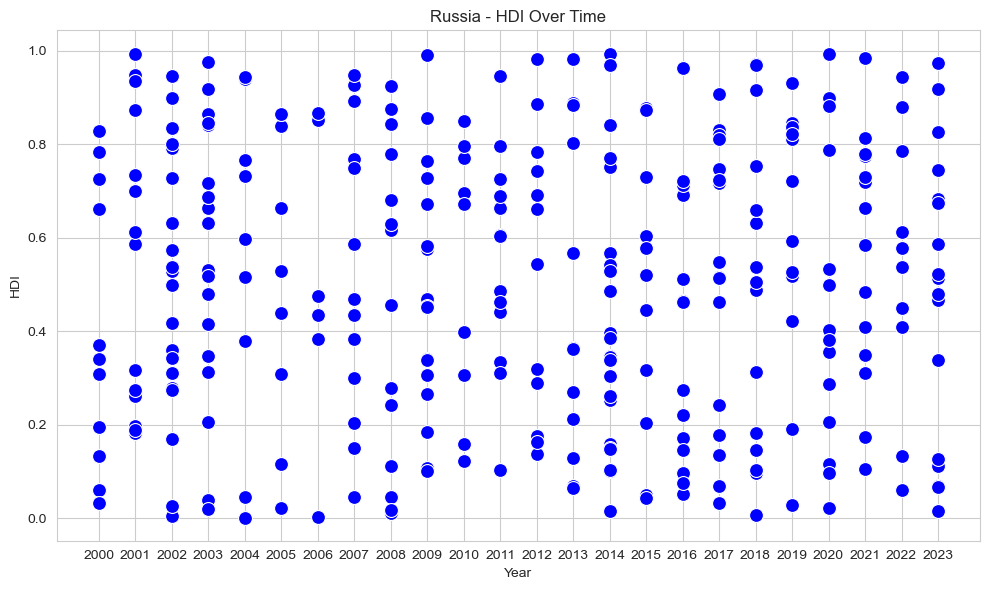

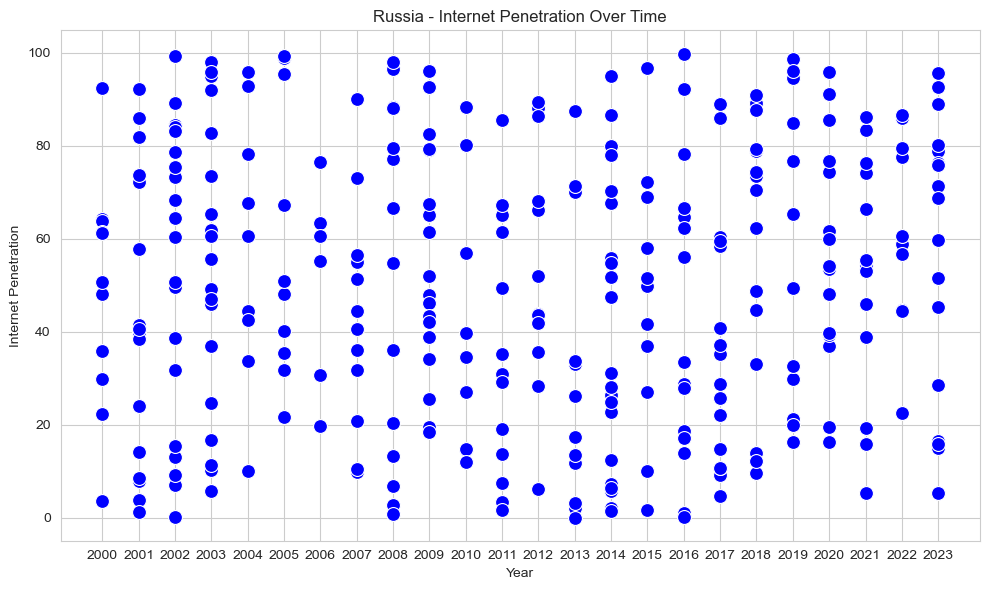

In [355]:
# Get unique countries
countries = df['Country'].unique()

# Define indicators of interest
indicators = [
    'GDP_per_Capita',
    'Unemployment_Rate',
    'Inflation_Rate',
    'HDI',
    'Internet_Penetration'
]

# Optional: Set style
sns.set_style("whitegrid")

# Loop through each country
for country in countries:
    country_data = df[df['Country'] == country]
    
    if country_data.empty:
        print(f"No data available for {country}. Skipping...")
        continue
    
    # Loop through each indicator and create a scatter plot
    for indicator in indicators:
        if indicator not in country_data.columns:
            print(f"Column '{indicator}' not found for {country}. Skipping...")
            continue
        
        plt.figure(figsize=(10, 6))
        
        # Create scatter plot
        sns.scatterplot(data=country_data, x='Year', y=indicator, color='blue', s=100)

        plt.title(f"{country} - {indicator.replace('_', ' ')} Over Time")
        plt.xlabel("Year")
        plt.ylabel(indicator.replace('_', ' '))
        plt.xticks(sorted(country_data['Year'].dropna().astype(int).unique()))
        plt.tight_layout()
        plt.grid(True)
        plt.show()

# 7️⃣ Development Indicators


## CPI vs Development Indicators



Development Indicators - Correlation with CPI:
CPI_Score               1.000000
HDI                     0.488066
Internet_Penetration    0.455107
Education_Corruption    0.324692
Health_Corruption       0.115907
Name: CPI_Score, dtype: float64


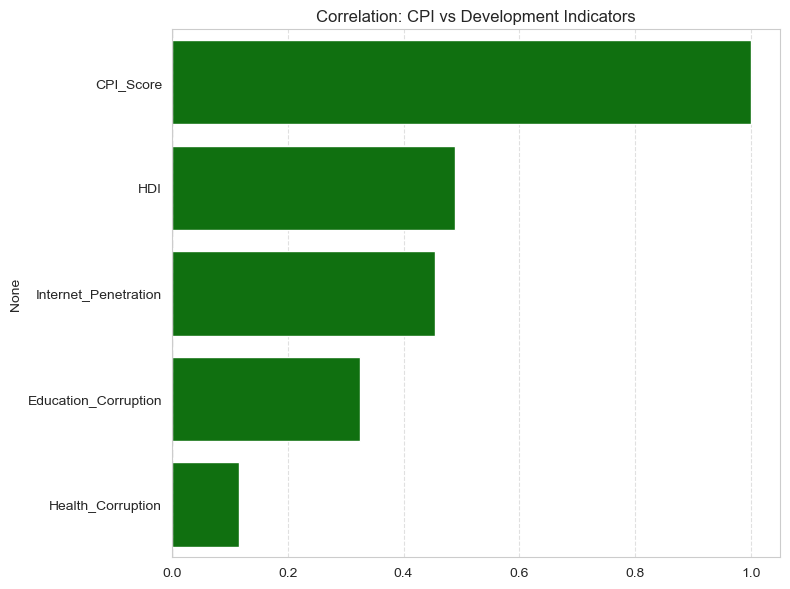

In [364]:
development_columns = ['HDI', 'Education_Corruption', 'Health_Corruption', 'Internet_Penetration']

correlations_development = compute_correlation(df_latest, development_columns)
print("Development Indicators - Correlation with CPI:")
print(correlations_development)

plot_correlation(correlations_development, "Correlation: CPI vs Development Indicators")

In [365]:
# Keep only the latest year's data per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

## Top 5 Countries

In [553]:
development_indicators = {
    'HDI': 'highest',
    'Education_Corruption': 'lowest',
    'Health_Corruption': 'lowest',
    'Internet_Penetration': 'highest'
}

results_dev = {}

for col, direction in development_indicators.items():
    if direction == 'highest':
        top = df_latest[['Country','Year', col]].sort_values(by=col, ascending=False).head(5)
    else:
        top = df_latest[['Country','Year', col]].sort_values(by=col).head(5)
    results_dev[col] = top
    print(f"\nTop 5 Countries - {col.replace('_', ' ')} ({direction} priority):")
    print(top.to_string(index=False))


Top 5 Countries - HDI (highest priority):
Country  Year      HDI
  Japan  2023 0.781844
 Brazil  2023 0.632544
  India  2023 0.568917
 France  2023 0.495976
 Russia  2023 0.466155

Top 5 Countries - Education Corruption (lowest priority):
Country  Year  Education_Corruption
  India  2023              1.112719
Germany  2023              2.839524
     UK  2023              3.962090
    USA  2023              4.470056
  Japan  2023              5.512500

Top 5 Countries - Health Corruption (lowest priority):
Country  Year  Health_Corruption
  India  2023           1.223395
 Brazil  2023           2.833630
 Russia  2023           3.922643
  Japan  2023           4.149588
    USA  2023           4.845459

Top 5 Countries - Internet Penetration (highest priority):
     Country  Year  Internet_Penetration
      France  2023             97.038304
South Africa  2023             95.561958
      Russia  2023             92.731339
       Japan  2023             88.669328
     Germany  2023       

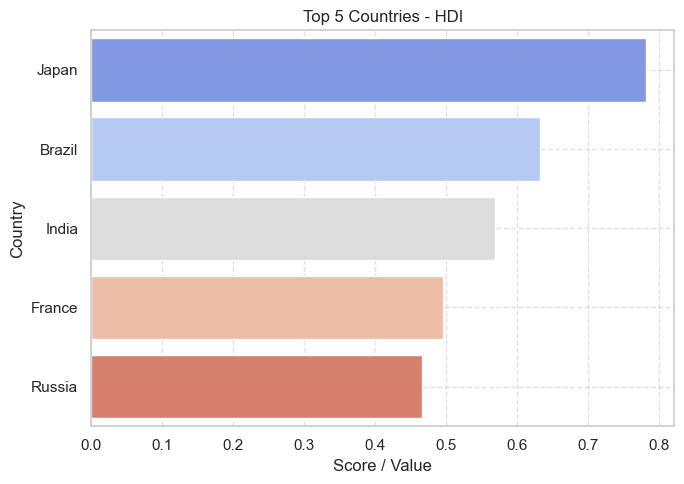

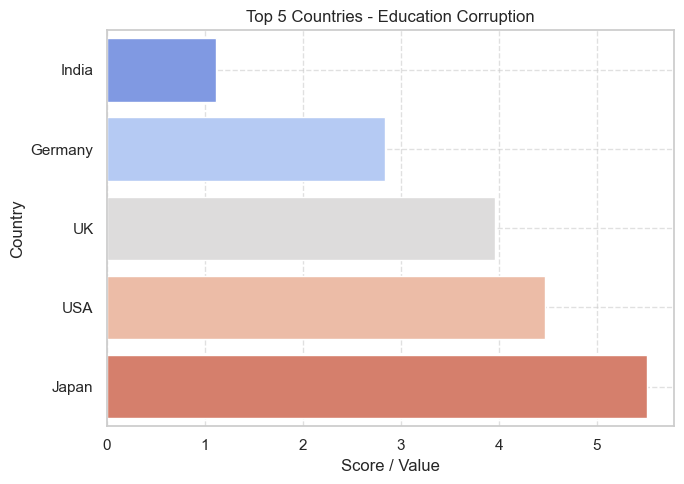

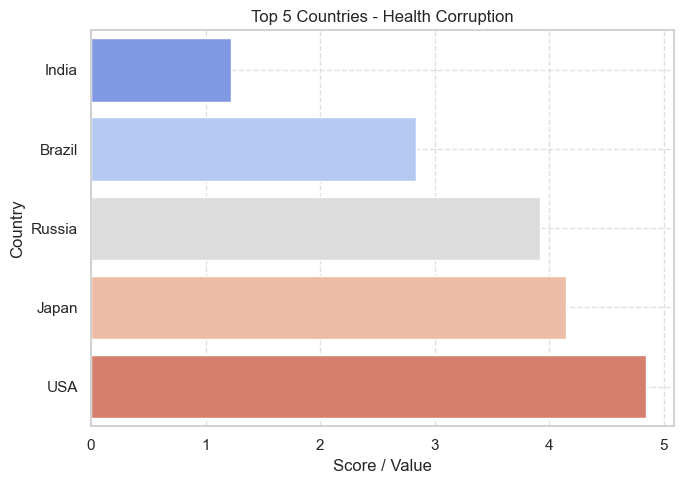

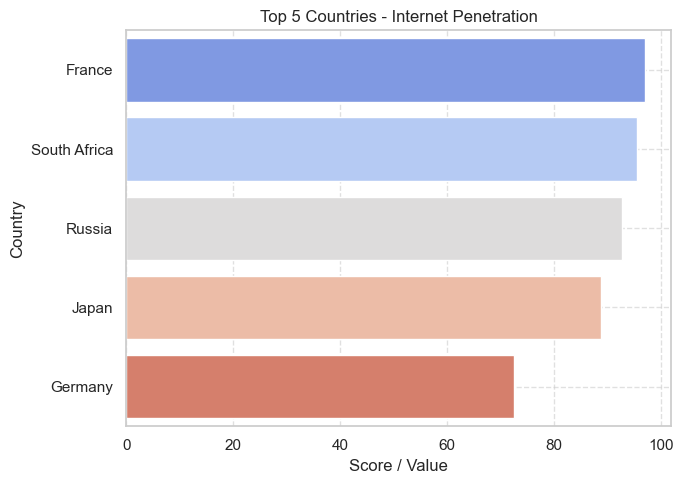

In [555]:
import matplotlib.pyplot as plt
import seaborn as sns

for col, _ in development_indicators.items():
    plt.figure(figsize=(7, 5))
    sns.barplot(data=results_dev[col], x=col, y='Country',hue='Country', palette="coolwarm")
    plt.title(f"Top 5 Countries - {col.replace('_', ' ')}")
    plt.xlabel("Score / Value")
    plt.ylabel("Country")
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\2685807027.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend if only one bar per country


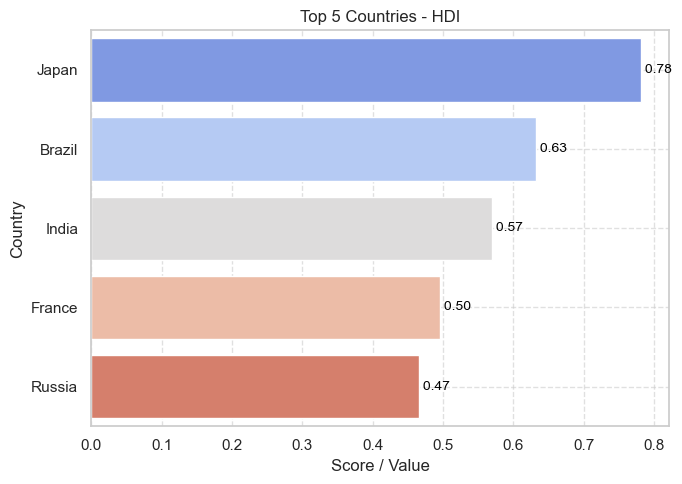

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\2685807027.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend if only one bar per country


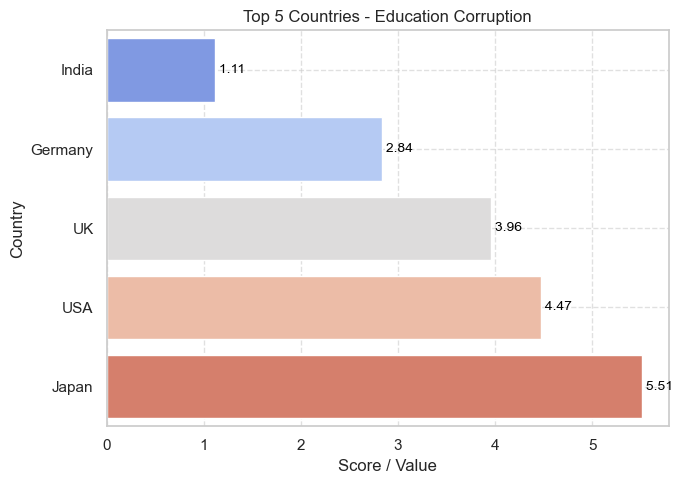

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\2685807027.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend if only one bar per country


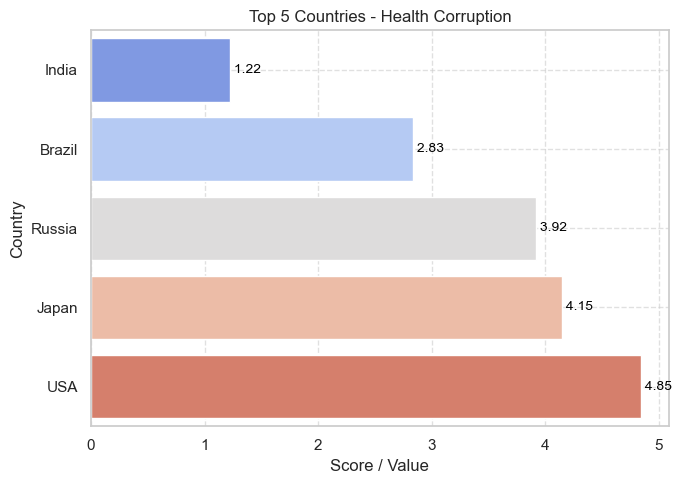

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\2685807027.py:17: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend if only one bar per country


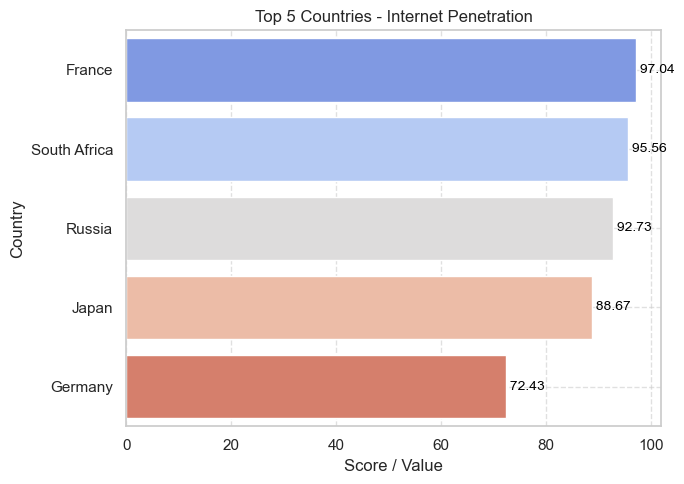

In [556]:
import matplotlib.pyplot as plt
import seaborn as sns

for col, _ in development_indicators.items():
    plt.figure(figsize=(7, 5))
    ax = sns.barplot(data=results_dev[col], x=col, y='Country', hue='Country', palette="coolwarm", dodge=False)
    
    # Add value labels to the right of each bar
    for i, (idx, row) in enumerate(results_dev[col].iterrows()):
        ax.text(row[col], i, f' {row[col]:.2f}', color='black', va='center', fontsize=10)

    plt.title(f"Top 5 Countries - {col.replace('_', ' ')}")
    plt.xlabel("Score / Value")
    plt.ylabel("Country")
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.legend().set_visible(False)  # Hide legend if only one bar per country
    plt.show()

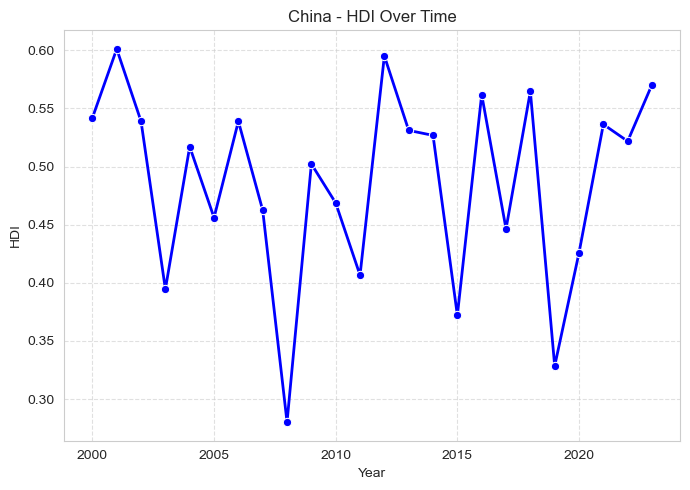

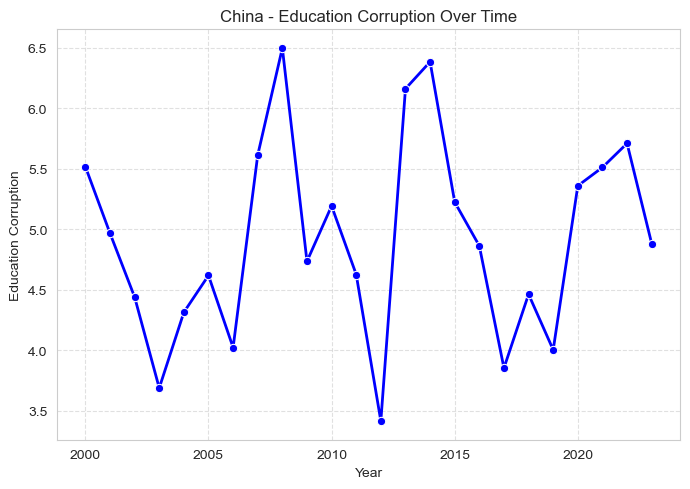

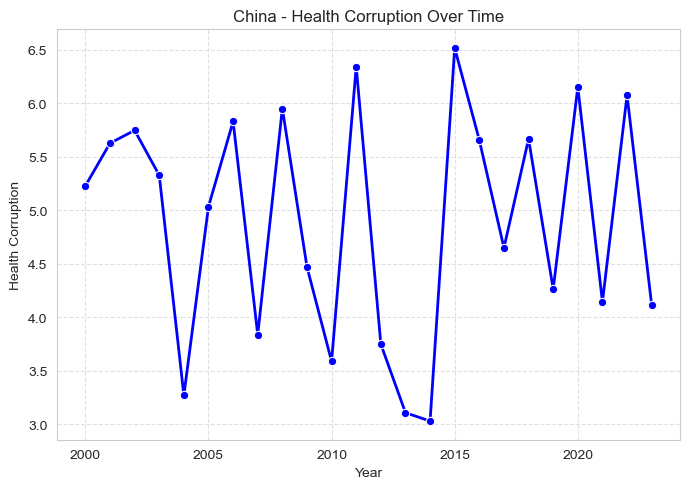

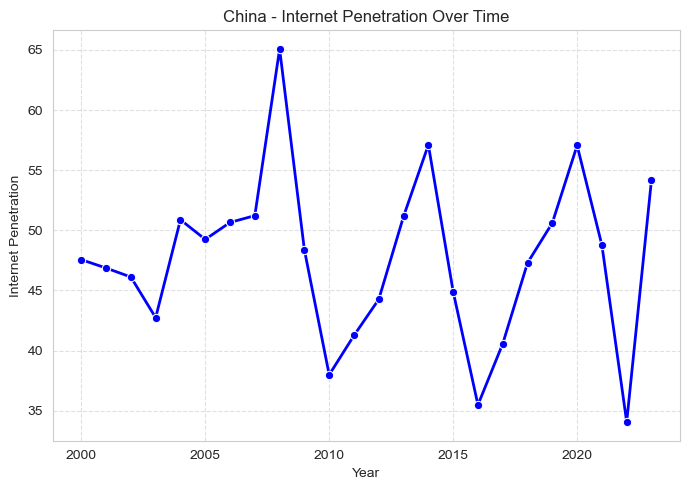

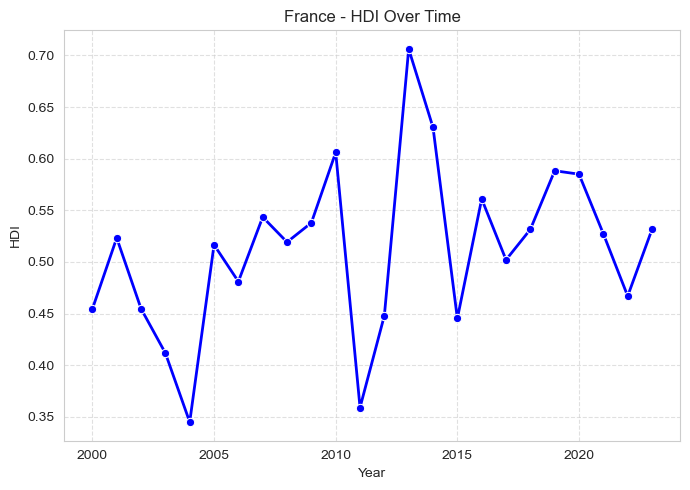

...

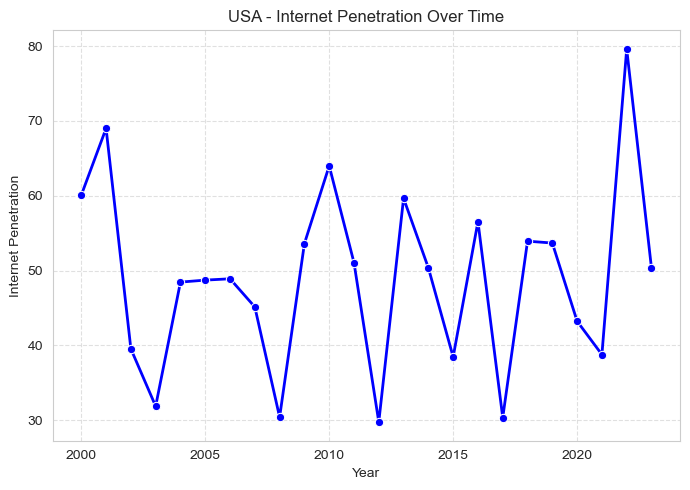

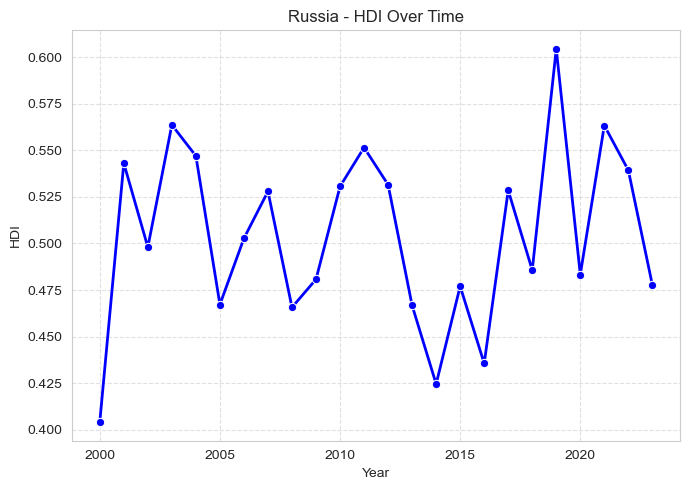

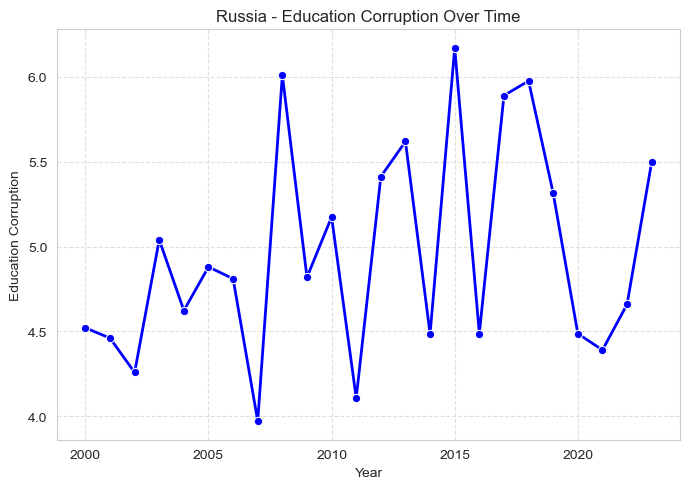

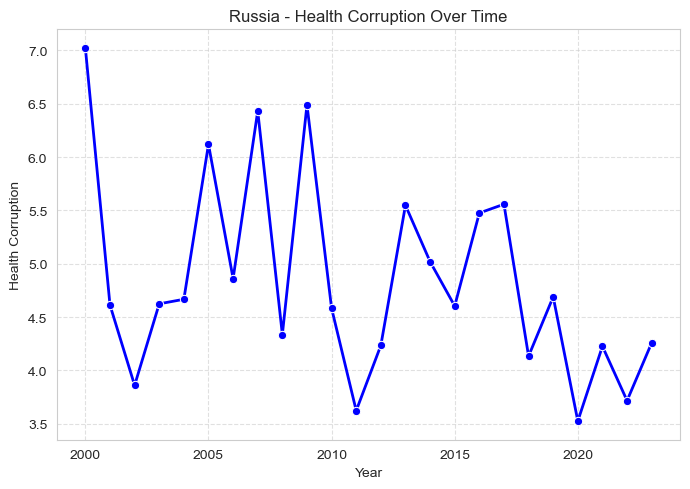

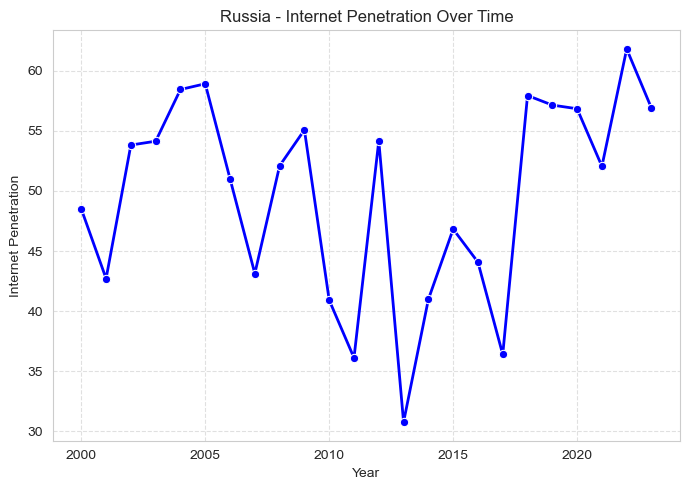

In [369]:
# Ensure Year is numeric
df['Year'] = pd.to_numeric(df['Year'], errors='coerce')

# Define development indicators
development_indicators = [
    'HDI',
    'Education_Corruption',
    'Health_Corruption',
    'Internet_Penetration'
]

# Get unique countries
countries = df['Country'].unique()

# Loop through each country
for country in countries:
    # Filter data for current country
    country_data = df[df['Country'] == country].sort_values(by='Year')
    
    if country_data.empty:
        print(f"No data available for {country}. Skipping...")
        continue

    # Loop through each indicator
    for indicator in development_indicators:
        if indicator not in country_data.columns:
            print(f"Indicator '{indicator}' missing for {country}.")
            continue
        
        # Skip rows with missing values
        plot_data = country_data[['Year', indicator]].dropna()
        
        if plot_data.empty:
            print(f"No valid data for {country} - {indicator}")
            continue

        # Create plot
        plt.figure(figsize=(7, 5))
        sns.lineplot(data=plot_data, x='Year', y=indicator, marker='o', color='blue', linewidth=2,errorbar=None)

        plt.title(f"{country} - {indicator.replace('_', ' ')} Over Time")
        plt.xlabel("Year")
        plt.ylabel(indicator.replace('_', ' '))
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.tight_layout()
        plt.show()

# 8 Governance & Institutional Quality

## CPI vs Development Indicators



Governance & Institutional Quality - Correlation with CPI:
CPI_Score                   1.000000
Government_Effectiveness    0.602997
Human_Rights_Index          0.525968
Regulatory_Quality          0.447755
Corporate_Governance        0.362788
Rule_of_Law                 0.221303
Foreign_Influence           0.198392
Transparency_Index          0.163640
Business_Corruption         0.077259
Bribery_Index               0.016401
Name: CPI_Score, dtype: float64


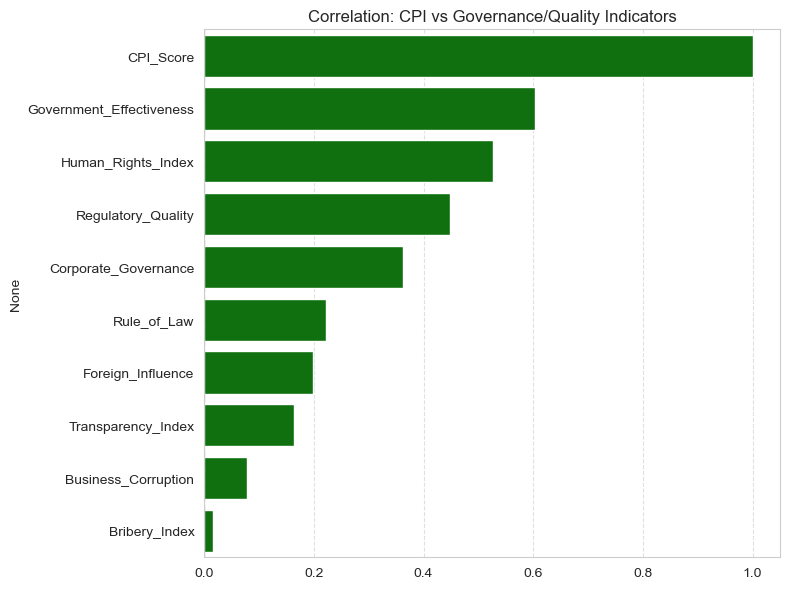

In [375]:
gov_columns = [
    'Regulatory_Quality', 'Rule_of_Law', 'Government_Effectiveness',
    'Human_Rights_Index', 'Corporate_Governance', 'Transparency_Index',
    'Foreign_Influence', 'Bribery_Index', 'Business_Corruption'
]

correlations_gov = compute_correlation(df_latest, gov_columns)
print("Governance & Institutional Quality - Correlation with CPI:")
print(correlations_gov)

plot_correlation(correlations_gov, "Correlation: CPI vs Governance/Quality Indicators")

In [376]:
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

## Top 5 Countries

In [378]:
for col in gov_columns:
    top = df_latest[['Country', 'Year',col]].sort_values(by=col, ascending=False).head(5)
    print(f"\nTop 5 Countries - {col.replace('_', ' ')}")
    print(top.to_string(index=False))


Top 5 Countries - Regulatory Quality
     Country  Year  Regulatory_Quality
      Brazil  2023            9.636566
       India  2023            9.519042
      Russia  2023            9.196455
South Africa  2023            6.219556
       China  2023            5.524652

Top 5 Countries - Rule of Law
Country  Year  Rule_of_Law
  Japan  2023     9.157495
  China  2023     8.207340
    USA  2023     6.036759
     UK  2023     4.507480
 France  2023     4.328399

Top 5 Countries - Government Effectiveness
Country  Year  Government_Effectiveness
  China  2023                  7.863575
 France  2023                  6.901729
     UK  2023                  5.444989
  Japan  2023                  2.691693
    USA  2023                  1.411002

Top 5 Countries - Human Rights Index
     Country  Year  Human_Rights_Index
      France  2023            7.456995
          UK  2023            7.179928
       Japan  2023            5.925869
South Africa  2023            4.291704
     Germany  2023

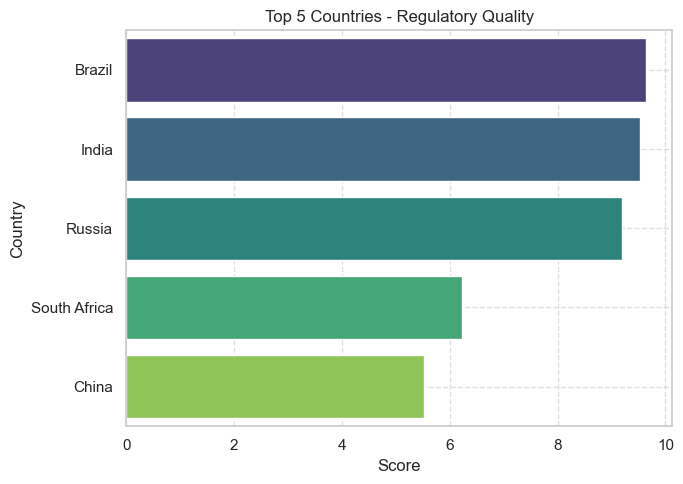

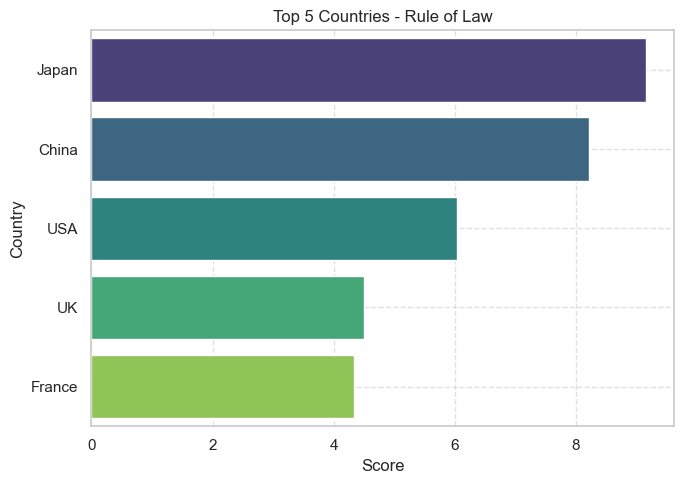

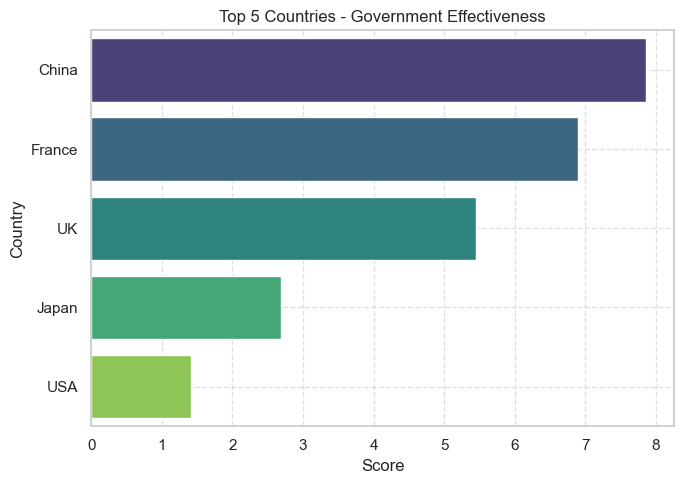

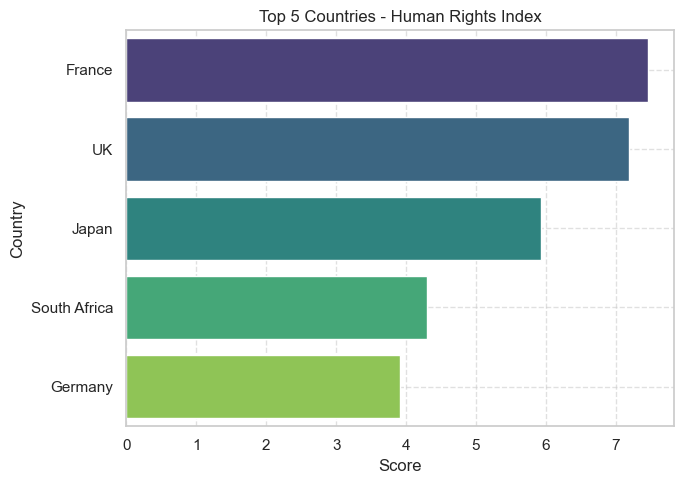

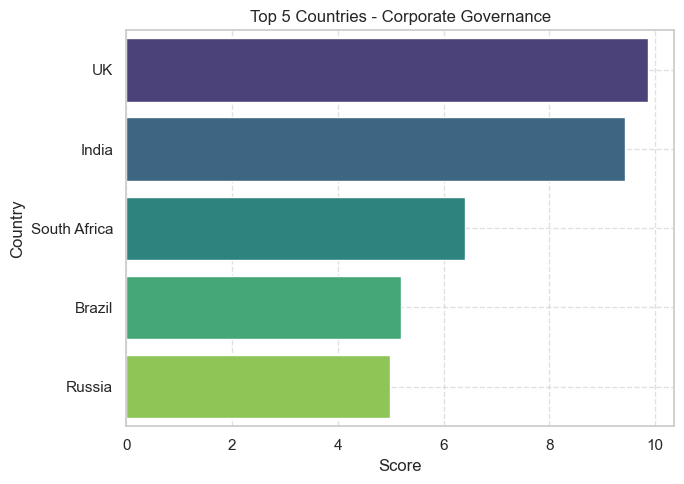

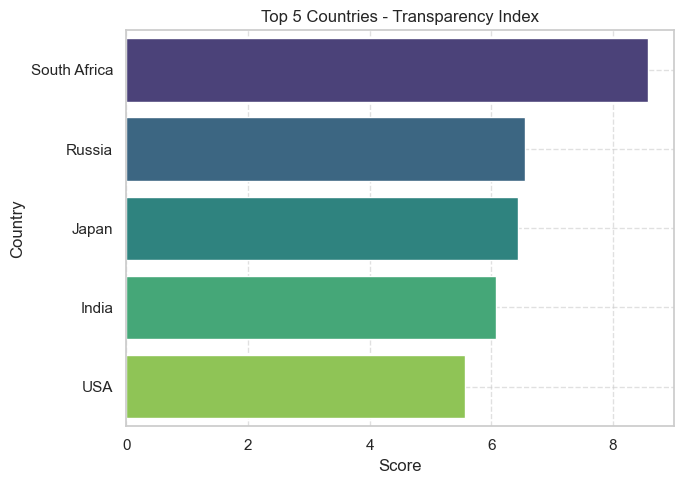

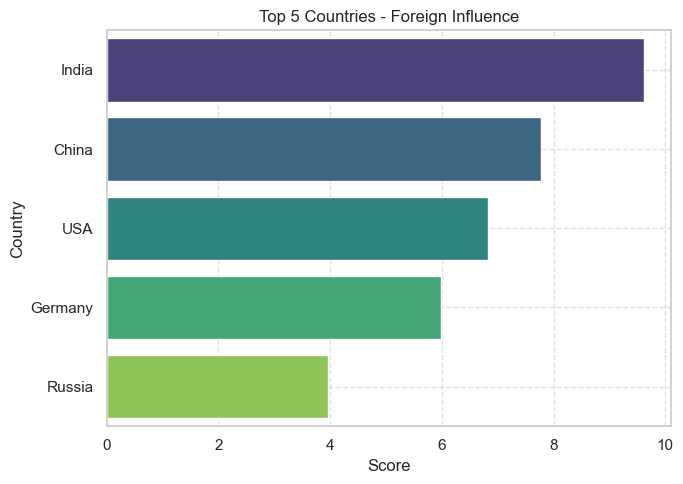

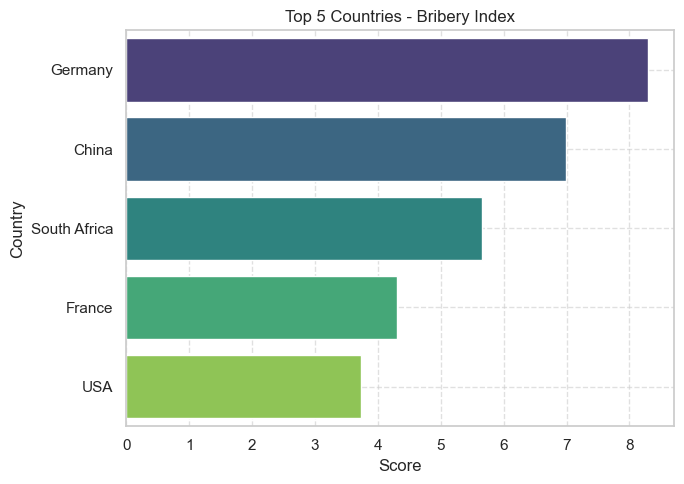

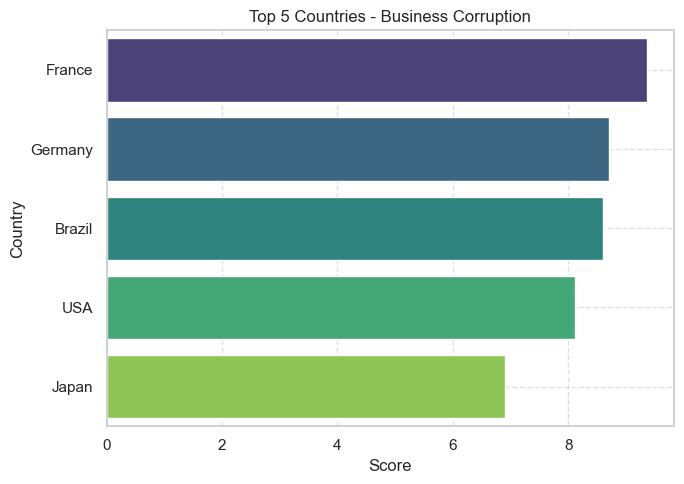

In [560]:
import matplotlib.pyplot as plt
import seaborn as sns

for col in gov_columns:
    plt.figure(figsize=(7, 5))
    top_data = df_latest[['Country', col]].sort_values(by=col, ascending=False).head(5)
    sns.barplot(data=top_data, x=col, y='Country',hue='Country', palette="viridis")
    plt.title(f"Top 5 Countries - {col.replace('_', ' ')}")
    plt.xlabel("Score")
    plt.ylabel("Country")
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3295016804.py:22: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since it's redundant here


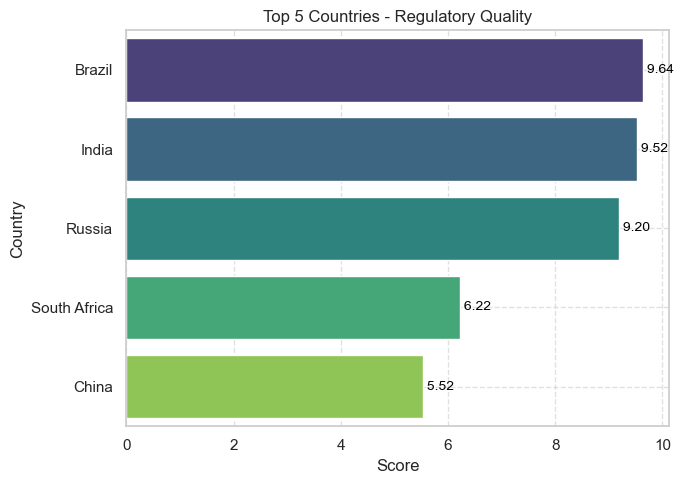

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3295016804.py:22: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since it's redundant here


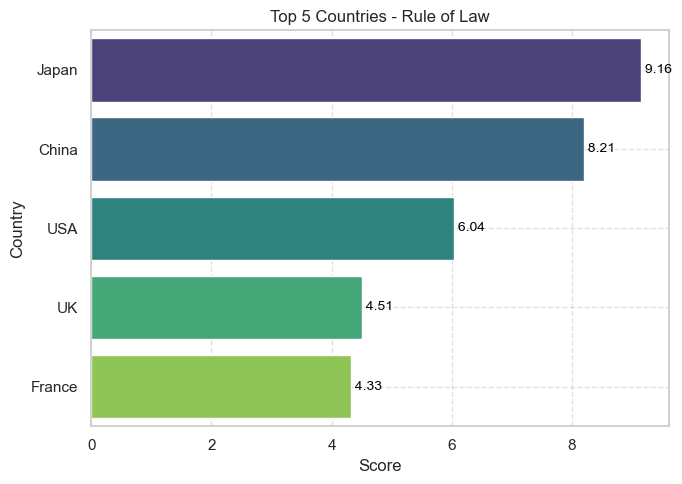

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3295016804.py:22: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since it's redundant here


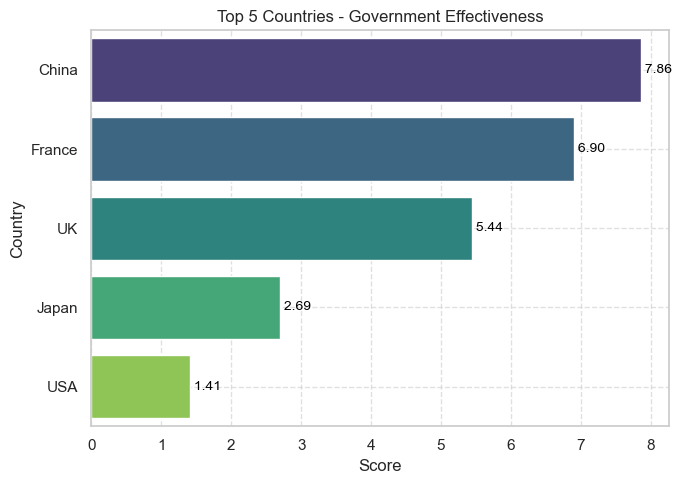

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3295016804.py:22: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since it's redundant here


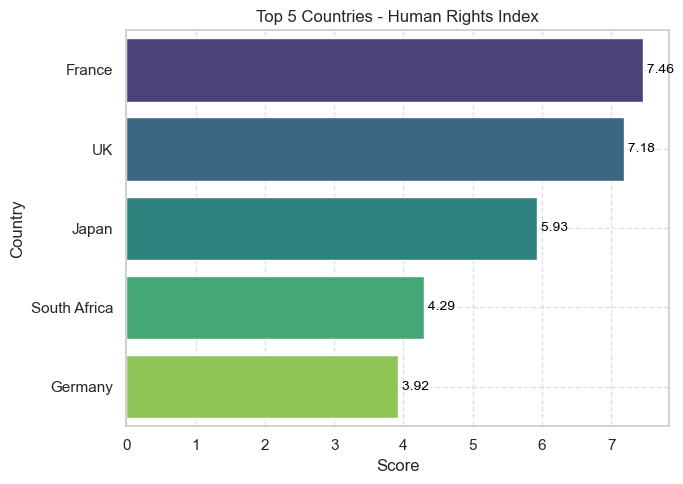

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3295016804.py:22: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since it's redundant here


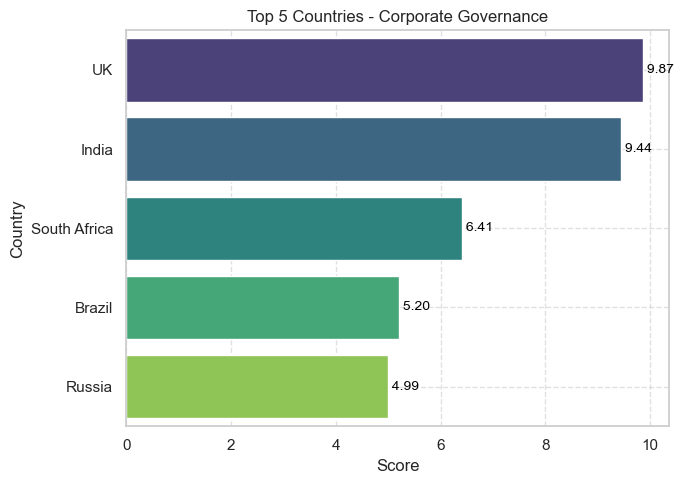

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3295016804.py:22: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since it's redundant here


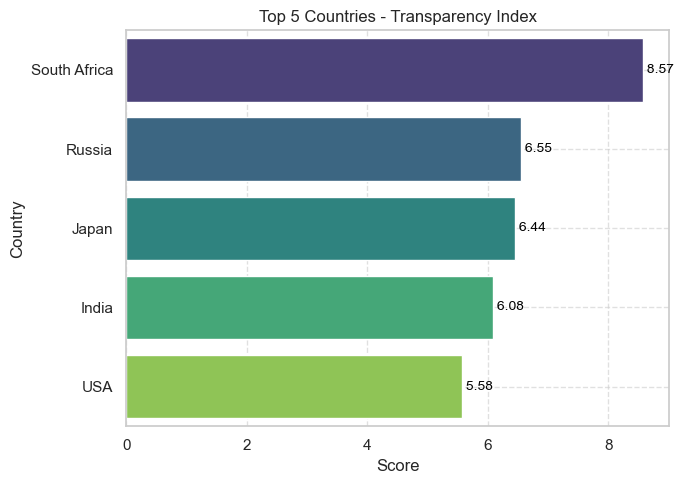

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3295016804.py:22: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since it's redundant here


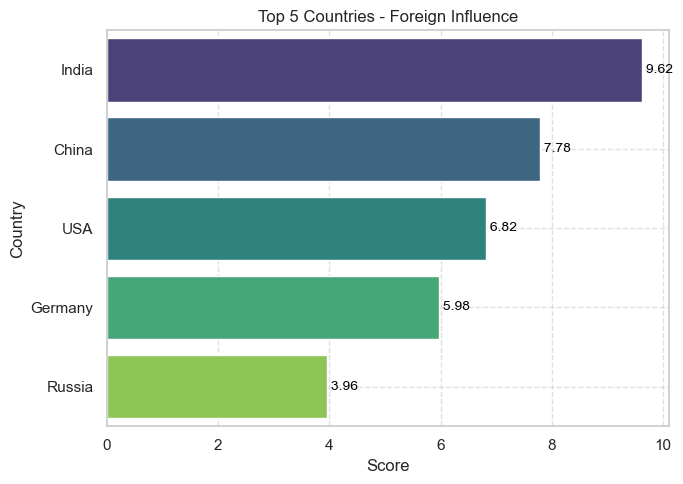

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3295016804.py:22: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since it's redundant here


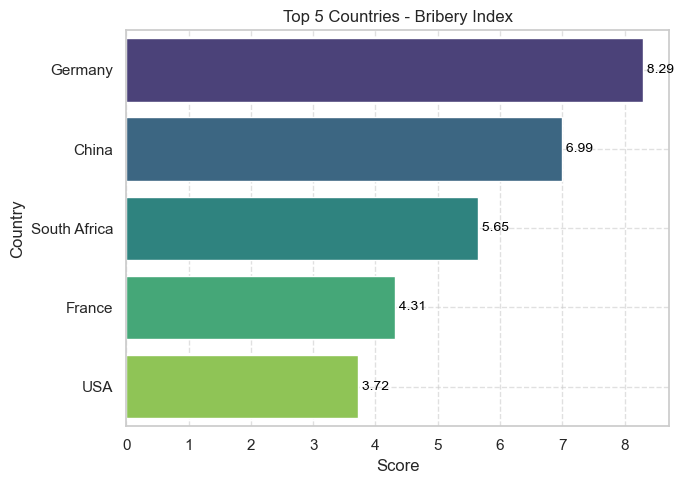

C:\Users\hp\AppData\Local\Temp\ipykernel_21268\3295016804.py:22: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend().set_visible(False)  # Hide legend since it's redundant here


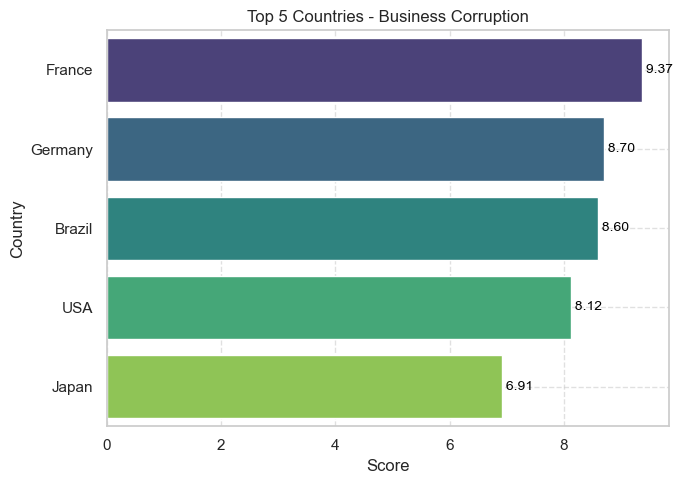

In [562]:
import matplotlib.pyplot as plt
import seaborn as sns

for col in gov_columns:
    # Get top 5 countries for current indicator
    top_data = df_latest[['Country', col]].sort_values(by=col, ascending=False).head(5)
    
    # Create plot
    plt.figure(figsize=(7, 5))
    ax = sns.barplot(data=top_data, x=col, y='Country', hue='Country', palette="viridis", dodge=False)

    # Add value labels to the right of each bar
    for i, (idx, row) in enumerate(top_data.iterrows()):
        ax.text(row[col], i, f' {row[col]:.2f}', color='black', va='center', fontsize=10)

    # Formatting
    plt.title(f"Top 5 Countries - {col.replace('_', ' ')}")
    plt.xlabel("Score")
    plt.ylabel("Country")
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.legend().set_visible(False)  # Hide legend since it's redundant here
    plt.show()

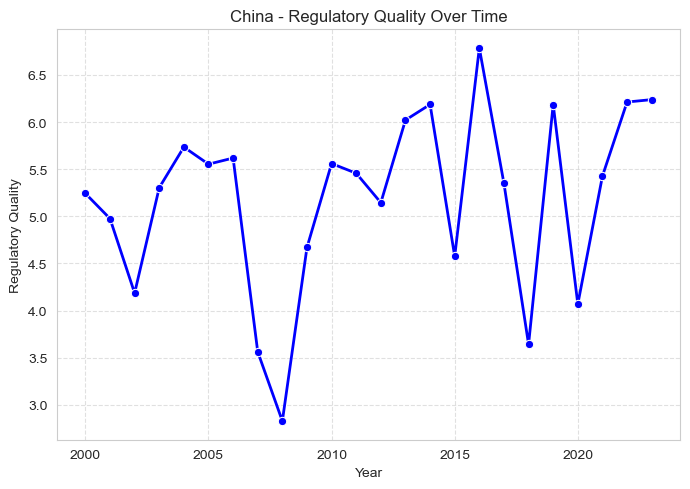

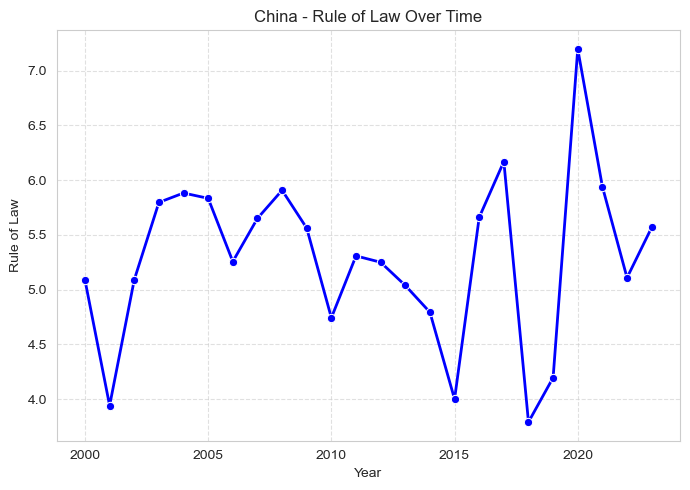

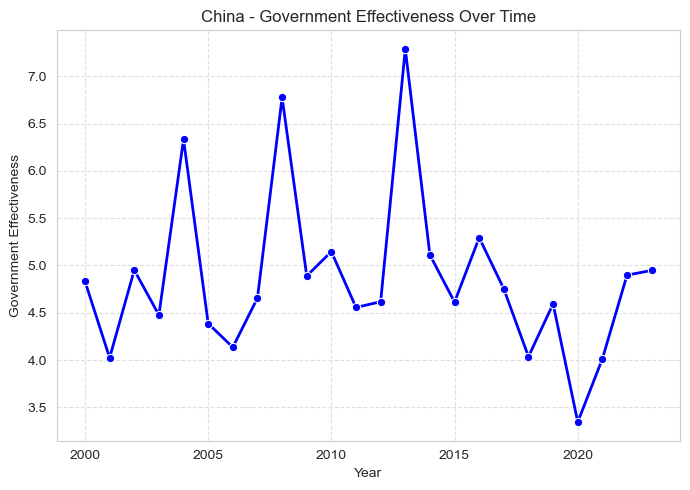

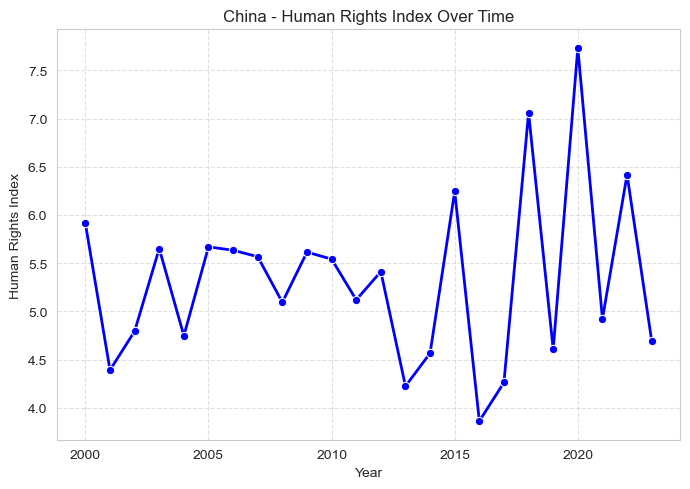

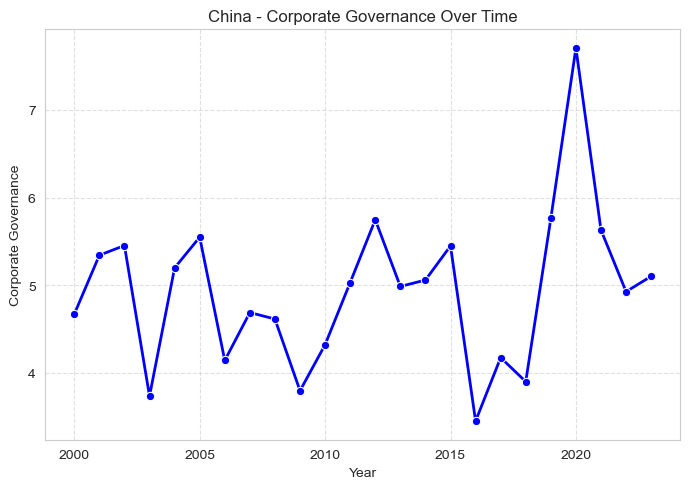

...

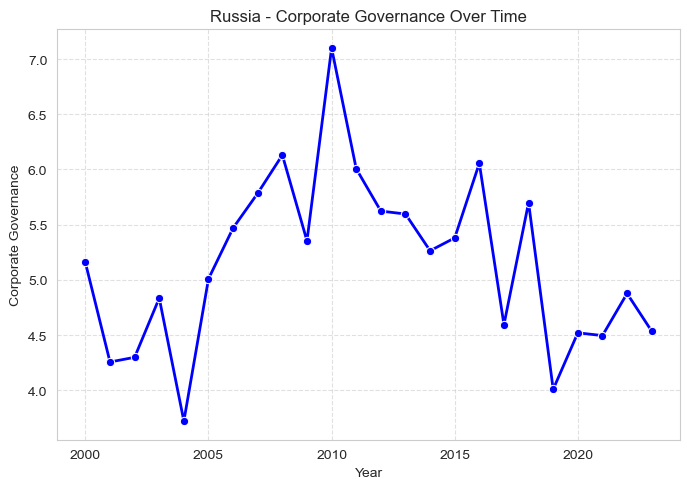

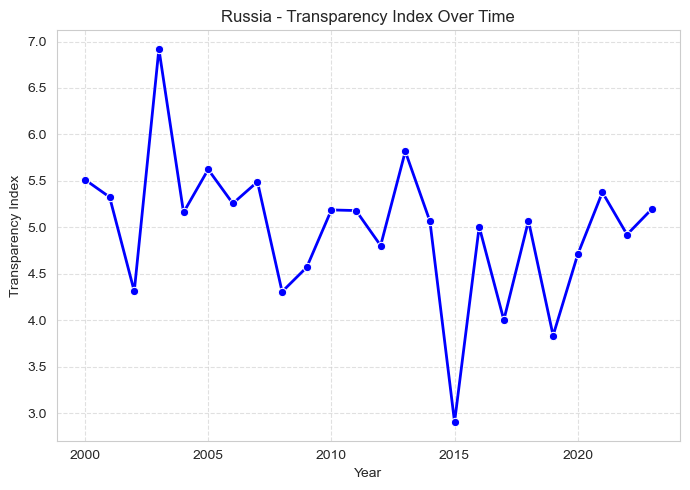

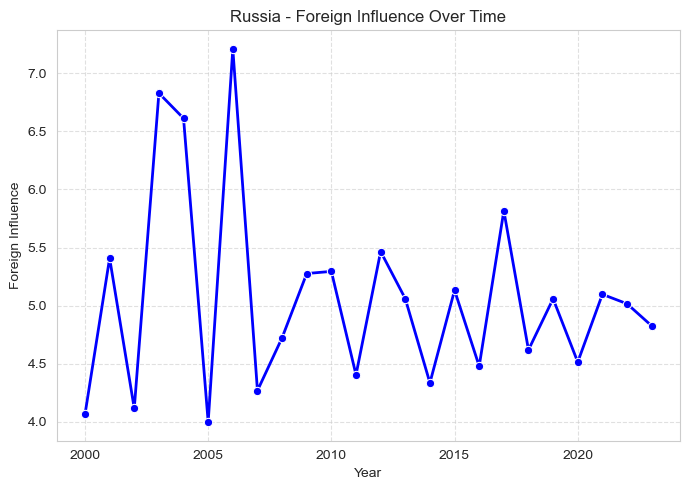

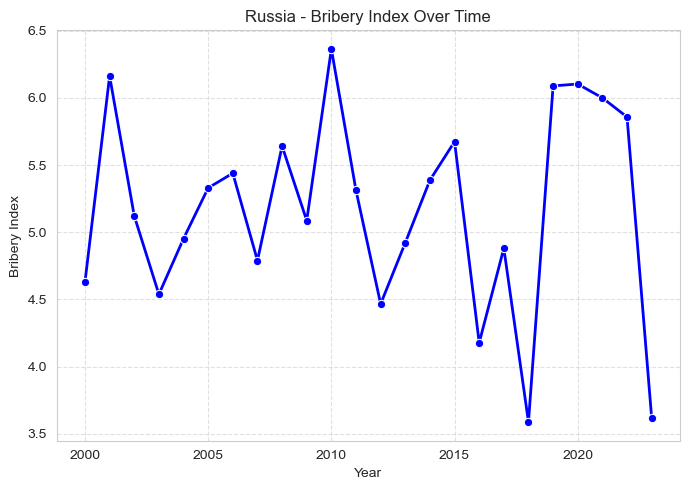

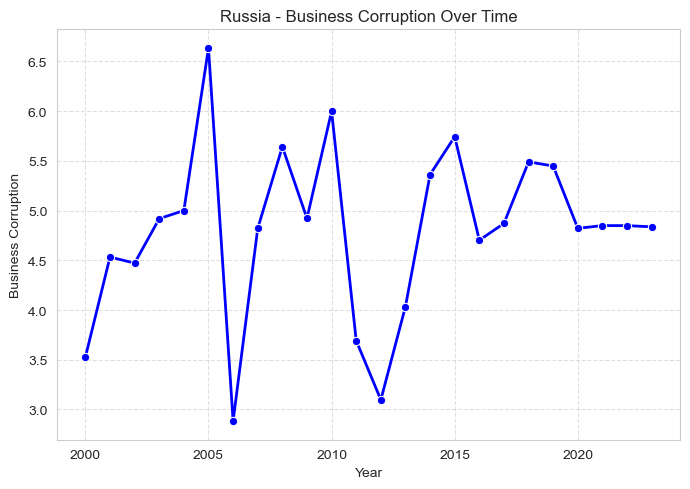

In [380]:
# Ensure Year is numeric
df['Year'] = pd.to_numeric(df['Year'], errors='coerce')

# Define government indicators
gov_columns = [
    'Regulatory_Quality', 'Rule_of_Law', 'Government_Effectiveness',
    'Human_Rights_Index', 'Corporate_Governance', 'Transparency_Index',
    'Foreign_Influence', 'Bribery_Index', 'Business_Corruption'
]

# Get unique countries
countries = df['Country'].unique()

# Loop through each country
for country in countries:
    # Filter data for current country
    country_data = df[df['Country'] == country].sort_values(by='Year')
    
    if country_data.empty:
        print(f"No data available for {country}. Skipping...")
        continue

    # Loop through each indicator
    for indicator in gov_columns:
        if indicator not in country_data.columns:
            print(f"Indicator '{indicator}' missing for {country}.")
            continue
        
        # Skip rows with missing values
        plot_data = country_data[['Year', indicator]].dropna()
        
        if plot_data.empty:
            print(f"No valid data for {country} - {indicator}")
            continue

        # Create plot
        plt.figure(figsize=(7, 5))
        sns.lineplot(data=plot_data, x='Year', y=indicator, marker='o', color='blue', linewidth=2,errorbar=None)
       
        plt.title(f"{country} - {indicator.replace('_', ' ')} Over Time")
        plt.xlabel("Year")
        plt.ylabel(indicator.replace('_', ' '))
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.tight_layout()
        plt.show()

# 🔹 VI. Advanced Insights


## 🔹Are democratic countries less corrupt?
Democracy is often associated with transparency, accountability, and reduced corruption due to checks and balances.




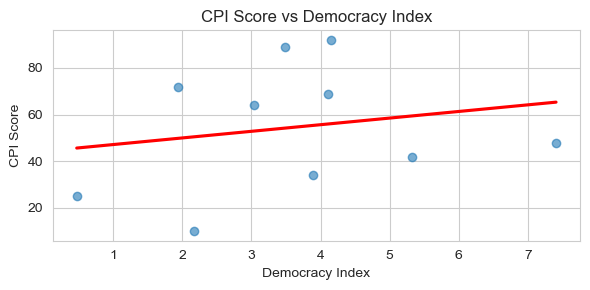

In [388]:
import seaborn as sns
import matplotlib.pyplot as plt

# Scatter plot without confidence interval band
plt.figure(figsize=(6, 3))
sns.regplot(
    data=df_latest,
    x='Democracy_Index',
    y='CPI_Score',
    scatter_kws={'alpha': 0.6},
    line_kws={'color': 'red'},
    ci=None  # This removes the shaded error band
)

plt.title("CPI Score vs Democracy Index")
plt.xlabel("Democracy Index")
plt.ylabel("CPI Score")
plt.grid(True)
plt.tight_layout()
plt.show()

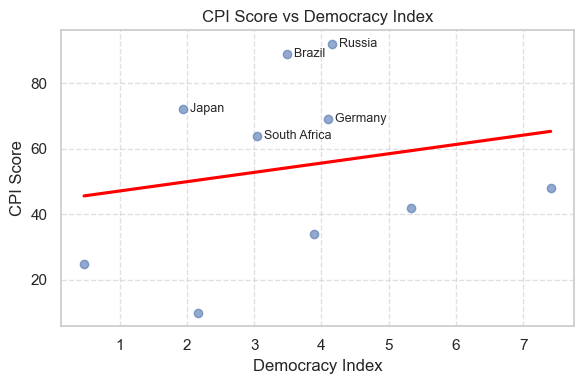

In [564]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot regression line with scatter points
plt.figure(figsize=(6, 4))
sns.regplot(
    data=df_latest,
    x='Democracy_Index',
    y='CPI_Score',
    scatter_kws={'alpha': 0.6},
    line_kws={'color': 'red'},
    ci=None  # No confidence interval
)

# Add country labels for top CPI countries
top_countries = df_latest.sort_values('CPI_Score', ascending=False).head(5)
for _, row in top_countries.iterrows():
    plt.text(row['Democracy_Index'], row['CPI_Score'], f"  {row['Country']}",
             fontsize=9, va='center', ha='left')

# Formatting
plt.title("CPI Score vs Democracy Index")
plt.xlabel("Democracy Index")
plt.ylabel("CPI Score")
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

## 🔹Does HDI correlate with perceived corruption?
Higher human development (education, health, income) may lead to better governance and lower corruption.



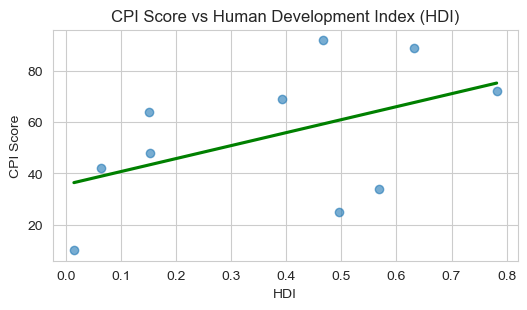

Correlation between HDI and CPI Score: 0.49


In [390]:
# Scatter plot with regression fit
plt.figure(figsize=(6, 3))
sns.regplot(
    data=df_latest,
    x='HDI',
    y='CPI_Score',
    scatter_kws={'alpha': 0.6},
    line_kws={'color': 'green'},
    ci=None
)
plt.title("CPI Score vs Human Development Index (HDI)")
plt.xlabel("HDI")
plt.ylabel("CPI Score")
plt.grid(True)
plt.show()

# Correlation value
correlation = df_latest[['HDI', 'CPI_Score']].corr().iloc[0,1]
print(f"Correlation between HDI and CPI Score: {correlation:.2f}")

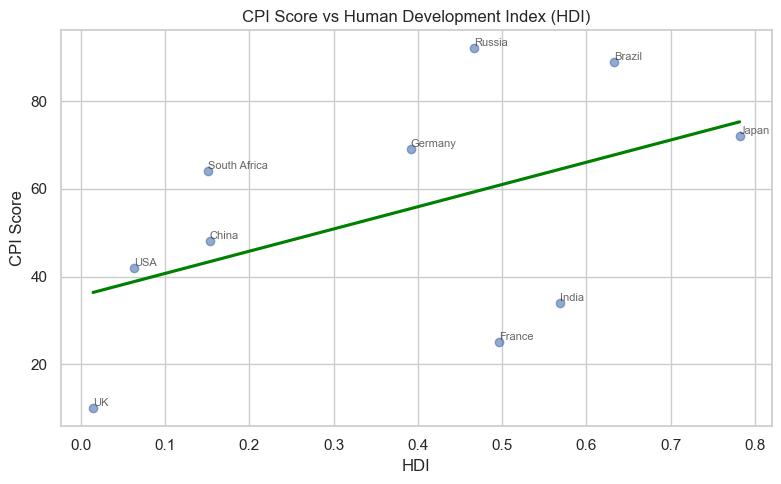

Correlation between HDI and CPI Score: 0.49


In [568]:
plt.figure(figsize=(8, 5))
ax = sns.regplot(
    data=df_latest,
    x='HDI',
    y='CPI_Score',
    scatter_kws={'alpha': 0.6},
    line_kws={'color': 'green'},
    ci=None
)

# ✅ Add country names next to each point
for i, row in df_latest.iterrows():
    plt.text(
        row['HDI'], row['CPI_Score'], row['Country'],
        fontsize=8, alpha=0.7, ha='left', va='bottom'
    )

plt.title("CPI Score vs Human Development Index (HDI)")
plt.xlabel("HDI")
plt.ylabel("CPI Score")
plt.grid(True)
plt.tight_layout()
plt.show()

# ✅ Correlation
correlation = df_latest[['HDI', 'CPI_Score']].corr().iloc[0, 1]
print(f"Correlation between HDI and CPI Score: {correlation:.2f}")


# 🔹 VII. Outlier & Anomaly Detection


## Which countries are outliers in terms of corruption despite high GDP?
 Why: High GDP doesn’t always mean low corruption—identify anomalies.


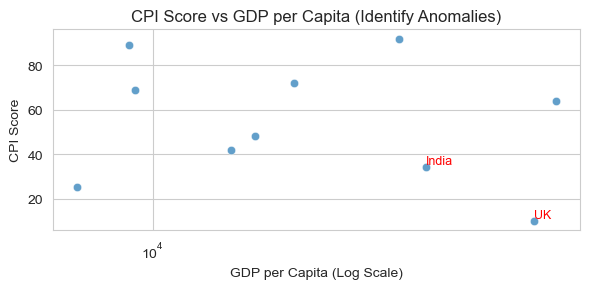

Outlier Countries (High GDP, Low CPI):
   Country  GDP_per_Capita  CPI_Score
20   India           35448         34
97      UK           58491         10


In [393]:
# Keep latest year per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

# Drop missing values
df_clean = df_latest.dropna(subset=['GDP_per_Capita', 'CPI_Score'])

# Plot scatter
plt.figure(figsize=(6, 3))
sns.scatterplot(data=df_clean, x='GDP_per_Capita', y='CPI_Score', alpha=0.7)

# Optional: Log scale for better visualization
plt.xscale('log')
plt.xlabel("GDP per Capita (Log Scale)")
plt.ylabel("CPI Score")
plt.title("CPI Score vs GDP per Capita (Identify Anomalies)")

# Annotating potential outliers
# Define threshold for high GDP and low CPI (e.g., top 25% GDP, bottom 25% CPI)
gdp_threshold = np.percentile(df_clean['GDP_per_Capita'], 75)
cpi_threshold = np.percentile(df_clean['CPI_Score'], 25)

# Find outliers
outliers = df_clean[(df_clean['GDP_per_Capita'] > gdp_threshold) & (df_clean['CPI_Score'] < cpi_threshold)]

# Annotating each outlier
for i, row in outliers.iterrows():
    plt.text(row['GDP_per_Capita'], row['CPI_Score'], row['Country'],
             fontsize=9, ha='left', va='bottom', color='red')

# Show plot
plt.grid(True)
plt.tight_layout()
plt.show()

# Print list of outliers
print("Outlier Countries (High GDP, Low CPI):")
print(outliers[['Country', 'GDP_per_Capita', 'CPI_Score']])

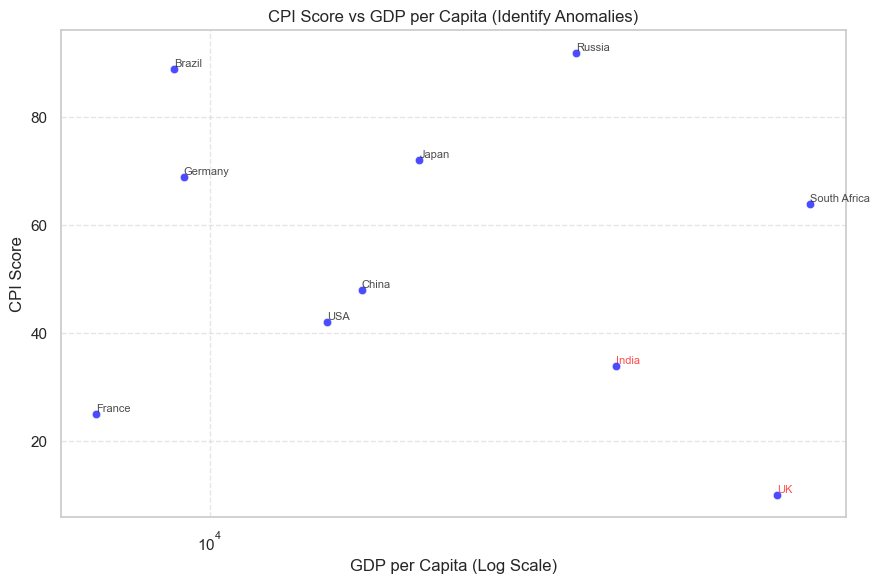


Outlier Countries (High GDP, Low CPI):
   Country  GDP_per_Capita  CPI_Score
20   India           35448         34
97      UK           58491         10


In [570]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Keep latest year per country
df_latest = df.loc[df.groupby('Country')['Year'].idxmax()]

# Drop missing values
df_clean = df_latest.dropna(subset=['GDP_per_Capita', 'CPI_Score'])

# Plot scatter
plt.figure(figsize=(9, 6))
sns.scatterplot(
    data=df_clean,
    x='GDP_per_Capita',
    y='CPI_Score',
    alpha=0.7,
    color='blue'
)

# Log scale for better visualization
plt.xscale('log')
plt.xlabel("GDP per Capita (Log Scale)")
plt.ylabel("CPI Score")
plt.title("CPI Score vs GDP per Capita (Identify Anomalies)")

# Thresholds for outliers
gdp_threshold = np.percentile(df_clean['GDP_per_Capita'], 75)
cpi_threshold = np.percentile(df_clean['CPI_Score'], 25)

# Find outliers
outliers = df_clean[(df_clean['GDP_per_Capita'] > gdp_threshold) & (df_clean['CPI_Score'] < cpi_threshold)]

# Annotate **all** countries (optional: limit to important if cluttered)
for i, row in df_clean.iterrows():
    color = 'red' if row['Country'] in outliers['Country'].values else 'black'
    plt.text(
        row['GDP_per_Capita'],
        row['CPI_Score'],
        row['Country'],
        fontsize=8,
        alpha=0.7,
        ha='left',
        va='bottom',
        color=color
    )

plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

# Print list of outliers
print("\nOutlier Countries (High GDP, Low CPI):")
print(outliers[['Country', 'GDP_per_Capita', 'CPI_Score']])


# 🧩 A1. How do different sectors contribute to corruption perception?
Why: Explore which types of corruption are most severe.

In [396]:
# Define core corruption metrics
core_corruption_metrics = [
    'Public_Sector_Corruption', 'Judicial_Corruption', 'Police_Corruption',
    'Executive_Branch_Corruption', 'Legislative_Corruption', 'Bribery_Index',
    'Business_Corruption', 'Health_Corruption', 'Education_Corruption',
    'Media_Corruption', 'Political_Party_Corruption', 'Foreign_Influence'
]

# Clean data for parallel coordinates plot
df_top_bottom = pd.concat([
    df_latest.nlargest(5, 'CPI_Score')[['Country', *core_corruption_metrics]],
    df_latest.nsmallest(5, 'CPI_Score')[['Country', *core_corruption_metrics]]
])

# Add Type column
df_top_bottom['Type'] = ['Least Corrupt']*5 + ['Most Corrupt']*5

# Ensure all corruption metric columns are float type
df_top_bottom[core_corruption_metrics] = df_top_bottom[core_corruption_metrics].apply(pd.to_numeric, errors='coerce')

# Reset index (optional)
df_top_bottom = df_top_bottom.reset_index(drop=True)

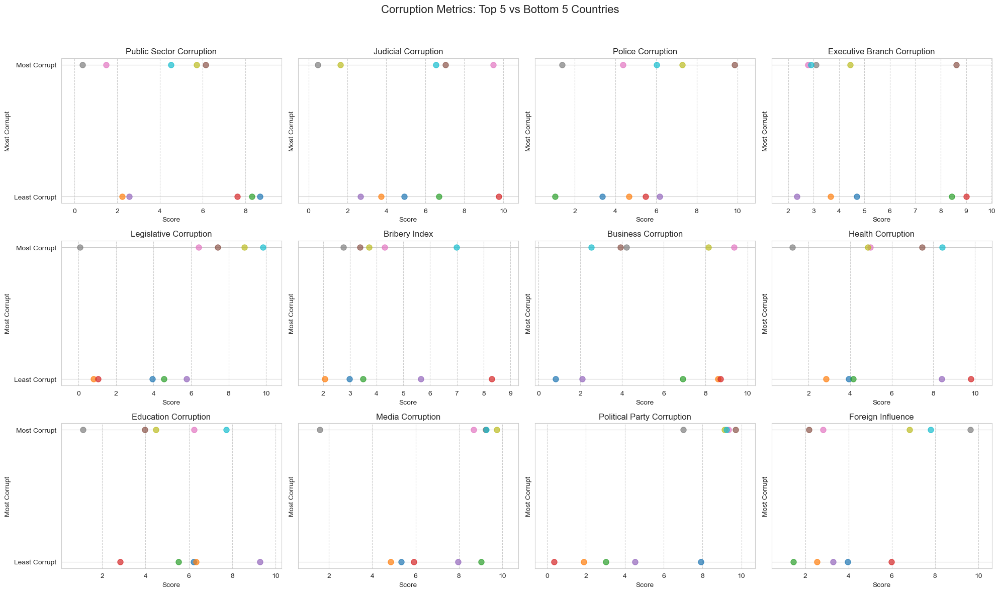

In [397]:
import matplotlib.pyplot as plt
from pandas.plotting import parallel_coordinates

# Assume df_top_bottom is already defined with 'Type' column ('Most Corrupt', 'Least Corrupt')

# List of corruption metrics
core_corruption_metrics = [
    'Public_Sector_Corruption', 'Judicial_Corruption', 'Police_Corruption',
    'Executive_Branch_Corruption', 'Legislative_Corruption', 'Bribery_Index',
    'Business_Corruption', 'Health_Corruption', 'Education_Corruption',
    'Media_Corruption', 'Political_Party_Corruption', 'Foreign_Influence'
]

# Filter only relevant columns and drop missing values
plot_data = df_top_bottom[['Country', 'Type'] + core_corruption_metrics].dropna()

# Set up subplot grid (adjust rows/columns based on number of metrics)
n_metrics = len(core_corruption_metrics)
n_cols = 4
n_rows = (n_metrics + n_cols - 1) // n_cols  # Ceiling division

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows), sharey=True)
axes = axes.flatten()  # Flatten to iterate easily

# Loop through each corruption metric and create subplot
for i, metric in enumerate(core_corruption_metrics):
    ax = axes[i]
    
    # Subset data for this metric
    metric_data = plot_data[['Country', 'Type', metric]]
    
    # Plot lines per country
    for _, row in metric_data.iterrows():
        ax.plot([row[metric]], [row['Type']], marker='o', linestyle='', markersize=8,
                label=row['Country'], alpha=0.7)
    
    # Customize subplot
    ax.set_title(metric.replace('_', ' '))
    ax.set_xlabel("Score")
    ax.set_ylabel(row['Type'])  # Optional: show type labels
    ax.grid(True, axis='x', linestyle='--')
    ax.set_yticks(['Least Corrupt', 'Most Corrupt'])
    ax.set_xlim(metric_data[metric].min() - 1, metric_data[metric].max() + 1)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle("Corruption Metrics: Top 5 vs Bottom 5 Countries", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

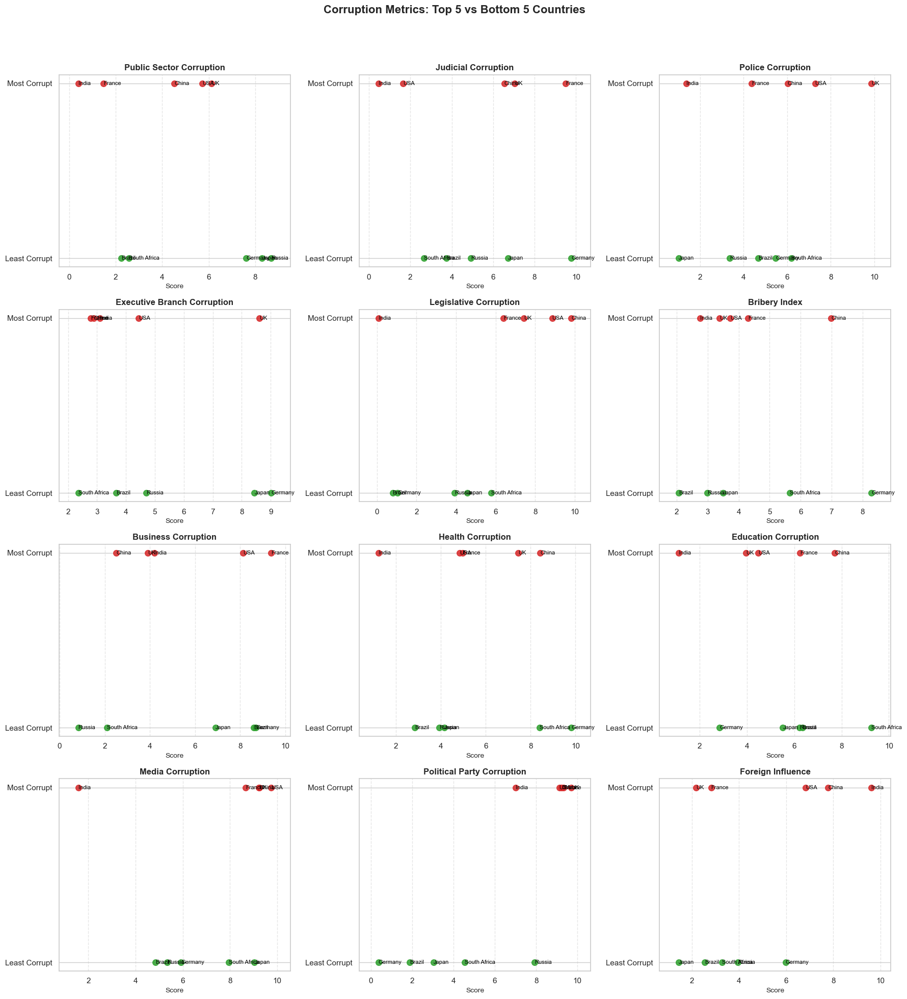

In [583]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Corruption metrics to visualize
core_corruption_metrics = [
    'Public_Sector_Corruption', 'Judicial_Corruption', 'Police_Corruption',
    'Executive_Branch_Corruption', 'Legislative_Corruption', 'Bribery_Index',
    'Business_Corruption', 'Health_Corruption', 'Education_Corruption',
    'Media_Corruption', 'Political_Party_Corruption', 'Foreign_Influence'
]

# Prepare data (assumes df_top_bottom exists with 'Country', 'Type', and metrics columns)
plot_data = df_top_bottom[['Country', 'Type'] + core_corruption_metrics].dropna()

# Subplot configuration
n_metrics = len(core_corruption_metrics)
n_cols = 3
n_rows = (n_metrics + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows))
axes = axes.flatten()

# Color map for 'Type'
type_colors = {'Most Corrupt': '#d62728', 'Least Corrupt': '#2ca02c'}

# Plot each metric
for i, metric in enumerate(core_corruption_metrics):
    ax = axes[i]
    metric_data = plot_data[['Country', 'Type', metric]]

    # Scatter plot of countries
    for _, row in metric_data.iterrows():
        ax.scatter(row[metric], row['Type'], 
                   color=type_colors[row['Type']], s=70, alpha=0.85)
        ax.text(row[metric], row['Type'], row['Country'],
                fontsize=8, ha='left', va='center', color='black')

    # Formatting the subplot
    ax.set_title(metric.replace('_', ' '), fontsize=12, weight='bold')
    ax.set_xlabel("Score", fontsize=10)
    ax.set_ylabel("")  # Y-label is self-explanatory by the text
    ax.set_yticks(['Least Corrupt', 'Most Corrupt'])
    ax.grid(True, axis='x', linestyle='--', alpha=0.5)

    # Adjust x-axis limits for spacing
    metric_min, metric_max = metric_data[metric].min(), metric_data[metric].max()
    margin = (metric_max - metric_min) * 0.1 if metric_max != metric_min else 1
    ax.set_xlim(metric_min - margin, metric_max + margin)

# Remove unused axes if any
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Overall title and layout
plt.suptitle("Corruption Metrics: Top 5 vs Bottom 5 Countries", fontsize=16, weight='bold')
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


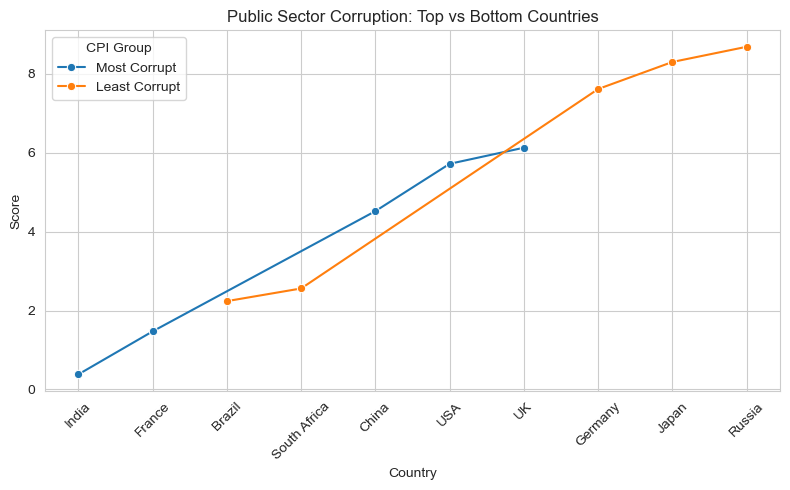

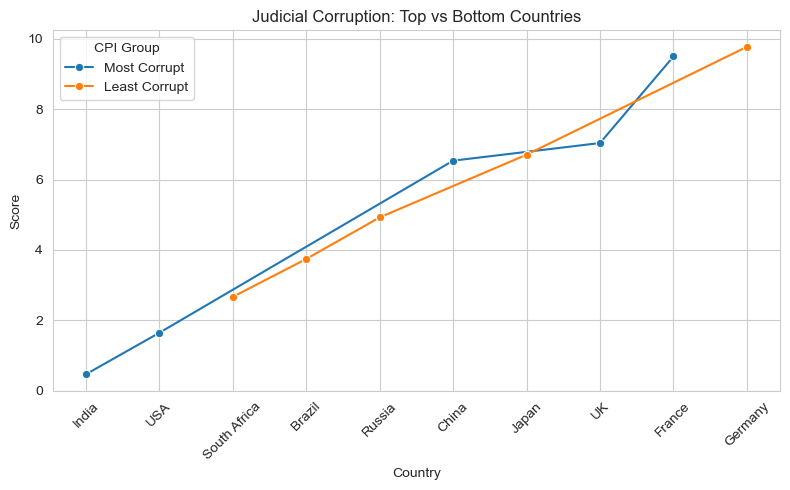

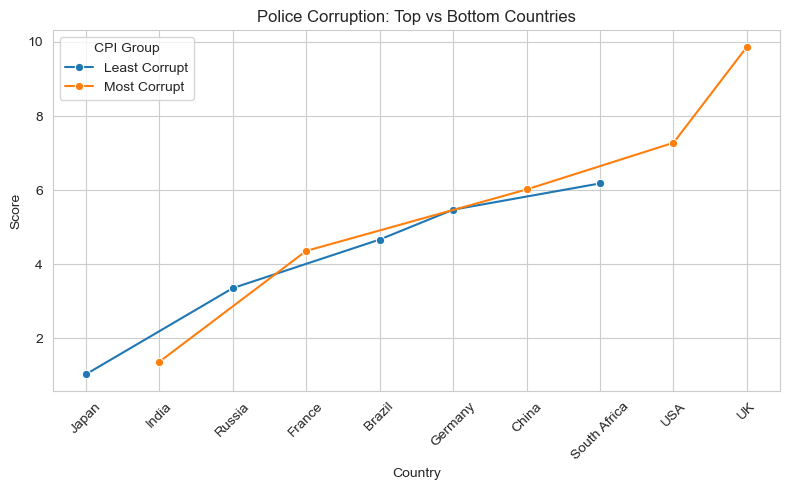

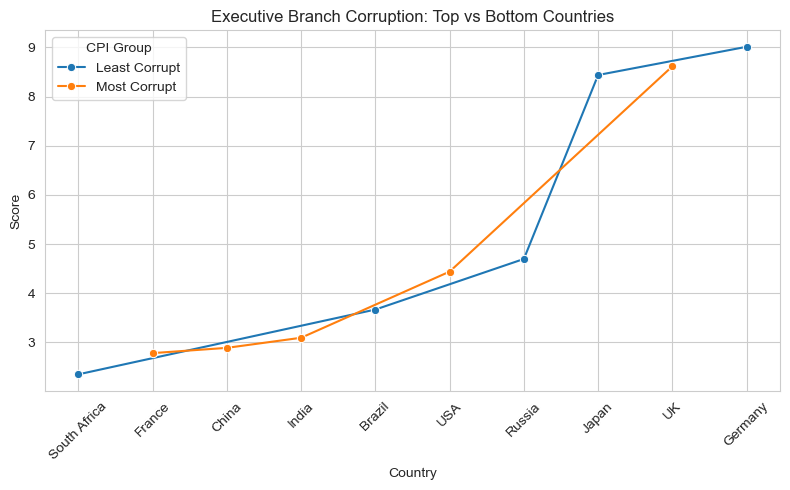

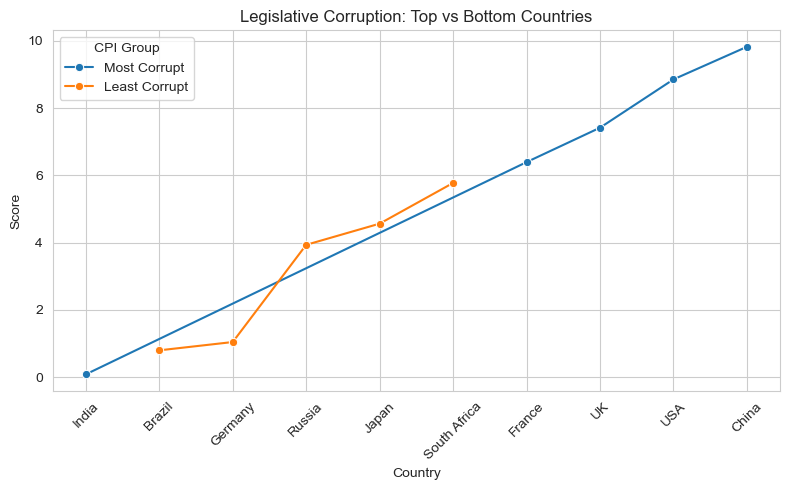

...

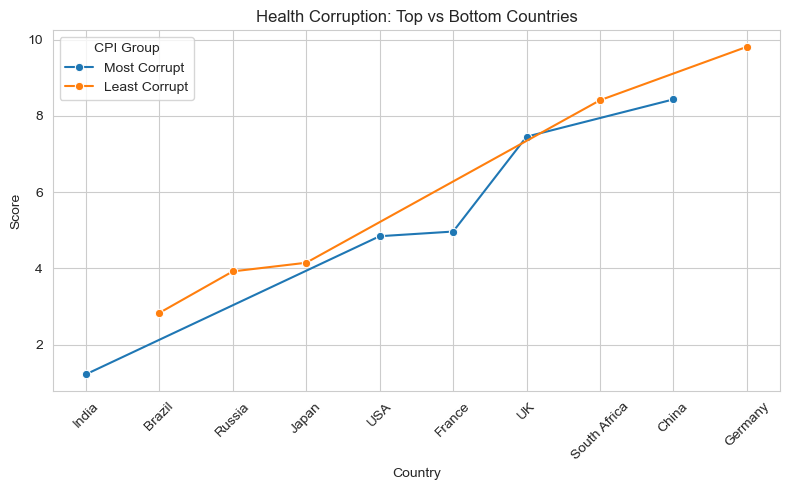

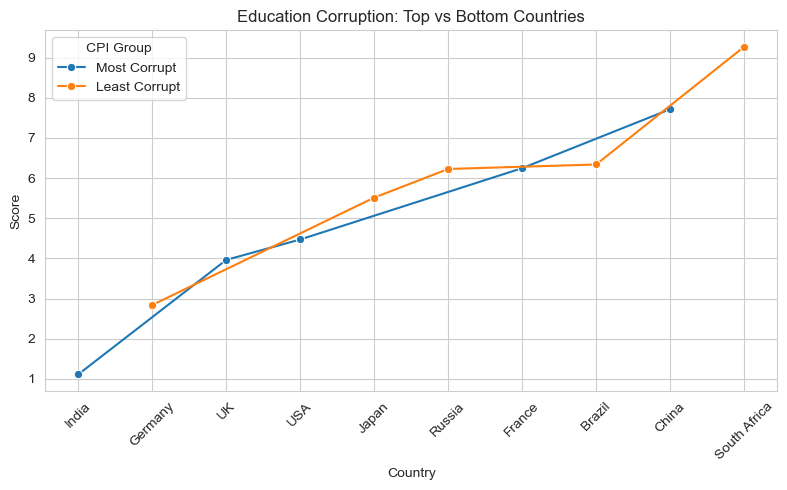

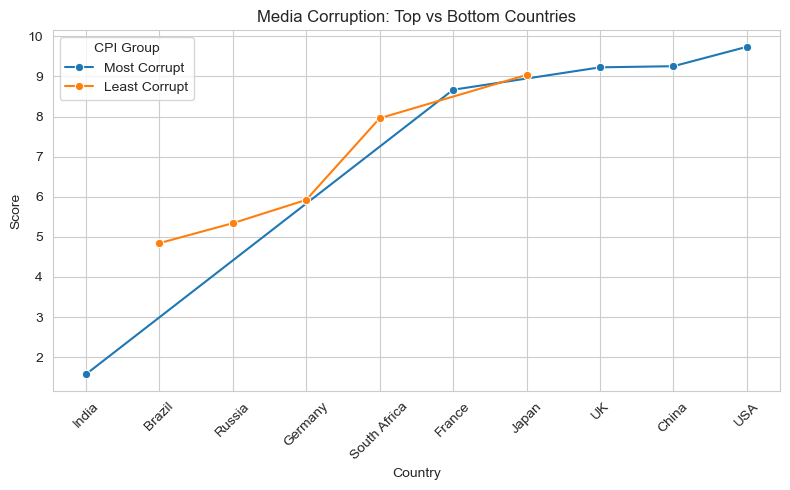

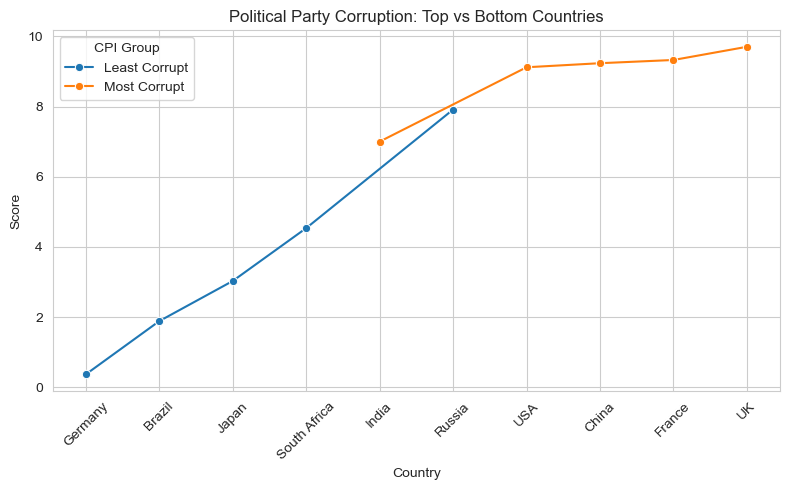

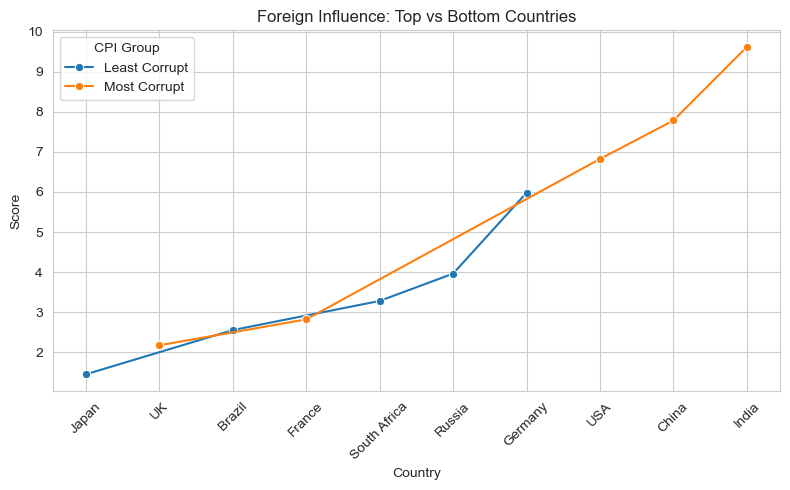

In [398]:
for metric in core_corruption_metrics:
    plt.figure(figsize=(8, 5))
    sns.lineplot(data=plot_data.sort_values(by=metric), x='Country', y=metric, hue='Type', marker='o')
    plt.xticks(rotation=45)
    plt.title(f"{metric.replace('_', ' ')}: Top vs Bottom Countries")
    plt.ylabel("Score")
    plt.xlabel("Country")
    plt.legend(title="CPI Group")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# 🧩 A2. What is the distribution of CPI_Score and Rank globally?


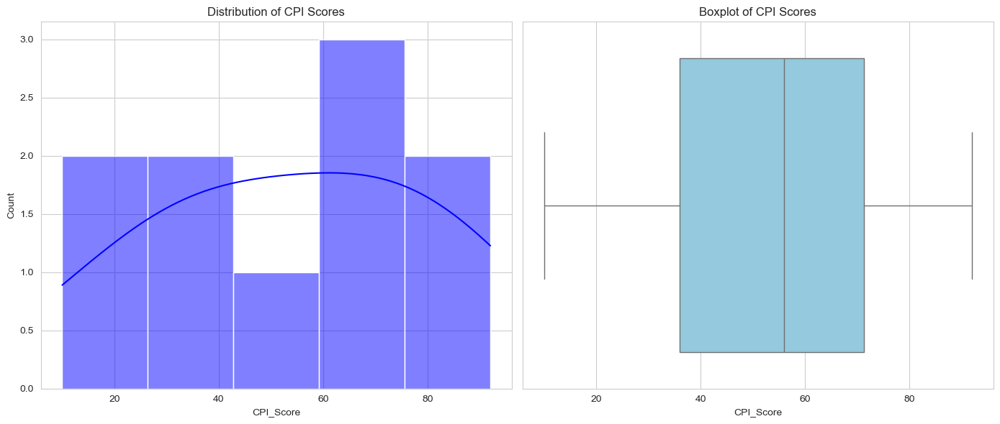

In [400]:
# Histogram + Boxplot
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

sns.histplot(df_latest['CPI_Score'], ax=axes[0], kde=True, color='blue')
axes[0].set_title("Distribution of CPI Scores")

sns.boxplot(x=df_latest['CPI_Score'], ax=axes[1], color='skyblue')
axes[1].set_title("Boxplot of CPI Scores")

plt.tight_layout()
plt.show()